# Convolution Block Attention Module (CBAM)

This notebook showcases an implementation of the CBAM module using PyTorch + PyTorch Lightning Framework. This network is inspired from the paper : https://arxiv.org/pdf/1807.06521.pdf.

The notebook is designed to be as simple as possible. The optional part of this notebook is the ONNX part which can be neglected if not required.

## Dataset:

For this notebook the following Kaggle Dataset was downloaded and used : https://www.kaggle.com/datasets/l3llff/flowers.

Please feel free to upvote this notebook if you find it useful. 

Have a nice day 😃!

/home/darth/miniconda3/envs/mlenv/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Global seed set to 42


Notebook color scheme


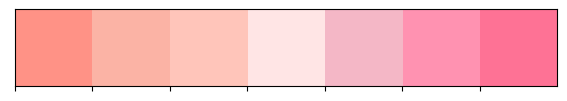

In [1]:
from typing import Any, Dict, List, Tuple, Union, Optional

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import wandb
import pretrainedmodels
import torch
import torch.nn as nn
import torch.utils.data as td
import torch.nn.functional as F
import albumentations
import torchmetrics
import torchvision
import onnxruntime
import onnx
import pytorch_lightning as pl
import os
import sys
import gc
import warnings

from sklearn.metrics import classification_report, accuracy_score, auc, f1_score, precision_score, recall_score
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, StratifiedKFold
from scipy.stats import sem
from PIL import Image, ImageFile

from IPython.display import display_markdown, display_latex
from tqdm import tqdm
from colorama import Fore, Style
from collections import defaultdict
from matplotlib.colors import ListedColormap

WANDB_CONFIG = {"experiment":"FlowerCategorization", "_wandb_kernel":"aot"}

warnings.filterwarnings('ignore')
pl.seed_everything(42)

class clr:
    S = Style.BRIGHT + Fore.RED
    E = Style.RESET_ALL
    
MY_COLORS = ["#ff9286", "#fbb3a5", "#ffc5ba", "#ffe5e5", "#f4b7c6", "#ff92b1", "#fe7295"]
print(clr.S+"Notebook color scheme"+clr.E)
sns.palplot(sns.color_palette(MY_COLORS))
plt.show()

In [2]:
wandb_api_key = os.environ["WANDB_KEY"]
!wandb login $wandb_api_key

wandb: Appending key for api.wandb.ai to your netrc file: /home/darth/.netrc


# Building MetaData

In [3]:
run = wandb.init(project="FlowerRecognition", name="meta_data", config=WANDB_CONFIG)

wandb: Currently logged in as: lmorningstar. Use `wandb login --relogin` to force relogin


In [4]:
root_data_path = "./data/flowers/"

meta = defaultdict(lambda : list())

for categories in os.listdir(root_data_path):
    for img_files in os.listdir(os.path.join(root_data_path, categories)):
        meta["img_path"].append(os.path.join(root_data_path, categories, img_files))
        meta["label"].append(categories)
        
meta_df = pd.DataFrame(meta)
meta_df.head()

,img_path,label
0,./data/flowers/astilbe/10091895024_a2ea04cda6_...,astilbe
1,./data/flowers/astilbe/1033455028_f0c6518ec9_c...,astilbe
2,./data/flowers/astilbe/10373087134_927b53fb9f_...,astilbe
3,./data/flowers/astilbe/1052212431_4963309d03_c...,astilbe
4,./data/flowers/astilbe/1052219251_d03970e956_c...,astilbe


In [5]:
artifact = wandb.Artifact('metaData', 'dataset')
table = wandb.Table(columns=meta_df.columns.tolist(), data=meta_df.values.tolist())
artifact.add(table, "metaData")
run.log_artifact(artifact)

In [6]:
wandb.finish()

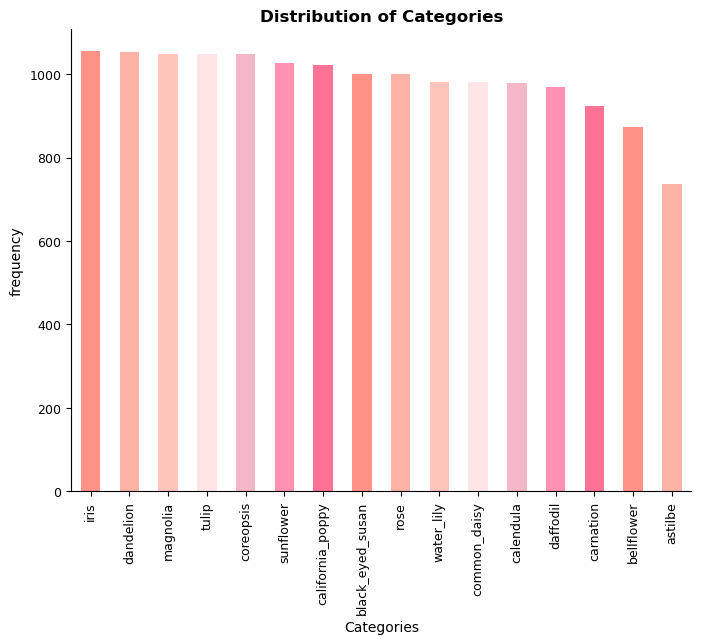

In [7]:
ax = meta_df["label"].value_counts().plot(kind="bar", 
                                          color=MY_COLORS, figsize=(8, 6), fontsize=9)

ax.set_title("Distribution of Categories", fontsize=12, weight="bold")
ax.set_xlabel("Categories", fontsize=10)
ax.set_ylabel("frequency", fontsize=10)

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
plt.show()

In [8]:
run = wandb.init(project="FlowerRecognition", name="target_distribution", config=WANDB_CONFIG)

In [9]:
run.log({'target_dist':wandb.Image(ax)})
wandb.finish()

In [10]:
def view_sample_imgs(data:pd.DataFrame, target:str, sample_sz:Optional[int]=5):
    """
    This function is used to view sample images from the dataset.
    
    :param data: the data from which to view the images.
    :param target: the specific category whose images needs to be viewed.
    :param sample_sz: the number of samples to view, e.g. 5
    
    :returns: None
    """
    
    data = data.loc[data["label"] == target].sample(sample_sz, random_state=1234)
    
    fig, axs = plt.subplots(1, sample_sz, figsize=(24, 12))
    axs = axs.flatten()
    
    wandb_imgs = list()
    
    for i, img_file in enumerate(data["img_path"].tolist()):
        img = Image.open(img_file)
        wandb_imgs.append(wandb.Image(img))
        
        axs[i].set_title(f"{target}-{i+1}", weight="bold", fontsize=12)
        axs[i].imshow(img)
        axs[i].axis('off')
    
    plt.tight_layout()
    wandb.log({target:wandb_imgs})
    plt.show()

In [11]:
run = wandb.init(project="FlowerRecognition", name="sample_images", config=WANDB_CONFIG)

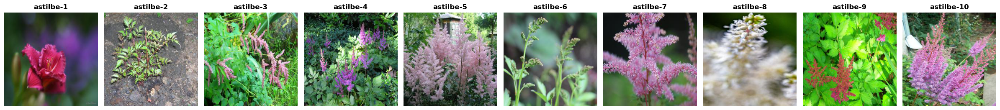

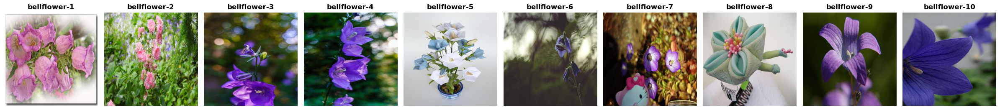

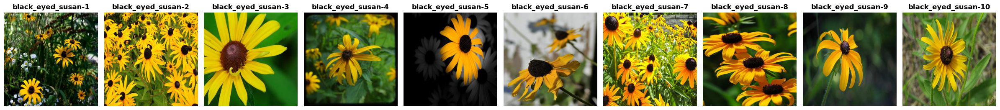

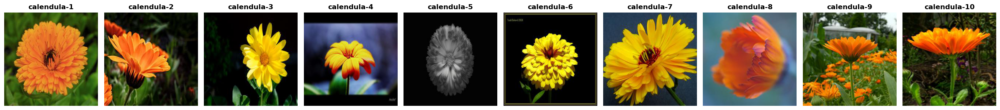

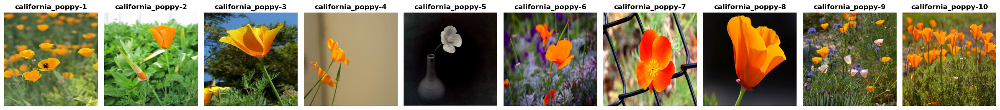

...

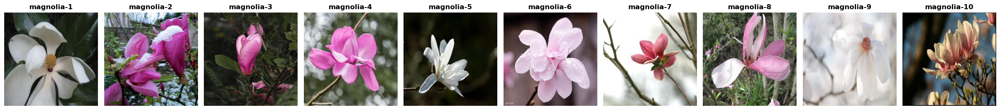

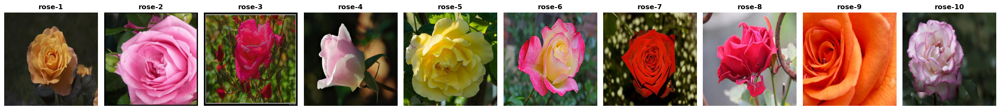

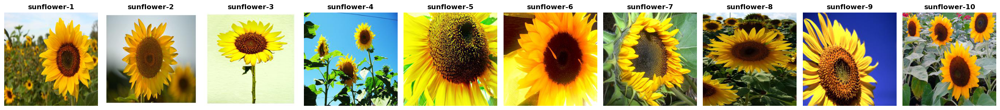

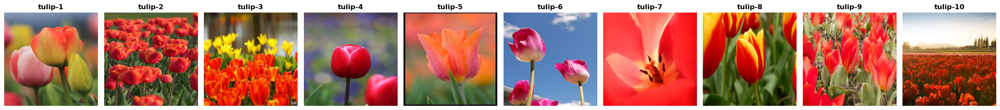

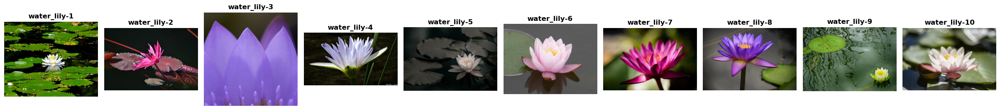

In [12]:
for target in meta_df["label"].unique():
    view_sample_imgs(meta_df, target, sample_sz=10)

In [13]:
wandb.finish()

# Data Generator

In [14]:
class FlowerDataset(td.Dataset):
    def __init__(self, img_paths:List, labels:List=None, resize:Tuple=None, augmentations:albumentations.Compose=None):
        
        """
        :param img_paths: the list of image path in the meta data.
        :param labels: the list of corresponding labels for the images.
        :param resize: the amount to the images to, e.g. (224, 224)
        :param augmentations: the augmentations to be applied to the images.
        """
        
        self.img_paths = img_paths
        self.labels = labels
        self.resize = resize
        self.augmentations = augmentations
    
    def __len__(self):
        return len(self.img_paths)
    
    def __getitem__(self, idx):
        
        img = Image.open(self.img_paths[idx])
        img = img.convert('RGB')
        label = None
        
        if self.labels is not None:
            label = self.labels[idx]
            
        if self.resize is not None:
            img = img.resize(
                (self.resize[1], self.resize[0]),
                resample=Image.Resampling.BILINEAR)
        
        img = np.array(img)
        
        if self.augmentations is not None:
            aug = self.augmentations(image=img)
            img = aug["image"]
        
        # As Pytorch expects CHW instead of HWC
        img = np.transpose(img, (2, 0, 1)).astype(np.float32)
        
        return {
            "img" : torch.tensor(img, dtype=torch.float),
            "label" : torch.tensor(label, dtype=torch.long) if label is not None else None
        }

In [15]:
class FlowerDataLoader(pl.LightningDataModule):
    def __init__(self, img_paths:List, labels:Optional[List]=None, resize:Tuple=None, 
                 augmentations:albumentations.Compose=None, batch_sz:Optional[int]=64, 
                 num_workers:Optional[int]=4, pin_memory:Optional[bool]=True, shuffle:Optional[bool]=True):
        
        self.img_paths = img_paths
        self.labels = labels
        self.resize = resize
        self.augmentations = augmentations
        self.batch_sz = batch_sz
        self.num_workers = num_workers
        self.pin_memory = pin_memory
        self.shuffle = shuffle
        
        self.train = None
        self.val = None
        self.test = None
        
    def setup(self, stage:Optional[str]="train"):
        
        if stage not in ["train", "val", "test"]:
            raise Exception(f"Expected stage to be either train/val/test. Found {stage}")
            
        if stage == "train":
            self.train = FlowerDataset(img_paths=self.img_paths, labels=self.labels, resize=self.resize, augmentations=self.augmentations)
        
        elif stage == "val":
            self.val = FlowerDataset(img_paths = self.img_paths, labels = self.labels, resize=self.resize, augmentations=self.augmentations)
            
        else:
            self.test = FlowerDataset(img_paths = self.img_paths, labels = self.labels, resize=self.resize, augmentations=self.augmentations)
            
    def train_dataloader(self):
        return td.DataLoader(self.train, batch_size=self.batch_sz, shuffle=self.shuffle, 
                             num_workers=self.num_workers, pin_memory=self.pin_memory)
    
    def val_dataloader(self):
        return td.DataLoader(self.val, batch_size=self.batch_sz, shuffle=self.shuffle, 
                             num_workers=self.num_workers, pin_memory=self.pin_memory)
    
    def test_dataloader(self):
        return td.DataLoader(self.test, batch_size=self.batch_sz, shuffle=self.shuffle, 
                             num_workers=self.num_workers, pin_memory=self.pin_memory)

# Model

This model is an application of the CBAM architecture described by Woo et. al. on a VGG-19 Network. 

The paper link for the CBAM architecture is : https://arxiv.org/pdf/1807.06521.pdf

## - Channel Attention

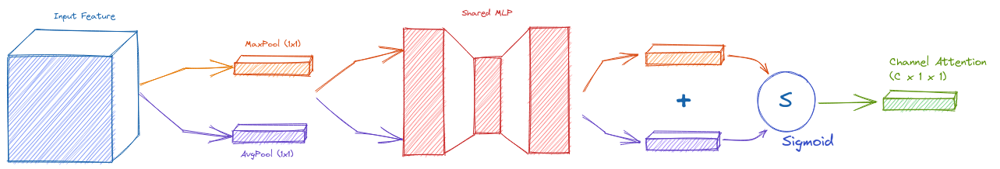


In [66]:
class ChannelAttention(nn.Module):
    def __init__(self, n_channels:int, ratio:Optional[int]=16):
        
        super().__init__()
        
        self.n_channels = n_channels
        self.ratio = ratio
        
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        
        self.flatten = nn.Flatten()
        
        self.shared_mlp = nn.Sequential(
            nn.Linear(n_channels, n_channels//ratio),
            nn.SiLU(),
            nn.Linear(n_channels//ratio, n_channels)
        )
        
        
    def forward(self, x):
        max_pool_x = self.max_pool(x)
        avg_pool_x = self.avg_pool(x)
        
        flatten_max = self.flatten(max_pool_x)
        flatten_avg = self.flatten(avg_pool_x)
        
        max_res = self.shared_mlp(flatten_max)
        avg_res = self.shared_mlp(flatten_avg)
        
        sum_res = max_res + avg_res
        out = F.sigmoid(sum_res)
        
        # Need to convert (batch_sz, n_channels) to (batch_sz, n_channels, 1, 1)
        out = out.unsqueeze(-1).unsqueeze(-1)
        
        return out        

## -Spatial Attention

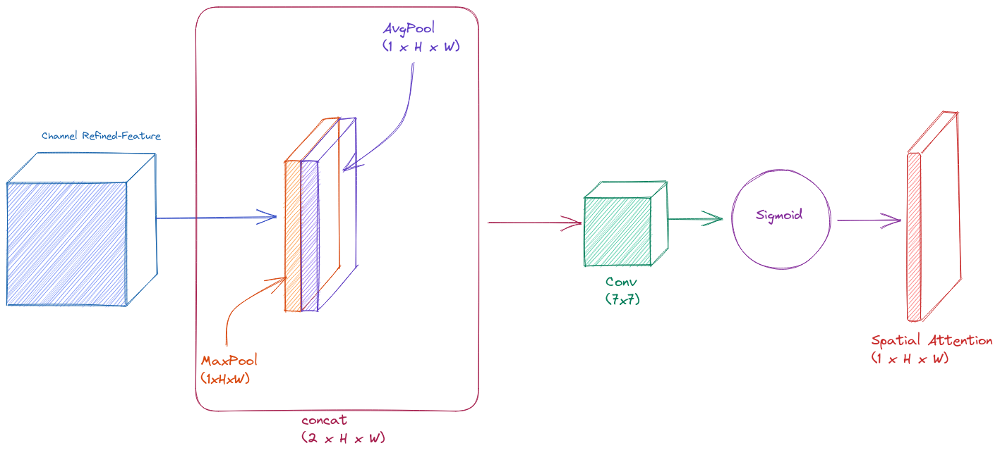

In [67]:
class SpatialAttention(nn.Module):
    
    def __init__(self, kernel_sz:Optional[int]=7):
        
        super().__init__()
        
        self.conv = nn.Conv2d(2, 1, kernel_size=kernel_sz, stride=1, padding=3)
        
    def forward(self, x):
        
        # To obtain a feature map of (batch_sz, 1, h, w) we need to use torch.max(x, dim=1, keepdim=True) and torch.mean(x, dim=1, keepdim=True)
        # instead of nn.MaxPool2d() or nn.AdaptiveMaxPool2d() because these functions applies the maxpooling/avgpooling spatial-wise and not channel-wise
        max_pool, _ = torch.max(x, dim=1, keepdim=True)
        avg_pool = torch.mean(x, dim=1, keepdim=True)
        
        
        concat_feats = torch.concat([max_pool, avg_pool], dim=1)
        conv_out = self.conv(concat_feats)
        
        return F.sigmoid(conv_out)

## - CBAM

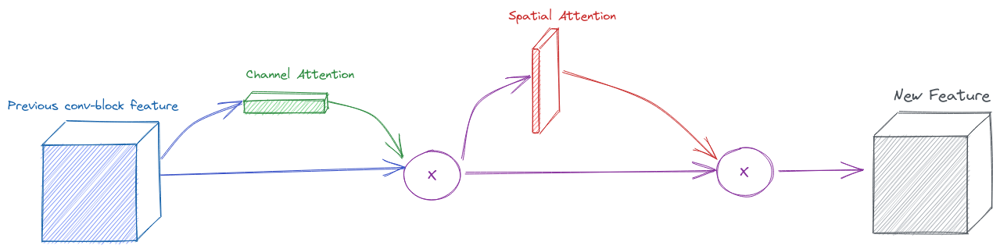

In [68]:
class CBAM(nn.Module):
    def __init__(self, n_channels:int, ratio:Optional[int]=16, kernel_sz:Optional[int]=7):
        
        super().__init__()
        
        self.channel_attn = ChannelAttention(n_channels, ratio=ratio)
        self.spatial_attn = SpatialAttention(kernel_sz=kernel_sz)
        
    def forward(self, x):
        channel_attn = self.channel_attn(x)
        x_1 = x * channel_attn
        
        spatial_attn = self.spatial_attn(x_1)
        new_feat = x_1 * spatial_attn
        
        return new_feat

## - Transfer Learing

In [69]:
"""
Dummy code : PLEASE IGNORE
"""

# torchvision.models.resnet34(weights=torchvision.models.ResNet34_Weights)

# for layer in torchvision.models.resnet34(weights=torchvision.models.ResNet34_Weights).layer1:
#     print(layer.bn2.num_features)
    
# sample_res_model = torchvision.models.resnet34(weights=torchvision.models.ResNet34_Weights)
# layers = [sample_res_model.layer1, sample_res_model.layer2, sample_res_model.layer3, sample_res_model.layer4]
# for layer in layers:
#     for block in layer:
#         block.add_module("cbam", CBAM(block.bn2.num_features))

# sample_res_model.fc = nn.LazyLinear(128)
# sample_res_model

# torchvision.models.resnet101(pretrained=True)

'\nDummy code : PLEASE IGNORE\n'

## Resnet with CBAM

The integration of the CBAM module into the resnet model is as follows:
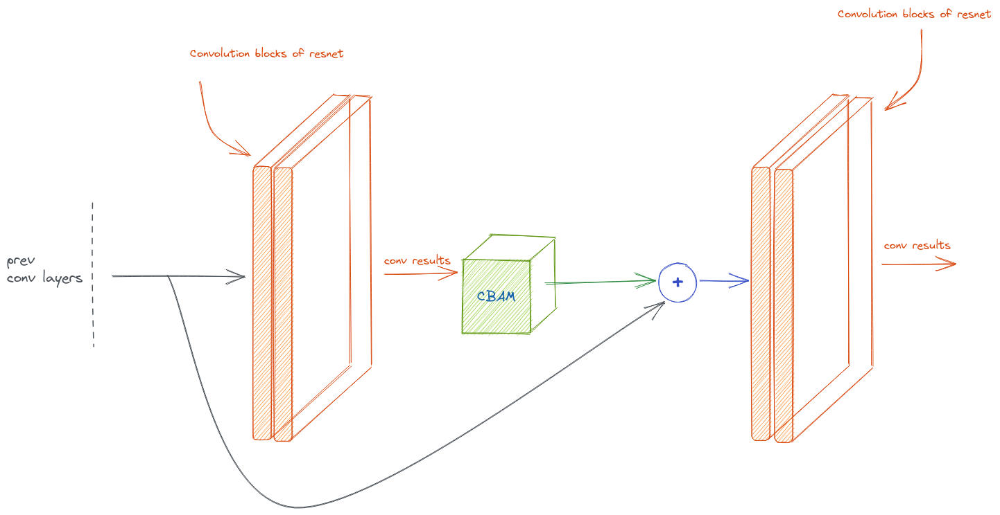

> This technique can be applied to any other computer vision models.

In [70]:
class ResNetCBAM(pl.LightningModule):
    def __init__(self, model_class:str, n_classes:int, drop:Optional[float]=.25, reduction_ratio:Optional[int]=16, 
                 spatial_attn_kernel_sz:Optional[int]=7, wandb_log:Optional[wandb.Api]=None, apply_attn:Optional[bool]=True):
        
        super().__init__()
        
        if model_class not in ["resnet18", "resnet34", "resnet50", "resnet101", "resnet152"]:
            raise Exception(f"Expected model_class to be either of resnet18/resnet34/resnet50/resnet101/resnet152. Found {model_class}")
        
        self.n_classes = n_classes
        self.drop = drop
        self.reduction_ratio = reduction_ratio
        self.spatial_attn_kernel_sz = spatial_attn_kernel_sz
        self.wandb_log = wandb_log
        
        self.base_model = None
        
        if model_class == "resnet18":
            self.base_model = torchvision.models.resnet18(weights=torchvision.models.ResNet18_Weights.IMAGENET1K_V1)
        elif model_class == "resnet34":
            self.base_model = torchvision.models.resnet34(weights=torchvision.models.ResNet34_Weights.IMAGENET1K_V1)
        elif model_class == "resnet50":
            self.base_model = torchvision.models.resnet50(weights=torchvision.models.ResNet50_Weights.IMAGENET1K_V2)
        elif model_class == "resnet101":
            self.base_model = torchvision.models.resnet101(weights=torchvision.models.ResNet101_Weights.IMAGENET1K_V2)
        else:
            self.base_model = torchvision.models.resnet152(weights=torchvision.models.ResNet152_Weights.IMAGENET1K_V2)
        
        
        layers = [self.base_model.layer1, self.base_model.layer2, self.base_model.layer3, self.base_model.layer4]
        
        if apply_attn:
            
            # Adding the CBAM (Convolution Block Attention Mechanism)
            for layer in layers:
                for block in layer:
                    block.add_module("cbam", CBAM(block.bn2.num_features))
        
        
        classifier = nn.LazyLinear(n_classes)
        
        self.base_model.fc = classifier
    
    def forward(self, x:torch.Tensor):
        out = self.base_model(x)
        return out
    
    def compute_loss(self, y_true:torch.Tensor, y_pred:torch.Tensor):
        """
        This function is used to compute loss.
        
        :param y_true: the true labels.
        :param y_pred: the predicted labels
        
        :returns: the cross-entropy loss
        """
        
        return F.cross_entropy(y_pred, y_true)
    
    def compute_metrics(self, y_true:torch.Tensor, y_pred:torch.Tensor):
        """
        This function is used to calculate all kinds of metrics for the model.
        
        :param y_true: the true labels.
        :param y_pred: the predicted labels.
        
        :returns: the metrics
        """
        
        y_true = y_true.detach().cpu().numpy()
        
        y_pred = torch.argmax(y_pred, dim=1)
        y_pred = y_pred.detach().cpu().numpy()
        
        acc = accuracy_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred, average='weighted')
        precision = precision_score(y_true, y_pred, average='weighted')
        recall = recall_score(y_true, y_pred, average='weighted')
        
        return acc, f1, precision, recall
    
    def training_step(self, batch:torch.Tensor, batch_idx:torch.Tensor):
        
        x, y = batch["img"], batch["label"]
        logits = self(x)
        
        loss = self.compute_loss(y, logits)
        
        self.log("train_loss", loss.item(), logger=True, on_step=False, on_epoch=True, prog_bar=True)
        
        return {
            "loss" : loss,
            "y" : y,
            "yhat" : logits,
            "yhat_softmax" : F.softmax(logits, dim=1)
        }
    
    def validation_step(self, batch:torch.Tensor, batch_idx:torch.Tensor):
        
        x, y = batch["img"], batch["label"]
        logits = self(x)
        
        loss = self.compute_loss(y, logits)
        
        self.log("val_loss", loss.item(), logger=True, on_step=False, on_epoch=True, prog_bar=True)
        
        return {
            "val_loss" : loss,
            "y" : y,
            "yhat" : logits,
            "yhat_softmax" : F.softmax(logits, dim=1)
        }
    
    def test_step(self, batch:torch.Tensor, batch_idx:torch.Tensor):
        
        x, y = batch["img"], batch["label"]
        logits = self(x)
        
        loss = self.compute_loss(y, logits)
        
        self.log("test_loss", loss.item(), logger=True, on_step=False, on_epoch=True)
        
        return {
            "test_loss" : loss,
            "y" : y,
            "yhat" : logits,
            "yhat_softmax" : F.softmax(logits, dim=1)
        }    
    
    
    def training_epoch_end(self, res):
        
        y = list()
        yhat = list()
        
        for d in res:
            y.append(d["y"])
            yhat.append(d["yhat"])
            
        y = torch.concat(y)
        yhat = torch.concat(yhat)
        
        loss = self.compute_loss(y, yhat)
        acc, f1, prec, rec = self.compute_metrics(y, yhat)
        
        self.log("train_f1_score", f1, logger=True, on_step=False, on_epoch=True, prog_bar=True)
        
        if self.wandb_log is not None:
            self.wandb_log.log({"train/loss":loss.item()})
            self.wandb_log.log({"train/accuracy":acc})
            self.wandb_log.log({"train/f1-score":f1})
            self.wandb_log.log({"train/precision":prec})
            self.wandb_log.log({"train/recall":rec})
            
        
    
    def validation_epoch_end(self, res):
        
        y = list()
        yhat = list()
        
        for d in res:
            y.append(d["y"])
            yhat.append(d["yhat"])
            
        y = torch.concat(y)
        yhat = torch.concat(yhat)
        
        loss = self.compute_loss(y, yhat)
        acc, f1, prec, rec = self.compute_metrics(y, yhat)
        
        self.log("val_f1_score", f1, logger=True, on_step=False, on_epoch=True, prog_bar=True)
        
        if self.wandb_log is not None:
            self.wandb_log.log({"val/loss":loss.item()})
            self.wandb_log.log({"val/accuracy":acc})
            self.wandb_log.log({"val/f1-score":f1})
            self.wandb_log.log({"val/precision":prec})
            self.wandb_log.log({"val/recall":rec})        
            
    
    def test_epoch_end(self, res):
        
        
        y = list()
        yhat = list()
        
        for d in res:
            y.append(d["y"])
            yhat.append(d["yhat"])
            
        y = torch.concat(y)
        yhat = torch.concat(yhat)
        
        loss = self.compute_loss(y, yhat)
        acc, f1, prec, rec = self.compute_metrics(y, yhat)
        
        self.log("test_acc_score", acc, logger=True, on_epoch=True, on_step=False)
        self.log("test_f1_score", f1, logger=True, on_epoch=True, on_step=False)
        self.log("test_prec_score", prec, logger=True, on_epoch=True, on_step=False)
        self.log("test_recall_score", rec, logger=True, on_epoch=True, on_step=False)
        
        
        return {
            "test_acc_score" : acc,
            "test_f1_score" : f1,
            "test_prec_score" : prec,
            "test_recall_score" : rec
        }
    
    def configure_optimizers(self):
        optimizer = torch.optim.AdamW(self.parameters(), lr=1e-3, weight_decay=1e-6)
        scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, 100, eta_min=1e-5)
        
        return {
            "optimizer" : optimizer,
            "scheduler" : scheduler
        }
            

# Data Splitting

In [21]:
N_CLASSES = meta_df["label"].nunique()
print(clr.S+"Number of classes : "+clr.E+str(N_CLASSES))

Number of classes : 16


In [22]:
LABELS = {k:idx for idx, k in enumerate(meta_df["label"].unique().tolist())}
LABELS['unknown'] = N_CLASSES + 1
meta_df["label_num"] = meta_df["label"].map(LABELS)
LABELS

{'astilbe': 0,
 'bellflower': 1,
 'black_eyed_susan': 2,
 'calendula': 3,
 'california_poppy': 4,
 'carnation': 5,
 'common_daisy': 6,
 'coreopsis': 7,
 'daffodil': 8,
 'dandelion': 9,
 'iris': 10,
 'magnolia': 11,
 'rose': 12,
 'sunflower': 13,
 'tulip': 14,
 'water_lily': 15,
 'unknown': 17}

In [23]:
print(clr.S+"==== Original Data Information ===="+clr.E)

display_markdown(f"Number of records in the original data : ${meta_df.shape[0]}$", raw=True)

meta_df_train, meta_df_test = train_test_split(meta_df, test_size=.1, shuffle=True, random_state=32, stratify=meta_df["label"])

print(clr.S+"==== Data Split information ===="+clr.E)
display_markdown(f"Number of records in the training data : ${meta_df_train.shape[0]}$", raw=True)
display_markdown(f"Number of records in the test data : ${meta_df_test.shape[0]}$", raw=True)

==== Original Data Information ====


Number of records in the original data : $15740$

==== Data Split information ====


Number of records in the training data : $14166$

Number of records in the test data : $1574$

In [24]:
train_augmentations = albumentations.Compose([
    albumentations.RandomBrightness(),
    albumentations.RandomContrast(),
    albumentations.RandomBrightnessContrast(),
    albumentations.RandomRain(),
    albumentations.RandomFog(),
    albumentations.RandomSnow(),
    albumentations.RandomSunFlare(),
    albumentations.RGBShift(),
    albumentations.Rotate(),
    albumentations.CenterCrop(224, 224, always_apply=True),
    albumentations.Normalize(always_apply=True)
])

val_test_augmentations = albumentations.Compose([
    albumentations.CenterCrop(224, 224, always_apply=True),
    albumentations.Normalize(always_apply=True)
])





def model_cross_validate(data:pd.DataFrame, model_class:pl.LightningModule, model_type:str, n_reps:Optional[int]=10, n_splits:Optional[int]=3, 
                n_epochs:Optional[int]=500, early_patience_steps:Optional[int]=5, resize:Optional[int]=256, apply_attn:Optional[bool]=True) -> List:
    """
    This function cross-validates the model using the data provided.
    
    :param data: the data to be cross-validated using.
    :param model_class: the model to be cross-validated.
    :param model_type: which model to train on.
    :param n_reps: the number of repetetions to cross-validate.
    :param n_splits: the number of k-folds for cross-validation.
    :param n_epochs: the maximum number of epochs to train the model.
    :param early_patience_steps: the maximum number of steps to wait before early stopping.
    :param resize: value by which to resize the image. e.g. 256
    
    :returns: the model score.
    """
    
    scores = list()
    kfold = None
    
    if n_reps <= 0:
        raise Exception("Excpected n_reps to be atleast 1.")
        
    if n_reps == 1:
        kfold = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    else:
        kfold = RepeatedStratifiedKFold(n_repeats=n_reps, n_splits=n_splits, random_state=32)
        
    
    for fold, (train_idx, val_idx) in enumerate(kfold.split(data["img_path"].tolist(), data["label_num"].tolist())):
        
        model_dir = "resnet-50" if not apply_attn else "resnet-50_cbam"
        chkpt_dir = os.path.join("models",model_dir,str(fold+1))
        
        if not os.path.exists(chkpt_dir):
            os.mkdir(chkpt_dir)
        
        torch.cuda.empty_cache()
        
        if apply_attn:
            run = wandb.init(project="FlowerRecognition", name=f"{model_type}_cbam_model_metrics_fold-{fold+1}", config=WANDB_CONFIG)
        else:
            run = wandb.init(project="FlowerRecognition", name=f"{model_type}_model_metrics_fold-{fold+1}", config=WANDB_CONFIG)
        
        train, val = data.iloc[train_idx], data.iloc[val_idx]
        
        train_dm = FlowerDataLoader(train["img_path"].tolist(), labels=train["label_num"].tolist(), resize=(resize, resize), augmentations=train_augmentations)
        val_dm = FlowerDataLoader(val["img_path"].tolist(), labels=val["label_num"].tolist(), resize=(resize, resize), augmentations=val_test_augmentations, 
                                 batch_sz=256, shuffle=False)
        
        train_dm.setup(stage="train")
        val_dm.setup(stage="val")
        
        train_dl = train_dm.train_dataloader()
        val_dl = val_dm.val_dataloader()
        
        model = model_class(model_type, N_CLASSES+1, wandb_log=run, apply_attn=apply_attn)
        
        early_stop = pl.callbacks.EarlyStopping(monitor="val_f1_score", 
                                                mode="max", patience=early_patience_steps, verbose=True)
        
        
        
        checkpoint = pl.callbacks.ModelCheckpoint(dirpath=chkpt_dir, 
                                                  monitor="val_f1_score", mode="max", verbose=True)
        trainer = pl.Trainer(devices=1, 
                             accelerator="gpu", 
                             callbacks=[early_stop, checkpoint], 
                             max_epochs=n_epochs, 
                             gradient_clip_val=2, 
                             precision=16)
        
        trainer.fit(model, train_dataloaders=train_dl, val_dataloaders=val_dl)
        val_res = trainer.test(model, dataloaders=val_dl, ckpt_path="best")
        scores.append(val_res[0]["test_f1_score"])
        
        gc.collect()
    
    wandb.finish()
    
    return scores

In [27]:
cross_val_score_res50_baseline = model_cross_validate(meta_df_train, ResNetCBAM, "resnet50", n_reps=1, n_splits=5, apply_attn=False)

Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|██████████████████████████████████████████▏  | 178/190 [00:35<00:02,  4.99it/s, loss=1.2, v_num=124]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|█████████| 190/190 [00:38<00:00,  4.90it/s, loss=1.2, v_num=124, val_loss=0.585, val_f1_score=0.812]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.812


Epoch 0: 100%|█| 190/190 [00:38<00:00,  4.90it/s, loss=1.2, v_num=124, val_loss=0.585, val_f1_score=0.812, train_l

Epoch 0, global step 178: 'val_f1_score' reached 0.81197 (best 0.81197), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:35<00:02,  4.99it/s, loss=1, v_num=124, val_loss=0.585, val_f1_score=0.812, train_los
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:36<00:02,  4.89it/s, loss=1, v_num=124, val_loss=0.585, val_f1_score=0.812, train_los
Epoch 1:  95%|▉| 180/190 [00:36<00:02,  4.88it/s, loss=1, v_num=124, val_loss=0.585, val_f1_score=0.812, train_los
Epoch 1:  95%|▉| 181/190 [00:37<00:01,  4.88it/s, loss=1, v_num=124, val_loss=0.585, val_f1_score=0.812, train_los
Epoch 1:  96%|▉| 182/190 [00:37<00:01,  4.88it/s, loss=1, v_num=124, val_loss=0.585, val_f1_score=0.812, train_los
Epoch 1:  96%|▉| 183/190 [00:37<00:01,  4.88it/s, loss=1, v_num=124, val_loss=0.585, val_f1_score=0.812, train_los
Epoch 1:  97%|▉| 184/190 [00:37<00:01,  4.88it/s, loss=1, v_num=124, val_loss=0.585, val_f1_score=0.812, train_los
Epoch 1:  97%|▉| 185/190 [00:37<00:01,  4.88it/s,

Metric val_f1_score improved by 0.017 >= min_delta = 0.0. New best score: 0.829


Epoch 1: 100%|█| 190/190 [00:38<00:00,  4.89it/s, loss=1, v_num=124, val_loss=0.546, val_f1_score=0.829, train_los

Epoch 1, global step 356: 'val_f1_score' reached 0.82851 (best 0.82851), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.85, v_num=124, val_loss=0.546, val_f1_score=0.829, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.85, v_num=124, val_loss=0.546, val_f1_score=0.829, train_
Epoch 2:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.85, v_num=124, val_loss=0.546, val_f1_score=0.829, train_
Epoch 2:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.85, v_num=124, val_loss=0.546, val_f1_score=0.829, train_
Epoch 2:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.85, v_num=124, val_loss=0.546, val_f1_score=0.829, train_
Epoch 2:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.85, v_num=124, val_loss=0.546, val_f1_score=0.829, train_
Epoch 2:  97%|▉| 184/190 [00:36<00:01,  4.97it/s, loss=0.85, v_num=124, val_loss=0.546, val_f1_score=0.829, train_
Epoch 2:  97%|▉| 185/190 [00:37<00:01,  4.97it/s,

Metric val_f1_score improved by 0.011 >= min_delta = 0.0. New best score: 0.839


Epoch 2: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.85, v_num=124, val_loss=0.515, val_f1_score=0.839, train_

Epoch 2, global step 534: 'val_f1_score' reached 0.83942 (best 0.83942), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:35<00:02,  5.08it/s, loss=0.817, v_num=124, val_loss=0.515, val_f1_score=0.839, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:35<00:02,  4.98it/s, loss=0.817, v_num=124, val_loss=0.515, val_f1_score=0.839, train
Epoch 3:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.817, v_num=124, val_loss=0.515, val_f1_score=0.839, train
Epoch 3:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.817, v_num=124, val_loss=0.515, val_f1_score=0.839, train
Epoch 3:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.817, v_num=124, val_loss=0.515, val_f1_score=0.839, train
Epoch 3:  96%|▉| 183/190 [00:36<00:01,  4.97it/s, loss=0.817, v_num=124, val_loss=0.515, val_f1_score=0.839, train
Epoch 3:  97%|▉| 184/190 [00:37<00:01,  4.97it/s, loss=0.817, v_num=124, val_loss=0.515, val_f1_score=0.839, train
Epoch 3:  97%|▉| 185/190 [00:37<00:01,  4.97it/s,

Metric val_f1_score improved by 0.010 >= min_delta = 0.0. New best score: 0.849


Epoch 3: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.817, v_num=124, val_loss=0.476, val_f1_score=0.849, train

Epoch 3, global step 712: 'val_f1_score' reached 0.84930 (best 0.84930), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=3-step=712.ckpt' as top 1


Epoch 4:  94%|▉| 178/190 [00:35<00:02,  5.08it/s, loss=0.795, v_num=124, val_loss=0.476, val_f1_score=0.849, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.795, v_num=124, val_loss=0.476, val_f1_score=0.849, train
Epoch 4:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.795, v_num=124, val_loss=0.476, val_f1_score=0.849, train
Epoch 4:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.795, v_num=124, val_loss=0.476, val_f1_score=0.849, train
Epoch 4:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.795, v_num=124, val_loss=0.476, val_f1_score=0.849, train
Epoch 4:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.795, v_num=124, val_loss=0.476, val_f1_score=0.849, train
Epoch 4:  97%|▉| 184/190 [00:36<00:01,  4.98it/s, loss=0.795, v_num=124, val_loss=0.476, val_f1_score=0.849, train
Epoch 4:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.023 >= min_delta = 0.0. New best score: 0.873


Epoch 4: 100%|█| 190/190 [00:38<00:00,  4.99it/s, loss=0.795, v_num=124, val_loss=0.393, val_f1_score=0.873, train

Epoch 4, global step 890: 'val_f1_score' reached 0.87272 (best 0.87272), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=4-step=890.ckpt' as top 1


Epoch 5:  94%|▉| 178/190 [00:35<00:02,  5.09it/s, loss=0.715, v_num=124, val_loss=0.393, val_f1_score=0.873, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:35<00:02,  4.98it/s, loss=0.715, v_num=124, val_loss=0.393, val_f1_score=0.873, train
Epoch 5:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.715, v_num=124, val_loss=0.393, val_f1_score=0.873, train
Epoch 5:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.715, v_num=124, val_loss=0.393, val_f1_score=0.873, train
Epoch 5:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.715, v_num=124, val_loss=0.393, val_f1_score=0.873, train
Epoch 5:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.715, v_num=124, val_loss=0.393, val_f1_score=0.873, train
Epoch 5:  97%|▉| 184/190 [00:36<00:01,  4.97it/s, loss=0.715, v_num=124, val_loss=0.393, val_f1_score=0.873, train
Epoch 5:  97%|▉| 185/190 [00:37<00:01,  4.97it/s,

Metric val_f1_score improved by 0.011 >= min_delta = 0.0. New best score: 0.884


Epoch 5: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.715, v_num=124, val_loss=0.368, val_f1_score=0.884, train

Epoch 5, global step 1068: 'val_f1_score' reached 0.88394 (best 0.88394), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:35<00:02,  5.08it/s, loss=0.703, v_num=124, val_loss=0.368, val_f1_score=0.884, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:35<00:02,  4.98it/s, loss=0.703, v_num=124, val_loss=0.368, val_f1_score=0.884, train
Epoch 6:  95%|▉| 180/190 [00:36<00:02,  4.97it/s, loss=0.703, v_num=124, val_loss=0.368, val_f1_score=0.884, train
Epoch 6:  95%|▉| 181/190 [00:36<00:01,  4.97it/s, loss=0.703, v_num=124, val_loss=0.368, val_f1_score=0.884, train
Epoch 6:  96%|▉| 182/190 [00:36<00:01,  4.97it/s, loss=0.703, v_num=124, val_loss=0.368, val_f1_score=0.884, train
Epoch 6:  96%|▉| 183/190 [00:36<00:01,  4.97it/s, loss=0.703, v_num=124, val_loss=0.368, val_f1_score=0.884, train
Epoch 6:  97%|▉| 184/190 [00:37<00:01,  4.97it/s, loss=0.703, v_num=124, val_loss=0.368, val_f1_score=0.884, train
Epoch 6:  97%|▉| 185/190 [00:37<00:01,  4.97it/s,

Epoch 6, global step 1246: 'val_f1_score' was not in top 1


Epoch 7:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.576, v_num=124, val_loss=0.439, val_f1_score=0.864, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.576, v_num=124, val_loss=0.439, val_f1_score=0.864, train
Epoch 7:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.576, v_num=124, val_loss=0.439, val_f1_score=0.864, train
Epoch 7:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.576, v_num=124, val_loss=0.439, val_f1_score=0.864, train
Epoch 7:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.576, v_num=124, val_loss=0.439, val_f1_score=0.864, train
Epoch 7:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.576, v_num=124, val_loss=0.439, val_f1_score=0.864, train
Epoch 7:  97%|▉| 184/190 [00:36<00:01,  4.98it/s, loss=0.576, v_num=124, val_loss=0.439, val_f1_score=0.864, train
Epoch 7:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.016 >= min_delta = 0.0. New best score: 0.900


Epoch 7: 100%|█| 190/190 [00:38<00:00,  4.99it/s, loss=0.576, v_num=124, val_loss=0.323, val_f1_score=0.900, train

Epoch 7, global step 1424: 'val_f1_score' reached 0.90013 (best 0.90013), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=7-step=1424.ckpt' as top 1


Epoch 8:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.584, v_num=124, val_loss=0.323, val_f1_score=0.900, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:35<00:02,  4.98it/s, loss=0.584, v_num=124, val_loss=0.323, val_f1_score=0.900, train
Epoch 8:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.584, v_num=124, val_loss=0.323, val_f1_score=0.900, train
Epoch 8:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.584, v_num=124, val_loss=0.323, val_f1_score=0.900, train
Epoch 8:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.584, v_num=124, val_loss=0.323, val_f1_score=0.900, train
Epoch 8:  96%|▉| 183/190 [00:36<00:01,  4.97it/s, loss=0.584, v_num=124, val_loss=0.323, val_f1_score=0.900, train
Epoch 8:  97%|▉| 184/190 [00:37<00:01,  4.97it/s, loss=0.584, v_num=124, val_loss=0.323, val_f1_score=0.900, train
Epoch 8:  97%|▉| 185/190 [00:37<00:01,  4.97it/s,

Metric val_f1_score improved by 0.006 >= min_delta = 0.0. New best score: 0.906


Epoch 8: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.584, v_num=124, val_loss=0.307, val_f1_score=0.906, train

Epoch 8, global step 1602: 'val_f1_score' reached 0.90624 (best 0.90624), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=8-step=1602.ckpt' as top 1


Epoch 9:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.61, v_num=124, val_loss=0.307, val_f1_score=0.906, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.61, v_num=124, val_loss=0.307, val_f1_score=0.906, train_
Epoch 9:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.61, v_num=124, val_loss=0.307, val_f1_score=0.906, train_
Epoch 9:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.61, v_num=124, val_loss=0.307, val_f1_score=0.906, train_
Epoch 9:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.61, v_num=124, val_loss=0.307, val_f1_score=0.906, train_
Epoch 9:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.61, v_num=124, val_loss=0.307, val_f1_score=0.906, train_
Epoch 9:  97%|▉| 184/190 [00:36<00:01,  4.98it/s, loss=0.61, v_num=124, val_loss=0.307, val_f1_score=0.906, train_
Epoch 9:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.009 >= min_delta = 0.0. New best score: 0.915


Epoch 9: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.61, v_num=124, val_loss=0.257, val_f1_score=0.915, train_

Epoch 9, global step 1780: 'val_f1_score' reached 0.91477 (best 0.91477), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=9-step=1780.ckpt' as top 1


Epoch 10:  94%|▉| 178/190 [00:35<00:02,  5.08it/s, loss=0.575, v_num=124, val_loss=0.257, val_f1_score=0.915, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:35<00:02,  4.98it/s, loss=0.575, v_num=124, val_loss=0.257, val_f1_score=0.915, trai
Epoch 10:  95%|▉| 180/190 [00:36<00:02,  4.97it/s, loss=0.575, v_num=124, val_loss=0.257, val_f1_score=0.915, trai
Epoch 10:  95%|▉| 181/190 [00:36<00:01,  4.97it/s, loss=0.575, v_num=124, val_loss=0.257, val_f1_score=0.915, trai
Epoch 10:  96%|▉| 182/190 [00:36<00:01,  4.97it/s, loss=0.575, v_num=124, val_loss=0.257, val_f1_score=0.915, trai
Epoch 10:  96%|▉| 183/190 [00:36<00:01,  4.97it/s, loss=0.575, v_num=124, val_loss=0.257, val_f1_score=0.915, trai
Epoch 10:  97%|▉| 184/190 [00:37<00:01,  4.97it/s, loss=0.575, v_num=124, val_loss=0.257, val_f1_score=0.915, trai
Epoch 10:  97%|▉| 185/190 [00:37<00:01,  4.97it/s

Epoch 10, global step 1958: 'val_f1_score' was not in top 1


Epoch 11:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.557, v_num=124, val_loss=0.299, val_f1_score=0.903, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:35<00:02,  4.98it/s, loss=0.557, v_num=124, val_loss=0.299, val_f1_score=0.903, trai
Epoch 11:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.557, v_num=124, val_loss=0.299, val_f1_score=0.903, trai
Epoch 11:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.557, v_num=124, val_loss=0.299, val_f1_score=0.903, trai
Epoch 11:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.557, v_num=124, val_loss=0.299, val_f1_score=0.903, trai
Epoch 11:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.557, v_num=124, val_loss=0.299, val_f1_score=0.903, trai
Epoch 11:  97%|▉| 184/190 [00:36<00:01,  4.97it/s, loss=0.557, v_num=124, val_loss=0.299, val_f1_score=0.903, trai
Epoch 11:  97%|▉| 185/190 [00:37<00:01,  4.97it/s

Metric val_f1_score improved by 0.001 >= min_delta = 0.0. New best score: 0.916


Epoch 11: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.557, v_num=124, val_loss=0.260, val_f1_score=0.916, trai

Epoch 11, global step 2136: 'val_f1_score' reached 0.91601 (best 0.91601), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=11-step=2136.ckpt' as top 1


Epoch 12:  94%|▉| 178/190 [00:31<00:02,  5.73it/s, loss=0.569, v_num=124, val_loss=0.260, val_f1_score=0.916, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.61it/s, loss=0.569, v_num=124, val_loss=0.260, val_f1_score=0.916, trai
Epoch 12:  95%|▉| 180/190 [00:32<00:01,  5.60it/s, loss=0.569, v_num=124, val_loss=0.260, val_f1_score=0.916, trai
Epoch 12:  95%|▉| 181/190 [00:32<00:01,  5.60it/s, loss=0.569, v_num=124, val_loss=0.260, val_f1_score=0.916, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.60it/s, loss=0.569, v_num=124, val_loss=0.260, val_f1_score=0.916, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.60it/s, loss=0.569, v_num=124, val_loss=0.260, val_f1_score=0.916, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.59it/s, loss=0.569, v_num=124, val_loss=0.260, val_f1_score=0.916, trai
Epoch 12:  97%|▉| 185/190 [00:33<00:00,  5.59it/s

Epoch 12, global step 2314: 'val_f1_score' was not in top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.587, v_num=124, val_loss=0.319, val_f1_score=0.906, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.587, v_num=124, val_loss=0.319, val_f1_score=0.906, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.587, v_num=124, val_loss=0.319, val_f1_score=0.906, trai
Epoch 13:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.587, v_num=124, val_loss=0.319, val_f1_score=0.906, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.587, v_num=124, val_loss=0.319, val_f1_score=0.906, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.587, v_num=124, val_loss=0.319, val_f1_score=0.906, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.587, v_num=124, val_loss=0.319, val_f1_score=0.906, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 13, global step 2492: 'val_f1_score' was not in top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.481, v_num=124, val_loss=0.289, val_f1_score=0.912, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.481, v_num=124, val_loss=0.289, val_f1_score=0.912, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.481, v_num=124, val_loss=0.289, val_f1_score=0.912, trai
Epoch 14:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.481, v_num=124, val_loss=0.289, val_f1_score=0.912, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.481, v_num=124, val_loss=0.289, val_f1_score=0.912, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.481, v_num=124, val_loss=0.289, val_f1_score=0.912, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.481, v_num=124, val_loss=0.289, val_f1_score=0.912, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Metric val_f1_score improved by 0.005 >= min_delta = 0.0. New best score: 0.921


Epoch 14: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.481, v_num=124, val_loss=0.254, val_f1_score=0.921, trai

Epoch 14, global step 2670: 'val_f1_score' reached 0.92089 (best 0.92089), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=14-step=2670.ckpt' as top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.498, v_num=124, val_loss=0.254, val_f1_score=0.921, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.498, v_num=124, val_loss=0.254, val_f1_score=0.921, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.498, v_num=124, val_loss=0.254, val_f1_score=0.921, trai
Epoch 15:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.498, v_num=124, val_loss=0.254, val_f1_score=0.921, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.498, v_num=124, val_loss=0.254, val_f1_score=0.921, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.498, v_num=124, val_loss=0.254, val_f1_score=0.921, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.498, v_num=124, val_loss=0.254, val_f1_score=0.921, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Metric val_f1_score improved by 0.002 >= min_delta = 0.0. New best score: 0.923


Epoch 15: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.498, v_num=124, val_loss=0.252, val_f1_score=0.923, trai

Epoch 15, global step 2848: 'val_f1_score' reached 0.92328 (best 0.92328), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=15-step=2848.ckpt' as top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.556, v_num=124, val_loss=0.252, val_f1_score=0.923, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.556, v_num=124, val_loss=0.252, val_f1_score=0.923, trai
Epoch 16:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.556, v_num=124, val_loss=0.252, val_f1_score=0.923, trai
Epoch 16:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.556, v_num=124, val_loss=0.252, val_f1_score=0.923, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.556, v_num=124, val_loss=0.252, val_f1_score=0.923, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.556, v_num=124, val_loss=0.252, val_f1_score=0.923, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.556, v_num=124, val_loss=0.252, val_f1_score=0.923, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 16, global step 3026: 'val_f1_score' was not in top 1


Epoch 17:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.437, v_num=124, val_loss=0.293, val_f1_score=0.908, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 17:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.437, v_num=124, val_loss=0.293, val_f1_score=0.908, trai
Epoch 17:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.437, v_num=124, val_loss=0.293, val_f1_score=0.908, trai
Epoch 17:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.437, v_num=124, val_loss=0.293, val_f1_score=0.908, trai
Epoch 17:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.437, v_num=124, val_loss=0.293, val_f1_score=0.908, trai
Epoch 17:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.437, v_num=124, val_loss=0.293, val_f1_score=0.908, trai
Epoch 17:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.437, v_num=124, val_loss=0.293, val_f1_score=0.908, trai
Epoch 17:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Metric val_f1_score improved by 0.008 >= min_delta = 0.0. New best score: 0.931


Epoch 17: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.437, v_num=124, val_loss=0.221, val_f1_score=0.931, trai

Epoch 17, global step 3204: 'val_f1_score' reached 0.93080 (best 0.93080), saving model to '/home/darth/tutorials/cbam/models/resnet-50/1/epoch=17-step=3204.ckpt' as top 1


Epoch 18:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.474, v_num=124, val_loss=0.221, val_f1_score=0.931, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 18:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.474, v_num=124, val_loss=0.221, val_f1_score=0.931, trai
Epoch 18:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.474, v_num=124, val_loss=0.221, val_f1_score=0.931, trai
Epoch 18:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.474, v_num=124, val_loss=0.221, val_f1_score=0.931, trai
Epoch 18:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.474, v_num=124, val_loss=0.221, val_f1_score=0.931, trai
Epoch 18:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.474, v_num=124, val_loss=0.221, val_f1_score=0.931, trai
Epoch 18:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.474, v_num=124, val_loss=0.221, val_f1_score=0.931, trai
Epoch 18:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 18, global step 3382: 'val_f1_score' was not in top 1


Epoch 19:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.421, v_num=124, val_loss=0.330, val_f1_score=0.898, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 19:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.421, v_num=124, val_loss=0.330, val_f1_score=0.898, trai
Epoch 19:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.421, v_num=124, val_loss=0.330, val_f1_score=0.898, trai
Epoch 19:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.421, v_num=124, val_loss=0.330, val_f1_score=0.898, trai
Epoch 19:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.421, v_num=124, val_loss=0.330, val_f1_score=0.898, trai
Epoch 19:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.421, v_num=124, val_loss=0.330, val_f1_score=0.898, trai
Epoch 19:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.421, v_num=124, val_loss=0.330, val_f1_score=0.898, trai
Epoch 19:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 19, global step 3560: 'val_f1_score' was not in top 1


Epoch 20:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.434, v_num=124, val_loss=0.224, val_f1_score=0.930, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 20:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.434, v_num=124, val_loss=0.224, val_f1_score=0.930, trai
Epoch 20:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.434, v_num=124, val_loss=0.224, val_f1_score=0.930, trai
Epoch 20:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.434, v_num=124, val_loss=0.224, val_f1_score=0.930, trai
Epoch 20:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.434, v_num=124, val_loss=0.224, val_f1_score=0.930, trai
Epoch 20:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.434, v_num=124, val_loss=0.224, val_f1_score=0.930, trai
Epoch 20:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.434, v_num=124, val_loss=0.224, val_f1_score=0.930, trai
Epoch 20:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 20, global step 3738: 'val_f1_score' was not in top 1


Epoch 21:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.495, v_num=124, val_loss=0.248, val_f1_score=0.928, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 21:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.495, v_num=124, val_loss=0.248, val_f1_score=0.928, trai
Epoch 21:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.495, v_num=124, val_loss=0.248, val_f1_score=0.928, trai
Epoch 21:  95%|▉| 181/190 [00:32<00:01,  5.66it/s, loss=0.495, v_num=124, val_loss=0.248, val_f1_score=0.928, trai
Epoch 21:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.495, v_num=124, val_loss=0.248, val_f1_score=0.928, trai
Epoch 21:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.495, v_num=124, val_loss=0.248, val_f1_score=0.928, trai
Epoch 21:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.495, v_num=124, val_loss=0.248, val_f1_score=0.928, trai
Epoch 21:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 21, global step 3916: 'val_f1_score' was not in top 1


Epoch 22:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.359, v_num=124, val_loss=0.257, val_f1_score=0.924, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 22:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.359, v_num=124, val_loss=0.257, val_f1_score=0.924, trai
Epoch 22:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.359, v_num=124, val_loss=0.257, val_f1_score=0.924, trai
Epoch 22:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.359, v_num=124, val_loss=0.257, val_f1_score=0.924, trai
Epoch 22:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.359, v_num=124, val_loss=0.257, val_f1_score=0.924, trai
Epoch 22:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.359, v_num=124, val_loss=0.257, val_f1_score=0.924, trai
Epoch 22:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.359, v_num=124, val_loss=0.257, val_f1_score=0.924, trai
Epoch 22:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.931. Signaling Trainer to stop.


Epoch 22: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.359, v_num=124, val_loss=0.239, val_f1_score=0.928, trai

Epoch 22, global step 4094: 'val_f1_score' was not in top 1


Epoch 22: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.359, v_num=124, val_loss=0.239, val_f1_score=0.928, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50/1/epoch=17-step=3204.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50/1/epoch=17-step=3204.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.62it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9308398023994354     │
│       test_f1_score       │    0.9307980351354708     │
│         test_loss         │    0.22064079344272614    │
│      test_prec_score      │    0.9334728068180209     │
│     test_recall_score     │    0.9308398023994354     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇███████
train/f1-score,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇███████
train/loss,█▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
train/precision,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇███████
train/recall,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇███████
val/accuracy,▁▇▇▇▇██▇████████████████
val/f1-score,▁▇▇▇▇██▇████████████████
val/loss,█▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇▇▇███████████████████
val/recall,▁▇▇▇▇██▇████████████████
train/accuracy,0.8686


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:31<00:02,  5.74it/s, loss=1.19, v_num=125]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:33<00:00,  5.60it/s, loss=1.19, v_num=125, val_loss=0.811, val_f1_score=0.751]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.751


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.59it/s, loss=1.19, v_num=125, val_loss=0.811, val_f1_score=0.751, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.75118 (best 0.75118), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.984, v_num=125, val_loss=0.811, val_f1_score=0.751, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.984, v_num=125, val_loss=0.811, val_f1_score=0.751, train
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.984, v_num=125, val_loss=0.811, val_f1_score=0.751, train
Epoch 1:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.984, v_num=125, val_loss=0.811, val_f1_score=0.751, train
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.984, v_num=125, val_loss=0.811, val_f1_score=0.751, train
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.984, v_num=125, val_loss=0.811, val_f1_score=0.751, train
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.984, v_num=125, val_loss=0.811, val_f1_score=0.751, train
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.072 >= min_delta = 0.0. New best score: 0.823


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.984, v_num=125, val_loss=0.606, val_f1_score=0.823, train

Epoch 1, global step 356: 'val_f1_score' reached 0.82292 (best 0.82292), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.906, v_num=125, val_loss=0.606, val_f1_score=0.823, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.906, v_num=125, val_loss=0.606, val_f1_score=0.823, train
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.906, v_num=125, val_loss=0.606, val_f1_score=0.823, train
Epoch 2:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.906, v_num=125, val_loss=0.606, val_f1_score=0.823, train
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.906, v_num=125, val_loss=0.606, val_f1_score=0.823, train
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.906, v_num=125, val_loss=0.606, val_f1_score=0.823, train
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.906, v_num=125, val_loss=0.606, val_f1_score=0.823, train
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.026 >= min_delta = 0.0. New best score: 0.849


Epoch 2: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.906, v_num=125, val_loss=0.485, val_f1_score=0.849, train

Epoch 2, global step 534: 'val_f1_score' reached 0.84862 (best 0.84862), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.829, v_num=125, val_loss=0.485, val_f1_score=0.849, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.829, v_num=125, val_loss=0.485, val_f1_score=0.849, train
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.829, v_num=125, val_loss=0.485, val_f1_score=0.849, train
Epoch 3:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.829, v_num=125, val_loss=0.485, val_f1_score=0.849, train
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.829, v_num=125, val_loss=0.485, val_f1_score=0.849, train
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.829, v_num=125, val_loss=0.485, val_f1_score=0.849, train
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.829, v_num=125, val_loss=0.485, val_f1_score=0.849, train
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.61it/s,

Epoch 3, global step 712: 'val_f1_score' was not in top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.795, v_num=125, val_loss=0.478, val_f1_score=0.841, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.795, v_num=125, val_loss=0.478, val_f1_score=0.841, train
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.795, v_num=125, val_loss=0.478, val_f1_score=0.841, train
Epoch 4:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.795, v_num=125, val_loss=0.478, val_f1_score=0.841, train
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.795, v_num=125, val_loss=0.478, val_f1_score=0.841, train
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.795, v_num=125, val_loss=0.478, val_f1_score=0.841, train
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.795, v_num=125, val_loss=0.478, val_f1_score=0.841, train
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.034 >= min_delta = 0.0. New best score: 0.883


Epoch 4: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.795, v_num=125, val_loss=0.399, val_f1_score=0.883, train

Epoch 4, global step 890: 'val_f1_score' reached 0.88293 (best 0.88293), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=4-step=890.ckpt' as top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.703, v_num=125, val_loss=0.399, val_f1_score=0.883, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.703, v_num=125, val_loss=0.399, val_f1_score=0.883, train
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.703, v_num=125, val_loss=0.399, val_f1_score=0.883, train
Epoch 5:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.703, v_num=125, val_loss=0.399, val_f1_score=0.883, train
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.703, v_num=125, val_loss=0.399, val_f1_score=0.883, train
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.703, v_num=125, val_loss=0.399, val_f1_score=0.883, train
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.703, v_num=125, val_loss=0.399, val_f1_score=0.883, train
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.62it/s,

Metric val_f1_score improved by 0.001 >= min_delta = 0.0. New best score: 0.884


Epoch 5: 100%|█| 190/190 [00:33<00:00,  5.63it/s, loss=0.703, v_num=125, val_loss=0.385, val_f1_score=0.884, train

Epoch 5, global step 1068: 'val_f1_score' reached 0.88429 (best 0.88429), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.648, v_num=125, val_loss=0.385, val_f1_score=0.884, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.648, v_num=125, val_loss=0.385, val_f1_score=0.884, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.648, v_num=125, val_loss=0.385, val_f1_score=0.884, train
Epoch 6:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.648, v_num=125, val_loss=0.385, val_f1_score=0.884, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.648, v_num=125, val_loss=0.385, val_f1_score=0.884, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.648, v_num=125, val_loss=0.385, val_f1_score=0.884, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.648, v_num=125, val_loss=0.385, val_f1_score=0.884, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.000 >= min_delta = 0.0. New best score: 0.884


Epoch 6: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.648, v_num=125, val_loss=0.399, val_f1_score=0.884, train

Epoch 6, global step 1246: 'val_f1_score' reached 0.88438 (best 0.88438), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=6-step=1246.ckpt' as top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.643, v_num=125, val_loss=0.399, val_f1_score=0.884, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.61it/s, loss=0.643, v_num=125, val_loss=0.399, val_f1_score=0.884, train
Epoch 7:  95%|▉| 180/190 [00:32<00:01,  5.61it/s, loss=0.643, v_num=125, val_loss=0.399, val_f1_score=0.884, train
Epoch 7:  95%|▉| 181/190 [00:32<00:01,  5.60it/s, loss=0.643, v_num=125, val_loss=0.399, val_f1_score=0.884, train
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.60it/s, loss=0.643, v_num=125, val_loss=0.399, val_f1_score=0.884, train
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.60it/s, loss=0.643, v_num=125, val_loss=0.399, val_f1_score=0.884, train
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.60it/s, loss=0.643, v_num=125, val_loss=0.399, val_f1_score=0.884, train
Epoch 7:  97%|▉| 185/190 [00:33<00:00,  5.59it/s,

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.888


Epoch 7: 100%|█| 190/190 [00:33<00:00,  5.60it/s, loss=0.643, v_num=125, val_loss=0.377, val_f1_score=0.888, train

Epoch 7, global step 1424: 'val_f1_score' reached 0.88759 (best 0.88759), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=7-step=1424.ckpt' as top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.578, v_num=125, val_loss=0.377, val_f1_score=0.888, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.578, v_num=125, val_loss=0.377, val_f1_score=0.888, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.578, v_num=125, val_loss=0.377, val_f1_score=0.888, train
Epoch 8:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.578, v_num=125, val_loss=0.377, val_f1_score=0.888, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.578, v_num=125, val_loss=0.377, val_f1_score=0.888, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.578, v_num=125, val_loss=0.377, val_f1_score=0.888, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.578, v_num=125, val_loss=0.377, val_f1_score=0.888, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.011 >= min_delta = 0.0. New best score: 0.899


Epoch 8: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.578, v_num=125, val_loss=0.357, val_f1_score=0.899, train

Epoch 8, global step 1602: 'val_f1_score' reached 0.89885 (best 0.89885), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=8-step=1602.ckpt' as top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.588, v_num=125, val_loss=0.357, val_f1_score=0.899, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.62it/s, loss=0.588, v_num=125, val_loss=0.357, val_f1_score=0.899, train
Epoch 9:  95%|▉| 180/190 [00:32<00:01,  5.62it/s, loss=0.588, v_num=125, val_loss=0.357, val_f1_score=0.899, train
Epoch 9:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.588, v_num=125, val_loss=0.357, val_f1_score=0.899, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.588, v_num=125, val_loss=0.357, val_f1_score=0.899, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.61it/s, loss=0.588, v_num=125, val_loss=0.357, val_f1_score=0.899, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.61it/s, loss=0.588, v_num=125, val_loss=0.357, val_f1_score=0.899, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.61it/s,

Epoch 9, global step 1780: 'val_f1_score' was not in top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.58, v_num=125, val_loss=0.412, val_f1_score=0.882, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.58, v_num=125, val_loss=0.412, val_f1_score=0.882, train
Epoch 10:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.58, v_num=125, val_loss=0.412, val_f1_score=0.882, train
Epoch 10:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.58, v_num=125, val_loss=0.412, val_f1_score=0.882, train
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.58, v_num=125, val_loss=0.412, val_f1_score=0.882, train
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.58, v_num=125, val_loss=0.412, val_f1_score=0.882, train
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.58, v_num=125, val_loss=0.412, val_f1_score=0.882, train
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Metric val_f1_score improved by 0.009 >= min_delta = 0.0. New best score: 0.908


Epoch 10: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.58, v_num=125, val_loss=0.338, val_f1_score=0.908, train

Epoch 10, global step 1958: 'val_f1_score' reached 0.90763 (best 0.90763), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=10-step=1958.ckpt' as top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.59, v_num=125, val_loss=0.338, val_f1_score=0.908, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.59, v_num=125, val_loss=0.338, val_f1_score=0.908, train
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.59, v_num=125, val_loss=0.338, val_f1_score=0.908, train
Epoch 11:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.59, v_num=125, val_loss=0.338, val_f1_score=0.908, train
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.59, v_num=125, val_loss=0.338, val_f1_score=0.908, train
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.59, v_num=125, val_loss=0.338, val_f1_score=0.908, train
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.59, v_num=125, val_loss=0.338, val_f1_score=0.908, train
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 11, global step 2136: 'val_f1_score' was not in top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.554, v_num=125, val_loss=0.347, val_f1_score=0.899, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.554, v_num=125, val_loss=0.347, val_f1_score=0.899, trai
Epoch 12:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.554, v_num=125, val_loss=0.347, val_f1_score=0.899, trai
Epoch 12:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.554, v_num=125, val_loss=0.347, val_f1_score=0.899, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.554, v_num=125, val_loss=0.347, val_f1_score=0.899, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.554, v_num=125, val_loss=0.347, val_f1_score=0.899, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.554, v_num=125, val_loss=0.347, val_f1_score=0.899, trai
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 12, global step 2314: 'val_f1_score' was not in top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.532, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.532, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.532, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 13:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.532, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.532, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.532, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.532, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 13, global step 2492: 'val_f1_score' was not in top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.538, v_num=125, val_loss=0.366, val_f1_score=0.887, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.538, v_num=125, val_loss=0.366, val_f1_score=0.887, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.538, v_num=125, val_loss=0.366, val_f1_score=0.887, trai
Epoch 14:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.538, v_num=125, val_loss=0.366, val_f1_score=0.887, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.538, v_num=125, val_loss=0.366, val_f1_score=0.887, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.538, v_num=125, val_loss=0.366, val_f1_score=0.887, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.538, v_num=125, val_loss=0.366, val_f1_score=0.887, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 14, global step 2670: 'val_f1_score' was not in top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.445, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.445, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.445, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 15:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.445, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.445, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.445, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.445, v_num=125, val_loss=0.319, val_f1_score=0.907, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.911


Epoch 15: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.445, v_num=125, val_loss=0.321, val_f1_score=0.911, trai

Epoch 15, global step 2848: 'val_f1_score' reached 0.91124 (best 0.91124), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=15-step=2848.ckpt' as top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.536, v_num=125, val_loss=0.321, val_f1_score=0.911, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.536, v_num=125, val_loss=0.321, val_f1_score=0.911, trai
Epoch 16:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.536, v_num=125, val_loss=0.321, val_f1_score=0.911, trai
Epoch 16:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.536, v_num=125, val_loss=0.321, val_f1_score=0.911, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.536, v_num=125, val_loss=0.321, val_f1_score=0.911, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.536, v_num=125, val_loss=0.321, val_f1_score=0.911, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.536, v_num=125, val_loss=0.321, val_f1_score=0.911, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Metric val_f1_score improved by 0.014 >= min_delta = 0.0. New best score: 0.926


Epoch 16: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.536, v_num=125, val_loss=0.284, val_f1_score=0.926, trai

Epoch 16, global step 3026: 'val_f1_score' reached 0.92560 (best 0.92560), saving model to '/home/darth/tutorials/cbam/models/resnet-50/2/epoch=16-step=3026.ckpt' as top 1


Epoch 17:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.507, v_num=125, val_loss=0.284, val_f1_score=0.926, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 17:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.507, v_num=125, val_loss=0.284, val_f1_score=0.926, trai
Epoch 17:  95%|▉| 180/190 [00:32<00:01,  5.62it/s, loss=0.507, v_num=125, val_loss=0.284, val_f1_score=0.926, trai
Epoch 17:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.507, v_num=125, val_loss=0.284, val_f1_score=0.926, trai
Epoch 17:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.507, v_num=125, val_loss=0.284, val_f1_score=0.926, trai
Epoch 17:  96%|▉| 183/190 [00:32<00:01,  5.61it/s, loss=0.507, v_num=125, val_loss=0.284, val_f1_score=0.926, trai
Epoch 17:  97%|▉| 184/190 [00:32<00:01,  5.61it/s, loss=0.507, v_num=125, val_loss=0.284, val_f1_score=0.926, trai
Epoch 17:  97%|▉| 185/190 [00:33<00:00,  5.61it/s

Epoch 17, global step 3204: 'val_f1_score' was not in top 1


Epoch 18:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.419, v_num=125, val_loss=0.345, val_f1_score=0.905, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 18:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.419, v_num=125, val_loss=0.345, val_f1_score=0.905, trai
Epoch 18:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.419, v_num=125, val_loss=0.345, val_f1_score=0.905, trai
Epoch 18:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.419, v_num=125, val_loss=0.345, val_f1_score=0.905, trai
Epoch 18:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.419, v_num=125, val_loss=0.345, val_f1_score=0.905, trai
Epoch 18:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.419, v_num=125, val_loss=0.345, val_f1_score=0.905, trai
Epoch 18:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.419, v_num=125, val_loss=0.345, val_f1_score=0.905, trai
Epoch 18:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 18, global step 3382: 'val_f1_score' was not in top 1


Epoch 19:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.464, v_num=125, val_loss=0.279, val_f1_score=0.918, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 19:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.464, v_num=125, val_loss=0.279, val_f1_score=0.918, trai
Epoch 19:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.464, v_num=125, val_loss=0.279, val_f1_score=0.918, trai
Epoch 19:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.464, v_num=125, val_loss=0.279, val_f1_score=0.918, trai
Epoch 19:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.464, v_num=125, val_loss=0.279, val_f1_score=0.918, trai
Epoch 19:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.464, v_num=125, val_loss=0.279, val_f1_score=0.918, trai
Epoch 19:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.464, v_num=125, val_loss=0.279, val_f1_score=0.918, trai
Epoch 19:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 19, global step 3560: 'val_f1_score' was not in top 1


Epoch 20:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.518, v_num=125, val_loss=0.325, val_f1_score=0.916, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 20:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.518, v_num=125, val_loss=0.325, val_f1_score=0.916, trai
Epoch 20:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.518, v_num=125, val_loss=0.325, val_f1_score=0.916, trai
Epoch 20:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.518, v_num=125, val_loss=0.325, val_f1_score=0.916, trai
Epoch 20:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.518, v_num=125, val_loss=0.325, val_f1_score=0.916, trai
Epoch 20:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.518, v_num=125, val_loss=0.325, val_f1_score=0.916, trai
Epoch 20:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.518, v_num=125, val_loss=0.325, val_f1_score=0.916, trai
Epoch 20:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 20, global step 3738: 'val_f1_score' was not in top 1


Epoch 21:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.438, v_num=125, val_loss=0.340, val_f1_score=0.912, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 21:  94%|▉| 179/190 [00:31<00:01,  5.62it/s, loss=0.438, v_num=125, val_loss=0.340, val_f1_score=0.912, trai
Epoch 21:  95%|▉| 180/190 [00:32<00:01,  5.62it/s, loss=0.438, v_num=125, val_loss=0.340, val_f1_score=0.912, trai
Epoch 21:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.438, v_num=125, val_loss=0.340, val_f1_score=0.912, trai
Epoch 21:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.438, v_num=125, val_loss=0.340, val_f1_score=0.912, trai
Epoch 21:  96%|▉| 183/190 [00:32<00:01,  5.61it/s, loss=0.438, v_num=125, val_loss=0.340, val_f1_score=0.912, trai
Epoch 21:  97%|▉| 184/190 [00:32<00:01,  5.61it/s, loss=0.438, v_num=125, val_loss=0.340, val_f1_score=0.912, trai
Epoch 21:  97%|▉| 185/190 [00:32<00:00,  5.61it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.926. Signaling Trainer to stop.


Epoch 21: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.438, v_num=125, val_loss=0.308, val_f1_score=0.918, trai

Epoch 21, global step 3916: 'val_f1_score' was not in top 1


Epoch 21: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.438, v_num=125, val_loss=0.308, val_f1_score=0.918, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50/2/epoch=16-step=3026.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50/2/epoch=16-step=3026.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.65it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │     0.925520649488175     │
│       test_f1_score       │    0.9255970877745772     │
│         test_loss         │    0.28366750478744507    │
│      test_prec_score      │    0.9271622815419179     │
│     test_recall_score     │     0.925520649488175     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇██████
train/f1-score,▁▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇██████
train/loss,█▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
train/precision,▁▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇██████
train/recall,▁▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇██████
val/accuracy,▁▇▇▇▇██████████████████
val/f1-score,▁▇▇▇▇██████████████████
val/loss,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇█▇██████████████████
val/recall,▁▇▇▇▇██████████████████
train/accuracy,0.8635


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|██████████████████████████████████████████▏  | 178/190 [00:30<00:02,  5.75it/s, loss=1.1, v_num=126]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|█████████| 190/190 [00:33<00:00,  5.63it/s, loss=1.1, v_num=126, val_loss=4.540, val_f1_score=0.637]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.637


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=1.1, v_num=126, val_loss=4.540, val_f1_score=0.637, train_l

Epoch 0, global step 178: 'val_f1_score' reached 0.63719 (best 0.63719), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.962, v_num=126, val_loss=4.540, val_f1_score=0.637, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.962, v_num=126, val_loss=4.540, val_f1_score=0.637, train
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.962, v_num=126, val_loss=4.540, val_f1_score=0.637, train
Epoch 1:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.962, v_num=126, val_loss=4.540, val_f1_score=0.637, train
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.962, v_num=126, val_loss=4.540, val_f1_score=0.637, train
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.962, v_num=126, val_loss=4.540, val_f1_score=0.637, train
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.962, v_num=126, val_loss=4.540, val_f1_score=0.637, train
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.162 >= min_delta = 0.0. New best score: 0.799


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.962, v_num=126, val_loss=0.635, val_f1_score=0.799, train

Epoch 1, global step 356: 'val_f1_score' reached 0.79918 (best 0.79918), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.839, v_num=126, val_loss=0.635, val_f1_score=0.799, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.839, v_num=126, val_loss=0.635, val_f1_score=0.799, train
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.839, v_num=126, val_loss=0.635, val_f1_score=0.799, train
Epoch 2:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.839, v_num=126, val_loss=0.635, val_f1_score=0.799, train
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.839, v_num=126, val_loss=0.635, val_f1_score=0.799, train
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.839, v_num=126, val_loss=0.635, val_f1_score=0.799, train
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.839, v_num=126, val_loss=0.635, val_f1_score=0.799, train
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.61it/s,

Metric val_f1_score improved by 0.021 >= min_delta = 0.0. New best score: 0.820


Epoch 2: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.839, v_num=126, val_loss=0.572, val_f1_score=0.820, train

Epoch 2, global step 534: 'val_f1_score' reached 0.82017 (best 0.82017), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.788, v_num=126, val_loss=0.572, val_f1_score=0.820, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.788, v_num=126, val_loss=0.572, val_f1_score=0.820, train
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.788, v_num=126, val_loss=0.572, val_f1_score=0.820, train
Epoch 3:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.788, v_num=126, val_loss=0.572, val_f1_score=0.820, train
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.788, v_num=126, val_loss=0.572, val_f1_score=0.820, train
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.788, v_num=126, val_loss=0.572, val_f1_score=0.820, train
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.788, v_num=126, val_loss=0.572, val_f1_score=0.820, train
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.016 >= min_delta = 0.0. New best score: 0.836


Epoch 3: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.788, v_num=126, val_loss=0.519, val_f1_score=0.836, train

Epoch 3, global step 712: 'val_f1_score' reached 0.83627 (best 0.83627), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=3-step=712.ckpt' as top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.746, v_num=126, val_loss=0.519, val_f1_score=0.836, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.746, v_num=126, val_loss=0.519, val_f1_score=0.836, train
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.746, v_num=126, val_loss=0.519, val_f1_score=0.836, train
Epoch 4:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.746, v_num=126, val_loss=0.519, val_f1_score=0.836, train
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.746, v_num=126, val_loss=0.519, val_f1_score=0.836, train
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.746, v_num=126, val_loss=0.519, val_f1_score=0.836, train
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.746, v_num=126, val_loss=0.519, val_f1_score=0.836, train
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.62it/s,

Metric val_f1_score improved by 0.044 >= min_delta = 0.0. New best score: 0.880


Epoch 4: 100%|█| 190/190 [00:33<00:00,  5.63it/s, loss=0.746, v_num=126, val_loss=0.381, val_f1_score=0.880, train

Epoch 4, global step 890: 'val_f1_score' reached 0.88012 (best 0.88012), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=4-step=890.ckpt' as top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.84, v_num=126, val_loss=0.381, val_f1_score=0.880, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.84, v_num=126, val_loss=0.381, val_f1_score=0.880, train_
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.84, v_num=126, val_loss=0.381, val_f1_score=0.880, train_
Epoch 5:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.84, v_num=126, val_loss=0.381, val_f1_score=0.880, train_
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.84, v_num=126, val_loss=0.381, val_f1_score=0.880, train_
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.84, v_num=126, val_loss=0.381, val_f1_score=0.880, train_
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.84, v_num=126, val_loss=0.381, val_f1_score=0.880, train_
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.61it/s,

Metric val_f1_score improved by 0.019 >= min_delta = 0.0. New best score: 0.899


Epoch 5: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.84, v_num=126, val_loss=0.303, val_f1_score=0.899, train_

Epoch 5, global step 1068: 'val_f1_score' reached 0.89909 (best 0.89909), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.682, v_num=126, val_loss=0.303, val_f1_score=0.899, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.682, v_num=126, val_loss=0.303, val_f1_score=0.899, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.682, v_num=126, val_loss=0.303, val_f1_score=0.899, train
Epoch 6:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.682, v_num=126, val_loss=0.303, val_f1_score=0.899, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.682, v_num=126, val_loss=0.303, val_f1_score=0.899, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.682, v_num=126, val_loss=0.303, val_f1_score=0.899, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.682, v_num=126, val_loss=0.303, val_f1_score=0.899, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.61it/s,

Epoch 6, global step 1246: 'val_f1_score' was not in top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.628, v_num=126, val_loss=0.378, val_f1_score=0.872, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.628, v_num=126, val_loss=0.378, val_f1_score=0.872, train
Epoch 7:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.628, v_num=126, val_loss=0.378, val_f1_score=0.872, train
Epoch 7:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.628, v_num=126, val_loss=0.378, val_f1_score=0.872, train
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.628, v_num=126, val_loss=0.378, val_f1_score=0.872, train
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.628, v_num=126, val_loss=0.378, val_f1_score=0.872, train
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.628, v_num=126, val_loss=0.378, val_f1_score=0.872, train
Epoch 7:  97%|▉| 185/190 [00:32<00:00,  5.62it/s,

Epoch 7, global step 1424: 'val_f1_score' was not in top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.607, v_num=126, val_loss=0.339, val_f1_score=0.895, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.607, v_num=126, val_loss=0.339, val_f1_score=0.895, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.607, v_num=126, val_loss=0.339, val_f1_score=0.895, train
Epoch 8:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.607, v_num=126, val_loss=0.339, val_f1_score=0.895, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.607, v_num=126, val_loss=0.339, val_f1_score=0.895, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.607, v_num=126, val_loss=0.339, val_f1_score=0.895, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.607, v_num=126, val_loss=0.339, val_f1_score=0.895, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.002 >= min_delta = 0.0. New best score: 0.901


Epoch 8: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.607, v_num=126, val_loss=0.312, val_f1_score=0.901, train

Epoch 8, global step 1602: 'val_f1_score' reached 0.90087 (best 0.90087), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=8-step=1602.ckpt' as top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.584, v_num=126, val_loss=0.312, val_f1_score=0.901, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.584, v_num=126, val_loss=0.312, val_f1_score=0.901, train
Epoch 9:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.584, v_num=126, val_loss=0.312, val_f1_score=0.901, train
Epoch 9:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.584, v_num=126, val_loss=0.312, val_f1_score=0.901, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.584, v_num=126, val_loss=0.312, val_f1_score=0.901, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.584, v_num=126, val_loss=0.312, val_f1_score=0.901, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.584, v_num=126, val_loss=0.312, val_f1_score=0.901, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.62it/s,

Epoch 9, global step 1780: 'val_f1_score' was not in top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.589, v_num=126, val_loss=0.312, val_f1_score=0.899, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.589, v_num=126, val_loss=0.312, val_f1_score=0.899, trai
Epoch 10:  95%|▉| 180/190 [00:32<00:01,  5.62it/s, loss=0.589, v_num=126, val_loss=0.312, val_f1_score=0.899, trai
Epoch 10:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.589, v_num=126, val_loss=0.312, val_f1_score=0.899, trai
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.589, v_num=126, val_loss=0.312, val_f1_score=0.899, trai
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.589, v_num=126, val_loss=0.312, val_f1_score=0.899, trai
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.61it/s, loss=0.589, v_num=126, val_loss=0.312, val_f1_score=0.899, trai
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.61it/s

Epoch 10, global step 1958: 'val_f1_score' was not in top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.611, v_num=126, val_loss=0.343, val_f1_score=0.890, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.611, v_num=126, val_loss=0.343, val_f1_score=0.890, trai
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.611, v_num=126, val_loss=0.343, val_f1_score=0.890, trai
Epoch 11:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.611, v_num=126, val_loss=0.343, val_f1_score=0.890, trai
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.611, v_num=126, val_loss=0.343, val_f1_score=0.890, trai
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.611, v_num=126, val_loss=0.343, val_f1_score=0.890, trai
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.611, v_num=126, val_loss=0.343, val_f1_score=0.890, trai
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Metric val_f1_score improved by 0.021 >= min_delta = 0.0. New best score: 0.922


Epoch 11: 100%|█| 190/190 [00:33<00:00,  5.63it/s, loss=0.611, v_num=126, val_loss=0.256, val_f1_score=0.922, trai

Epoch 11, global step 2136: 'val_f1_score' reached 0.92231 (best 0.92231), saving model to '/home/darth/tutorials/cbam/models/resnet-50/3/epoch=11-step=2136.ckpt' as top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.531, v_num=126, val_loss=0.256, val_f1_score=0.922, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.62it/s, loss=0.531, v_num=126, val_loss=0.256, val_f1_score=0.922, trai
Epoch 12:  95%|▉| 180/190 [00:32<00:01,  5.62it/s, loss=0.531, v_num=126, val_loss=0.256, val_f1_score=0.922, trai
Epoch 12:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.531, v_num=126, val_loss=0.256, val_f1_score=0.922, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.531, v_num=126, val_loss=0.256, val_f1_score=0.922, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.61it/s, loss=0.531, v_num=126, val_loss=0.256, val_f1_score=0.922, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.61it/s, loss=0.531, v_num=126, val_loss=0.256, val_f1_score=0.922, trai
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.61it/s

Epoch 12, global step 2314: 'val_f1_score' was not in top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.562, v_num=126, val_loss=0.257, val_f1_score=0.920, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.562, v_num=126, val_loss=0.257, val_f1_score=0.920, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.562, v_num=126, val_loss=0.257, val_f1_score=0.920, trai
Epoch 13:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.562, v_num=126, val_loss=0.257, val_f1_score=0.920, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.562, v_num=126, val_loss=0.257, val_f1_score=0.920, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.562, v_num=126, val_loss=0.257, val_f1_score=0.920, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.562, v_num=126, val_loss=0.257, val_f1_score=0.920, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 13, global step 2492: 'val_f1_score' was not in top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.513, v_num=126, val_loss=0.299, val_f1_score=0.903, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.513, v_num=126, val_loss=0.299, val_f1_score=0.903, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.513, v_num=126, val_loss=0.299, val_f1_score=0.903, trai
Epoch 14:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.513, v_num=126, val_loss=0.299, val_f1_score=0.903, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.513, v_num=126, val_loss=0.299, val_f1_score=0.903, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.513, v_num=126, val_loss=0.299, val_f1_score=0.903, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.513, v_num=126, val_loss=0.299, val_f1_score=0.903, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 14, global step 2670: 'val_f1_score' was not in top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.497, v_num=126, val_loss=0.262, val_f1_score=0.918, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.497, v_num=126, val_loss=0.262, val_f1_score=0.918, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.497, v_num=126, val_loss=0.262, val_f1_score=0.918, trai
Epoch 15:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.497, v_num=126, val_loss=0.262, val_f1_score=0.918, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.497, v_num=126, val_loss=0.262, val_f1_score=0.918, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.497, v_num=126, val_loss=0.262, val_f1_score=0.918, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.497, v_num=126, val_loss=0.262, val_f1_score=0.918, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 15, global step 2848: 'val_f1_score' was not in top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.494, v_num=126, val_loss=0.270, val_f1_score=0.918, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.62it/s, loss=0.494, v_num=126, val_loss=0.270, val_f1_score=0.918, trai
Epoch 16:  95%|▉| 180/190 [00:32<00:01,  5.62it/s, loss=0.494, v_num=126, val_loss=0.270, val_f1_score=0.918, trai
Epoch 16:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.494, v_num=126, val_loss=0.270, val_f1_score=0.918, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.494, v_num=126, val_loss=0.270, val_f1_score=0.918, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.61it/s, loss=0.494, v_num=126, val_loss=0.270, val_f1_score=0.918, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.61it/s, loss=0.494, v_num=126, val_loss=0.270, val_f1_score=0.918, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.61it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.922. Signaling Trainer to stop.


Epoch 16: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.494, v_num=126, val_loss=0.360, val_f1_score=0.903, trai

Epoch 16, global step 3026: 'val_f1_score' was not in top 1


Epoch 16: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.494, v_num=126, val_loss=0.360, val_f1_score=0.903, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50/3/epoch=11-step=2136.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50/3/epoch=11-step=2136.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.61it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │      0.9219908224497      │
│       test_f1_score       │    0.9223117389463188     │
│         test_loss         │    0.2555815577507019     │
│      test_prec_score      │    0.9244826182247867     │
│     test_recall_score     │      0.9219908224497      │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▆▆▆▇▇▇▇▇▇█████
train/f1-score,▁▄▅▆▆▆▇▇▇▇▇▇█████
train/loss,█▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
train/precision,▁▄▅▆▆▆▇▇▇▇▇▇█████
train/recall,▁▄▅▆▆▆▇▇▇▇▇▇█████
val/accuracy,▁▆▇▇▇█████████████
val/f1-score,▁▆▇▇▇█████████████
val/loss,▅█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▆▇▇▇█████████████
val/recall,▁▆▇▇▇█████████████
train/accuracy,0.84902


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:30<00:02,  5.79it/s, loss=1.24, v_num=127]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:33<00:00,  5.66it/s, loss=1.24, v_num=127, val_loss=0.782, val_f1_score=0.731]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.731


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=1.24, v_num=127, val_loss=0.782, val_f1_score=0.731, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.73106 (best 0.73106), saving model to '/home/darth/tutorials/cbam/models/resnet-50/4/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.968, v_num=127, val_loss=0.782, val_f1_score=0.731, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.968, v_num=127, val_loss=0.782, val_f1_score=0.731, train
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.968, v_num=127, val_loss=0.782, val_f1_score=0.731, train
Epoch 1:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.968, v_num=127, val_loss=0.782, val_f1_score=0.731, train
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.968, v_num=127, val_loss=0.782, val_f1_score=0.731, train
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.968, v_num=127, val_loss=0.782, val_f1_score=0.731, train
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.968, v_num=127, val_loss=0.782, val_f1_score=0.731, train
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.032 >= min_delta = 0.0. New best score: 0.763


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.968, v_num=127, val_loss=0.863, val_f1_score=0.763, train

Epoch 1, global step 356: 'val_f1_score' reached 0.76323 (best 0.76323), saving model to '/home/darth/tutorials/cbam/models/resnet-50/4/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.883, v_num=127, val_loss=0.863, val_f1_score=0.763, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.883, v_num=127, val_loss=0.863, val_f1_score=0.763, train
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.883, v_num=127, val_loss=0.863, val_f1_score=0.763, train
Epoch 2:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.883, v_num=127, val_loss=0.863, val_f1_score=0.763, train
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.883, v_num=127, val_loss=0.863, val_f1_score=0.763, train
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.883, v_num=127, val_loss=0.863, val_f1_score=0.763, train
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.883, v_num=127, val_loss=0.863, val_f1_score=0.763, train
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.095 >= min_delta = 0.0. New best score: 0.858


Epoch 2: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.883, v_num=127, val_loss=0.447, val_f1_score=0.858, train

Epoch 2, global step 534: 'val_f1_score' reached 0.85787 (best 0.85787), saving model to '/home/darth/tutorials/cbam/models/resnet-50/4/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.858, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.858, train
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.858, train
Epoch 3:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.858, train
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.858, train
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.858, train
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.858, train
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.862


Epoch 3: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.729, v_num=127, val_loss=0.447, val_f1_score=0.862, train

Epoch 3, global step 712: 'val_f1_score' reached 0.86189 (best 0.86189), saving model to '/home/darth/tutorials/cbam/models/resnet-50/4/epoch=3-step=712.ckpt' as top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.823, v_num=127, val_loss=0.447, val_f1_score=0.862, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.823, v_num=127, val_loss=0.447, val_f1_score=0.862, train
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.823, v_num=127, val_loss=0.447, val_f1_score=0.862, train
Epoch 4:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.823, v_num=127, val_loss=0.447, val_f1_score=0.862, train
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.823, v_num=127, val_loss=0.447, val_f1_score=0.862, train
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.823, v_num=127, val_loss=0.447, val_f1_score=0.862, train
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.823, v_num=127, val_loss=0.447, val_f1_score=0.862, train
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 4, global step 890: 'val_f1_score' was not in top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.758, v_num=127, val_loss=0.478, val_f1_score=0.853, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.758, v_num=127, val_loss=0.478, val_f1_score=0.853, train
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.758, v_num=127, val_loss=0.478, val_f1_score=0.853, train
Epoch 5:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.758, v_num=127, val_loss=0.478, val_f1_score=0.853, train
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.758, v_num=127, val_loss=0.478, val_f1_score=0.853, train
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.758, v_num=127, val_loss=0.478, val_f1_score=0.853, train
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.758, v_num=127, val_loss=0.478, val_f1_score=0.853, train
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.008 >= min_delta = 0.0. New best score: 0.870


Epoch 5: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.758, v_num=127, val_loss=0.434, val_f1_score=0.870, train

Epoch 5, global step 1068: 'val_f1_score' reached 0.86978 (best 0.86978), saving model to '/home/darth/tutorials/cbam/models/resnet-50/4/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.601, v_num=127, val_loss=0.434, val_f1_score=0.870, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.601, v_num=127, val_loss=0.434, val_f1_score=0.870, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.601, v_num=127, val_loss=0.434, val_f1_score=0.870, train
Epoch 6:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.601, v_num=127, val_loss=0.434, val_f1_score=0.870, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.601, v_num=127, val_loss=0.434, val_f1_score=0.870, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.601, v_num=127, val_loss=0.434, val_f1_score=0.870, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.601, v_num=127, val_loss=0.434, val_f1_score=0.870, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.023 >= min_delta = 0.0. New best score: 0.893


Epoch 6: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.601, v_num=127, val_loss=0.359, val_f1_score=0.893, train

Epoch 6, global step 1246: 'val_f1_score' reached 0.89301 (best 0.89301), saving model to '/home/darth/tutorials/cbam/models/resnet-50/4/epoch=6-step=1246.ckpt' as top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.65, v_num=127, val_loss=0.359, val_f1_score=0.893, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.65, v_num=127, val_loss=0.359, val_f1_score=0.893, train_
Epoch 7:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.65, v_num=127, val_loss=0.359, val_f1_score=0.893, train_
Epoch 7:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.65, v_num=127, val_loss=0.359, val_f1_score=0.893, train_
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.65, v_num=127, val_loss=0.359, val_f1_score=0.893, train_
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.65, v_num=127, val_loss=0.359, val_f1_score=0.893, train_
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.65, v_num=127, val_loss=0.359, val_f1_score=0.893, train_
Epoch 7:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Epoch 7, global step 1424: 'val_f1_score' was not in top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.638, v_num=127, val_loss=0.375, val_f1_score=0.887, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.638, v_num=127, val_loss=0.375, val_f1_score=0.887, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.638, v_num=127, val_loss=0.375, val_f1_score=0.887, train
Epoch 8:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.638, v_num=127, val_loss=0.375, val_f1_score=0.887, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.638, v_num=127, val_loss=0.375, val_f1_score=0.887, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.638, v_num=127, val_loss=0.375, val_f1_score=0.887, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.638, v_num=127, val_loss=0.375, val_f1_score=0.887, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 8, global step 1602: 'val_f1_score' was not in top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.525, v_num=127, val_loss=0.386, val_f1_score=0.883, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.525, v_num=127, val_loss=0.386, val_f1_score=0.883, train
Epoch 9:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.525, v_num=127, val_loss=0.386, val_f1_score=0.883, train
Epoch 9:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.525, v_num=127, val_loss=0.386, val_f1_score=0.883, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.525, v_num=127, val_loss=0.386, val_f1_score=0.883, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.525, v_num=127, val_loss=0.386, val_f1_score=0.883, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.525, v_num=127, val_loss=0.386, val_f1_score=0.883, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.014 >= min_delta = 0.0. New best score: 0.907


Epoch 9: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.525, v_num=127, val_loss=0.324, val_f1_score=0.907, train

Epoch 9, global step 1780: 'val_f1_score' reached 0.90666 (best 0.90666), saving model to '/home/darth/tutorials/cbam/models/resnet-50/4/epoch=9-step=1780.ckpt' as top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.547, v_num=127, val_loss=0.324, val_f1_score=0.907, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.547, v_num=127, val_loss=0.324, val_f1_score=0.907, trai
Epoch 10:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.547, v_num=127, val_loss=0.324, val_f1_score=0.907, trai
Epoch 10:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.547, v_num=127, val_loss=0.324, val_f1_score=0.907, trai
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.547, v_num=127, val_loss=0.324, val_f1_score=0.907, trai
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.547, v_num=127, val_loss=0.324, val_f1_score=0.907, trai
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.547, v_num=127, val_loss=0.324, val_f1_score=0.907, trai
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 10, global step 1958: 'val_f1_score' was not in top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.503, v_num=127, val_loss=0.387, val_f1_score=0.881, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.503, v_num=127, val_loss=0.387, val_f1_score=0.881, trai
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.503, v_num=127, val_loss=0.387, val_f1_score=0.881, trai
Epoch 11:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.503, v_num=127, val_loss=0.387, val_f1_score=0.881, trai
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.503, v_num=127, val_loss=0.387, val_f1_score=0.881, trai
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.503, v_num=127, val_loss=0.387, val_f1_score=0.881, trai
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.503, v_num=127, val_loss=0.387, val_f1_score=0.881, trai
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 11, global step 2136: 'val_f1_score' was not in top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.518, v_num=127, val_loss=0.333, val_f1_score=0.899, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.518, v_num=127, val_loss=0.333, val_f1_score=0.899, trai
Epoch 12:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.518, v_num=127, val_loss=0.333, val_f1_score=0.899, trai
Epoch 12:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.518, v_num=127, val_loss=0.333, val_f1_score=0.899, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.518, v_num=127, val_loss=0.333, val_f1_score=0.899, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.518, v_num=127, val_loss=0.333, val_f1_score=0.899, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.518, v_num=127, val_loss=0.333, val_f1_score=0.899, trai
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 12, global step 2314: 'val_f1_score' was not in top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.528, v_num=127, val_loss=0.339, val_f1_score=0.906, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.528, v_num=127, val_loss=0.339, val_f1_score=0.906, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.528, v_num=127, val_loss=0.339, val_f1_score=0.906, trai
Epoch 13:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.528, v_num=127, val_loss=0.339, val_f1_score=0.906, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.528, v_num=127, val_loss=0.339, val_f1_score=0.906, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.528, v_num=127, val_loss=0.339, val_f1_score=0.906, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.528, v_num=127, val_loss=0.339, val_f1_score=0.906, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 13, global step 2492: 'val_f1_score' was not in top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.904, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.904, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.904, trai
Epoch 14:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.904, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.904, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.904, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.904, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.907. Signaling Trainer to stop.


Epoch 14: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.900, trai

Epoch 14, global step 2670: 'val_f1_score' was not in top 1


Epoch 14: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.508, v_num=127, val_loss=0.324, val_f1_score=0.900, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50/4/epoch=9-step=1780.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50/4/epoch=9-step=1780.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.64it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9071655488881045     │
│       test_f1_score       │    0.9066609699135534     │
│         test_loss         │    0.3238878548145294     │
│      test_prec_score      │    0.9118496163635817     │
│     test_recall_score     │    0.9071655488881045     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▆▆▆▇▇▇▇▇████
train/f1-score,▁▄▅▆▆▆▇▇▇▇▇████
train/loss,█▅▄▃▃▃▂▂▂▂▂▁▁▁▁
train/precision,▁▄▅▆▆▆▇▇▇▇▇████
train/recall,▁▄▅▆▆▆▇▇▇▇▇████
val/accuracy,▁▇▇█████████████
val/f1-score,▁▇▇█████████████
val/loss,█▂▃▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇█████████████
val/recall,▁▇▇█████████████
train/accuracy,0.84611


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:30<00:02,  5.79it/s, loss=1.18, v_num=128]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:33<00:00,  5.67it/s, loss=1.18, v_num=128, val_loss=0.974, val_f1_score=0.699]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.699


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=1.18, v_num=128, val_loss=0.974, val_f1_score=0.699, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.69862 (best 0.69862), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.989, v_num=128, val_loss=0.974, val_f1_score=0.699, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.989, v_num=128, val_loss=0.974, val_f1_score=0.699, train
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.989, v_num=128, val_loss=0.974, val_f1_score=0.699, train
Epoch 1:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.989, v_num=128, val_loss=0.974, val_f1_score=0.699, train
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.989, v_num=128, val_loss=0.974, val_f1_score=0.699, train
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.68it/s, loss=0.989, v_num=128, val_loss=0.974, val_f1_score=0.699, train
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.989, v_num=128, val_loss=0.974, val_f1_score=0.699, train
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.67it/s,

Metric val_f1_score improved by 0.044 >= min_delta = 0.0. New best score: 0.743


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.68it/s, loss=0.989, v_num=128, val_loss=0.882, val_f1_score=0.743, train

Epoch 1, global step 356: 'val_f1_score' reached 0.74251 (best 0.74251), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.851, v_num=128, val_loss=0.882, val_f1_score=0.743, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.851, v_num=128, val_loss=0.882, val_f1_score=0.743, train
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.851, v_num=128, val_loss=0.882, val_f1_score=0.743, train
Epoch 2:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.851, v_num=128, val_loss=0.882, val_f1_score=0.743, train
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.851, v_num=128, val_loss=0.882, val_f1_score=0.743, train
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.851, v_num=128, val_loss=0.882, val_f1_score=0.743, train
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.851, v_num=128, val_loss=0.882, val_f1_score=0.743, train
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.115 >= min_delta = 0.0. New best score: 0.858


Epoch 2: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.851, v_num=128, val_loss=0.450, val_f1_score=0.858, train

Epoch 2, global step 534: 'val_f1_score' reached 0.85769 (best 0.85769), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.965, v_num=128, val_loss=0.450, val_f1_score=0.858, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.965, v_num=128, val_loss=0.450, val_f1_score=0.858, train
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.965, v_num=128, val_loss=0.450, val_f1_score=0.858, train
Epoch 3:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.965, v_num=128, val_loss=0.450, val_f1_score=0.858, train
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.965, v_num=128, val_loss=0.450, val_f1_score=0.858, train
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.965, v_num=128, val_loss=0.450, val_f1_score=0.858, train
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.965, v_num=128, val_loss=0.450, val_f1_score=0.858, train
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.67it/s,

Epoch 3, global step 712: 'val_f1_score' was not in top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.79, v_num=128, val_loss=0.449, val_f1_score=0.856, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.79, v_num=128, val_loss=0.449, val_f1_score=0.856, train_
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.79, v_num=128, val_loss=0.449, val_f1_score=0.856, train_
Epoch 4:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.79, v_num=128, val_loss=0.449, val_f1_score=0.856, train_
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.79, v_num=128, val_loss=0.449, val_f1_score=0.856, train_
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.79, v_num=128, val_loss=0.449, val_f1_score=0.856, train_
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.79, v_num=128, val_loss=0.449, val_f1_score=0.856, train_
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.015 >= min_delta = 0.0. New best score: 0.872


Epoch 4: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.79, v_num=128, val_loss=0.399, val_f1_score=0.872, train_

Epoch 4, global step 890: 'val_f1_score' reached 0.87248 (best 0.87248), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=4-step=890.ckpt' as top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.729, v_num=128, val_loss=0.399, val_f1_score=0.872, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.729, v_num=128, val_loss=0.399, val_f1_score=0.872, train
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.729, v_num=128, val_loss=0.399, val_f1_score=0.872, train
Epoch 5:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.729, v_num=128, val_loss=0.399, val_f1_score=0.872, train
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.729, v_num=128, val_loss=0.399, val_f1_score=0.872, train
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.729, v_num=128, val_loss=0.399, val_f1_score=0.872, train
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.729, v_num=128, val_loss=0.399, val_f1_score=0.872, train
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.67it/s,

Metric val_f1_score improved by 0.017 >= min_delta = 0.0. New best score: 0.889


Epoch 5: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.729, v_num=128, val_loss=0.368, val_f1_score=0.889, train

Epoch 5, global step 1068: 'val_f1_score' reached 0.88906 (best 0.88906), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.667, v_num=128, val_loss=0.368, val_f1_score=0.889, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.667, v_num=128, val_loss=0.368, val_f1_score=0.889, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.667, v_num=128, val_loss=0.368, val_f1_score=0.889, train
Epoch 6:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.667, v_num=128, val_loss=0.368, val_f1_score=0.889, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.667, v_num=128, val_loss=0.368, val_f1_score=0.889, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.667, v_num=128, val_loss=0.368, val_f1_score=0.889, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.667, v_num=128, val_loss=0.368, val_f1_score=0.889, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.67it/s,

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.892


Epoch 6: 100%|█| 190/190 [00:33<00:00,  5.68it/s, loss=0.667, v_num=128, val_loss=0.338, val_f1_score=0.892, train

Epoch 6, global step 1246: 'val_f1_score' reached 0.89157 (best 0.89157), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=6-step=1246.ckpt' as top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.787, v_num=128, val_loss=0.338, val_f1_score=0.892, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.787, v_num=128, val_loss=0.338, val_f1_score=0.892, train
Epoch 7:  95%|▉| 180/190 [00:31<00:01,  5.69it/s, loss=0.787, v_num=128, val_loss=0.338, val_f1_score=0.892, train
Epoch 7:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.787, v_num=128, val_loss=0.338, val_f1_score=0.892, train
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.787, v_num=128, val_loss=0.338, val_f1_score=0.892, train
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.787, v_num=128, val_loss=0.338, val_f1_score=0.892, train
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.787, v_num=128, val_loss=0.338, val_f1_score=0.892, train
Epoch 7:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Epoch 7, global step 1424: 'val_f1_score' was not in top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.581, v_num=128, val_loss=0.363, val_f1_score=0.885, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.581, v_num=128, val_loss=0.363, val_f1_score=0.885, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.581, v_num=128, val_loss=0.363, val_f1_score=0.885, train
Epoch 8:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.581, v_num=128, val_loss=0.363, val_f1_score=0.885, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.581, v_num=128, val_loss=0.363, val_f1_score=0.885, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.581, v_num=128, val_loss=0.363, val_f1_score=0.885, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.581, v_num=128, val_loss=0.363, val_f1_score=0.885, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.895


Epoch 8: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.581, v_num=128, val_loss=0.354, val_f1_score=0.895, train

Epoch 8, global step 1602: 'val_f1_score' reached 0.89480 (best 0.89480), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=8-step=1602.ckpt' as top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.533, v_num=128, val_loss=0.354, val_f1_score=0.895, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.533, v_num=128, val_loss=0.354, val_f1_score=0.895, train
Epoch 9:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.533, v_num=128, val_loss=0.354, val_f1_score=0.895, train
Epoch 9:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.533, v_num=128, val_loss=0.354, val_f1_score=0.895, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.533, v_num=128, val_loss=0.354, val_f1_score=0.895, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.533, v_num=128, val_loss=0.354, val_f1_score=0.895, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.533, v_num=128, val_loss=0.354, val_f1_score=0.895, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Epoch 9, global step 1780: 'val_f1_score' was not in top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.582, v_num=128, val_loss=0.344, val_f1_score=0.892, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.582, v_num=128, val_loss=0.344, val_f1_score=0.892, trai
Epoch 10:  95%|▉| 180/190 [00:31<00:01,  5.69it/s, loss=0.582, v_num=128, val_loss=0.344, val_f1_score=0.892, trai
Epoch 10:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.582, v_num=128, val_loss=0.344, val_f1_score=0.892, trai
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.582, v_num=128, val_loss=0.344, val_f1_score=0.892, trai
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.68it/s, loss=0.582, v_num=128, val_loss=0.344, val_f1_score=0.892, trai
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.582, v_num=128, val_loss=0.344, val_f1_score=0.892, trai
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.67it/s

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.899


Epoch 10: 100%|█| 190/190 [00:33<00:00,  5.68it/s, loss=0.582, v_num=128, val_loss=0.313, val_f1_score=0.899, trai

Epoch 10, global step 1958: 'val_f1_score' reached 0.89924 (best 0.89924), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=10-step=1958.ckpt' as top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.57, v_num=128, val_loss=0.313, val_f1_score=0.899, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.57, v_num=128, val_loss=0.313, val_f1_score=0.899, train
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.57, v_num=128, val_loss=0.313, val_f1_score=0.899, train
Epoch 11:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.57, v_num=128, val_loss=0.313, val_f1_score=0.899, train
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.57, v_num=128, val_loss=0.313, val_f1_score=0.899, train
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.57, v_num=128, val_loss=0.313, val_f1_score=0.899, train
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.57, v_num=128, val_loss=0.313, val_f1_score=0.899, train
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Metric val_f1_score improved by 0.001 >= min_delta = 0.0. New best score: 0.901


Epoch 11: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.57, v_num=128, val_loss=0.318, val_f1_score=0.901, train

Epoch 11, global step 2136: 'val_f1_score' reached 0.90073 (best 0.90073), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=11-step=2136.ckpt' as top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.579, v_num=128, val_loss=0.318, val_f1_score=0.901, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.579, v_num=128, val_loss=0.318, val_f1_score=0.901, trai
Epoch 12:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.579, v_num=128, val_loss=0.318, val_f1_score=0.901, trai
Epoch 12:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.579, v_num=128, val_loss=0.318, val_f1_score=0.901, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.579, v_num=128, val_loss=0.318, val_f1_score=0.901, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.579, v_num=128, val_loss=0.318, val_f1_score=0.901, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.579, v_num=128, val_loss=0.318, val_f1_score=0.901, trai
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Metric val_f1_score improved by 0.015 >= min_delta = 0.0. New best score: 0.916


Epoch 12: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.579, v_num=128, val_loss=0.286, val_f1_score=0.916, trai

Epoch 12, global step 2314: 'val_f1_score' reached 0.91615 (best 0.91615), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=12-step=2314.ckpt' as top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.585, v_num=128, val_loss=0.286, val_f1_score=0.916, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.585, v_num=128, val_loss=0.286, val_f1_score=0.916, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.585, v_num=128, val_loss=0.286, val_f1_score=0.916, trai
Epoch 13:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.585, v_num=128, val_loss=0.286, val_f1_score=0.916, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.585, v_num=128, val_loss=0.286, val_f1_score=0.916, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.585, v_num=128, val_loss=0.286, val_f1_score=0.916, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.585, v_num=128, val_loss=0.286, val_f1_score=0.916, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 13, global step 2492: 'val_f1_score' was not in top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.485, v_num=128, val_loss=0.299, val_f1_score=0.907, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.485, v_num=128, val_loss=0.299, val_f1_score=0.907, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.485, v_num=128, val_loss=0.299, val_f1_score=0.907, trai
Epoch 14:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.485, v_num=128, val_loss=0.299, val_f1_score=0.907, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.485, v_num=128, val_loss=0.299, val_f1_score=0.907, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.485, v_num=128, val_loss=0.299, val_f1_score=0.907, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.485, v_num=128, val_loss=0.299, val_f1_score=0.907, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 14, global step 2670: 'val_f1_score' was not in top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.501, v_num=128, val_loss=0.329, val_f1_score=0.906, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.501, v_num=128, val_loss=0.329, val_f1_score=0.906, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.501, v_num=128, val_loss=0.329, val_f1_score=0.906, trai
Epoch 15:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.501, v_num=128, val_loss=0.329, val_f1_score=0.906, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.501, v_num=128, val_loss=0.329, val_f1_score=0.906, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.501, v_num=128, val_loss=0.329, val_f1_score=0.906, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.501, v_num=128, val_loss=0.329, val_f1_score=0.906, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 15, global step 2848: 'val_f1_score' was not in top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.489, v_num=128, val_loss=0.382, val_f1_score=0.890, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.489, v_num=128, val_loss=0.382, val_f1_score=0.890, trai
Epoch 16:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.489, v_num=128, val_loss=0.382, val_f1_score=0.890, trai
Epoch 16:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.489, v_num=128, val_loss=0.382, val_f1_score=0.890, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.489, v_num=128, val_loss=0.382, val_f1_score=0.890, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.489, v_num=128, val_loss=0.382, val_f1_score=0.890, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.489, v_num=128, val_loss=0.382, val_f1_score=0.890, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.920


Epoch 16: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.489, v_num=128, val_loss=0.264, val_f1_score=0.920, trai

Epoch 16, global step 3026: 'val_f1_score' reached 0.92029 (best 0.92029), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=16-step=3026.ckpt' as top 1


Epoch 17:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.485, v_num=128, val_loss=0.264, val_f1_score=0.920, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 17:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.485, v_num=128, val_loss=0.264, val_f1_score=0.920, trai
Epoch 17:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.485, v_num=128, val_loss=0.264, val_f1_score=0.920, trai
Epoch 17:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.485, v_num=128, val_loss=0.264, val_f1_score=0.920, trai
Epoch 17:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.485, v_num=128, val_loss=0.264, val_f1_score=0.920, trai
Epoch 17:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.485, v_num=128, val_loss=0.264, val_f1_score=0.920, trai
Epoch 17:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.485, v_num=128, val_loss=0.264, val_f1_score=0.920, trai
Epoch 17:  97%|▉| 185/190 [00:32<00:00,  5.67it/s

Epoch 17, global step 3204: 'val_f1_score' was not in top 1


Epoch 18:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.498, v_num=128, val_loss=0.272, val_f1_score=0.916, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 18:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.498, v_num=128, val_loss=0.272, val_f1_score=0.916, trai
Epoch 18:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.498, v_num=128, val_loss=0.272, val_f1_score=0.916, trai
Epoch 18:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.498, v_num=128, val_loss=0.272, val_f1_score=0.916, trai
Epoch 18:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.498, v_num=128, val_loss=0.272, val_f1_score=0.916, trai
Epoch 18:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.498, v_num=128, val_loss=0.272, val_f1_score=0.916, trai
Epoch 18:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.498, v_num=128, val_loss=0.272, val_f1_score=0.916, trai
Epoch 18:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 18, global step 3382: 'val_f1_score' was not in top 1


Epoch 19:  94%|▉| 178/190 [00:30<00:02,  5.82it/s, loss=0.451, v_num=128, val_loss=0.302, val_f1_score=0.919, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 19:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.451, v_num=128, val_loss=0.302, val_f1_score=0.919, trai
Epoch 19:  95%|▉| 180/190 [00:31<00:01,  5.69it/s, loss=0.451, v_num=128, val_loss=0.302, val_f1_score=0.919, trai
Epoch 19:  95%|▉| 181/190 [00:31<00:01,  5.69it/s, loss=0.451, v_num=128, val_loss=0.302, val_f1_score=0.919, trai
Epoch 19:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.451, v_num=128, val_loss=0.302, val_f1_score=0.919, trai
Epoch 19:  96%|▉| 183/190 [00:32<00:01,  5.68it/s, loss=0.451, v_num=128, val_loss=0.302, val_f1_score=0.919, trai
Epoch 19:  97%|▉| 184/190 [00:32<00:01,  5.68it/s, loss=0.451, v_num=128, val_loss=0.302, val_f1_score=0.919, trai
Epoch 19:  97%|▉| 185/190 [00:32<00:00,  5.68it/s

Metric val_f1_score improved by 0.007 >= min_delta = 0.0. New best score: 0.927


Epoch 19: 100%|█| 190/190 [00:33<00:00,  5.69it/s, loss=0.451, v_num=128, val_loss=0.256, val_f1_score=0.927, trai

Epoch 19, global step 3560: 'val_f1_score' reached 0.92722 (best 0.92722), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=19-step=3560.ckpt' as top 1


Epoch 20:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.359, v_num=128, val_loss=0.256, val_f1_score=0.927, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 20:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.359, v_num=128, val_loss=0.256, val_f1_score=0.927, trai
Epoch 20:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.359, v_num=128, val_loss=0.256, val_f1_score=0.927, trai
Epoch 20:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.359, v_num=128, val_loss=0.256, val_f1_score=0.927, trai
Epoch 20:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.359, v_num=128, val_loss=0.256, val_f1_score=0.927, trai
Epoch 20:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.359, v_num=128, val_loss=0.256, val_f1_score=0.927, trai
Epoch 20:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.359, v_num=128, val_loss=0.256, val_f1_score=0.927, trai
Epoch 20:  97%|▉| 185/190 [00:32<00:00,  5.67it/s

Epoch 20, global step 3738: 'val_f1_score' was not in top 1


Epoch 21:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.451, v_num=128, val_loss=0.270, val_f1_score=0.918, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 21:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.451, v_num=128, val_loss=0.270, val_f1_score=0.918, trai
Epoch 21:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.451, v_num=128, val_loss=0.270, val_f1_score=0.918, trai
Epoch 21:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.451, v_num=128, val_loss=0.270, val_f1_score=0.918, trai
Epoch 21:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.451, v_num=128, val_loss=0.270, val_f1_score=0.918, trai
Epoch 21:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.451, v_num=128, val_loss=0.270, val_f1_score=0.918, trai
Epoch 21:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.451, v_num=128, val_loss=0.270, val_f1_score=0.918, trai
Epoch 21:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 21, global step 3916: 'val_f1_score' was not in top 1


Epoch 22:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.393, v_num=128, val_loss=0.292, val_f1_score=0.916, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 22:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.393, v_num=128, val_loss=0.292, val_f1_score=0.916, trai
Epoch 22:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.393, v_num=128, val_loss=0.292, val_f1_score=0.916, trai
Epoch 22:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.393, v_num=128, val_loss=0.292, val_f1_score=0.916, trai
Epoch 22:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.393, v_num=128, val_loss=0.292, val_f1_score=0.916, trai
Epoch 22:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.393, v_num=128, val_loss=0.292, val_f1_score=0.916, trai
Epoch 22:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.393, v_num=128, val_loss=0.292, val_f1_score=0.916, trai
Epoch 22:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 22, global step 4094: 'val_f1_score' was not in top 1


Epoch 23:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.452, v_num=128, val_loss=0.258, val_f1_score=0.923, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 23:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.452, v_num=128, val_loss=0.258, val_f1_score=0.923, trai
Epoch 23:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.452, v_num=128, val_loss=0.258, val_f1_score=0.923, trai
Epoch 23:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.452, v_num=128, val_loss=0.258, val_f1_score=0.923, trai
Epoch 23:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.452, v_num=128, val_loss=0.258, val_f1_score=0.923, trai
Epoch 23:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.452, v_num=128, val_loss=0.258, val_f1_score=0.923, trai
Epoch 23:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.452, v_num=128, val_loss=0.258, val_f1_score=0.923, trai
Epoch 23:  97%|▉| 185/190 [00:32<00:00,  5.67it/s

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.931


Epoch 23: 100%|█| 190/190 [00:33<00:00,  5.68it/s, loss=0.452, v_num=128, val_loss=0.239, val_f1_score=0.931, trai

Epoch 23, global step 4272: 'val_f1_score' reached 0.93075 (best 0.93075), saving model to '/home/darth/tutorials/cbam/models/resnet-50/5/epoch=23-step=4272.ckpt' as top 1


Epoch 24:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.41, v_num=128, val_loss=0.239, val_f1_score=0.931, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 24:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.41, v_num=128, val_loss=0.239, val_f1_score=0.931, train
Epoch 24:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.41, v_num=128, val_loss=0.239, val_f1_score=0.931, train
Epoch 24:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.41, v_num=128, val_loss=0.239, val_f1_score=0.931, train
Epoch 24:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.41, v_num=128, val_loss=0.239, val_f1_score=0.931, train
Epoch 24:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.41, v_num=128, val_loss=0.239, val_f1_score=0.931, train
Epoch 24:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.41, v_num=128, val_loss=0.239, val_f1_score=0.931, train
Epoch 24:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 24, global step 4450: 'val_f1_score' was not in top 1


Epoch 25:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.356, v_num=128, val_loss=0.307, val_f1_score=0.910, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 25:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.356, v_num=128, val_loss=0.307, val_f1_score=0.910, trai
Epoch 25:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.356, v_num=128, val_loss=0.307, val_f1_score=0.910, trai
Epoch 25:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.356, v_num=128, val_loss=0.307, val_f1_score=0.910, trai
Epoch 25:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.356, v_num=128, val_loss=0.307, val_f1_score=0.910, trai
Epoch 25:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.356, v_num=128, val_loss=0.307, val_f1_score=0.910, trai
Epoch 25:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.356, v_num=128, val_loss=0.307, val_f1_score=0.910, trai
Epoch 25:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 25, global step 4628: 'val_f1_score' was not in top 1


Epoch 26:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.4, v_num=128, val_loss=0.270, val_f1_score=0.917, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 26:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.4, v_num=128, val_loss=0.270, val_f1_score=0.917, train_
Epoch 26:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.4, v_num=128, val_loss=0.270, val_f1_score=0.917, train_
Epoch 26:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.4, v_num=128, val_loss=0.270, val_f1_score=0.917, train_
Epoch 26:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.4, v_num=128, val_loss=0.270, val_f1_score=0.917, train_
Epoch 26:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.4, v_num=128, val_loss=0.270, val_f1_score=0.917, train_
Epoch 26:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.4, v_num=128, val_loss=0.270, val_f1_score=0.917, train_
Epoch 26:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 26, global step 4806: 'val_f1_score' was not in top 1


Epoch 27:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.395, v_num=128, val_loss=0.344, val_f1_score=0.911, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 27:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.395, v_num=128, val_loss=0.344, val_f1_score=0.911, trai
Epoch 27:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.395, v_num=128, val_loss=0.344, val_f1_score=0.911, trai
Epoch 27:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.395, v_num=128, val_loss=0.344, val_f1_score=0.911, trai
Epoch 27:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.395, v_num=128, val_loss=0.344, val_f1_score=0.911, trai
Epoch 27:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.395, v_num=128, val_loss=0.344, val_f1_score=0.911, trai
Epoch 27:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.395, v_num=128, val_loss=0.344, val_f1_score=0.911, trai
Epoch 27:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 27, global step 4984: 'val_f1_score' was not in top 1


Epoch 28:  94%|▉| 178/190 [00:30<00:02,  5.81it/s, loss=0.409, v_num=128, val_loss=0.272, val_f1_score=0.921, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 28:  94%|▉| 179/190 [00:31<00:01,  5.69it/s, loss=0.409, v_num=128, val_loss=0.272, val_f1_score=0.921, trai
Epoch 28:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.409, v_num=128, val_loss=0.272, val_f1_score=0.921, trai
Epoch 28:  95%|▉| 181/190 [00:31<00:01,  5.68it/s, loss=0.409, v_num=128, val_loss=0.272, val_f1_score=0.921, trai
Epoch 28:  96%|▉| 182/190 [00:32<00:01,  5.68it/s, loss=0.409, v_num=128, val_loss=0.272, val_f1_score=0.921, trai
Epoch 28:  96%|▉| 183/190 [00:32<00:01,  5.68it/s, loss=0.409, v_num=128, val_loss=0.272, val_f1_score=0.921, trai
Epoch 28:  97%|▉| 184/190 [00:32<00:01,  5.67it/s, loss=0.409, v_num=128, val_loss=0.272, val_f1_score=0.921, trai
Epoch 28:  97%|▉| 185/190 [00:32<00:00,  5.67it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.931. Signaling Trainer to stop.


Epoch 28: 100%|█| 190/190 [00:33<00:00,  5.68it/s, loss=0.409, v_num=128, val_loss=0.305, val_f1_score=0.918, trai

Epoch 28, global step 5162: 'val_f1_score' was not in top 1


Epoch 28: 100%|█| 190/190 [00:33<00:00,  5.68it/s, loss=0.409, v_num=128, val_loss=0.305, val_f1_score=0.918, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50/5/epoch=23-step=4272.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50/5/epoch=23-step=4272.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.63it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9311683727497353     │
│       test_f1_score       │    0.9307501808822541     │
│         test_loss         │    0.23911795020103455    │
│      test_prec_score      │    0.9318068074687248     │
│     test_recall_score     │    0.9311683727497353     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇██████████
train/f1-score,▁▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇██████████
train/loss,█▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
train/precision,▁▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇██████████
train/recall,▁▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇██████████
val/accuracy,▁▆▆▇▇█████████████████████████
val/f1-score,▁▆▇▇▇█████████████████████████
val/loss,█▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇█▇█████████████████████████
val/recall,▁▆▆▇▇█████████████████████████
train/accuracy,0.88123


In [28]:
cross_val_score_res50_cbam = model_cross_validate(meta_df_train, ResNetCBAM, "resnet50", n_reps=1, n_splits=5)

Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:34<00:02,  5.13it/s, loss=1.29, v_num=129]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:37<00:00,  5.02it/s, loss=1.29, v_num=129, val_loss=0.835, val_f1_score=0.725]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.725


Epoch 0: 100%|█| 190/190 [00:37<00:00,  5.02it/s, loss=1.29, v_num=129, val_loss=0.835, val_f1_score=0.725, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.72530 (best 0.72530), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.994, v_num=129, val_loss=0.835, val_f1_score=0.725, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.994, v_num=129, val_loss=0.835, val_f1_score=0.725, train
Epoch 1:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.994, v_num=129, val_loss=0.835, val_f1_score=0.725, train
Epoch 1:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.994, v_num=129, val_loss=0.835, val_f1_score=0.725, train
Epoch 1:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.994, v_num=129, val_loss=0.835, val_f1_score=0.725, train
Epoch 1:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.994, v_num=129, val_loss=0.835, val_f1_score=0.725, train
Epoch 1:  97%|▉| 184/190 [00:36<00:01,  4.98it/s, loss=0.994, v_num=129, val_loss=0.835, val_f1_score=0.725, train
Epoch 1:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.103 >= min_delta = 0.0. New best score: 0.828


Epoch 1: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.994, v_num=129, val_loss=0.566, val_f1_score=0.828, train

Epoch 1, global step 356: 'val_f1_score' reached 0.82830 (best 0.82830), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:34<00:02,  5.10it/s, loss=0.859, v_num=129, val_loss=0.566, val_f1_score=0.828, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.859, v_num=129, val_loss=0.566, val_f1_score=0.828, train
Epoch 2:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.859, v_num=129, val_loss=0.566, val_f1_score=0.828, train
Epoch 2:  95%|▉| 181/190 [00:36<00:01,  4.99it/s, loss=0.859, v_num=129, val_loss=0.566, val_f1_score=0.828, train
Epoch 2:  96%|▉| 182/190 [00:36<00:01,  4.99it/s, loss=0.859, v_num=129, val_loss=0.566, val_f1_score=0.828, train
Epoch 2:  96%|▉| 183/190 [00:36<00:01,  4.99it/s, loss=0.859, v_num=129, val_loss=0.566, val_f1_score=0.828, train
Epoch 2:  97%|▉| 184/190 [00:36<00:01,  4.99it/s, loss=0.859, v_num=129, val_loss=0.566, val_f1_score=0.828, train
Epoch 2:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.832


Epoch 2: 100%|█| 190/190 [00:38<00:00,  4.99it/s, loss=0.859, v_num=129, val_loss=0.510, val_f1_score=0.832, train

Epoch 2, global step 534: 'val_f1_score' reached 0.83228 (best 0.83228), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:34<00:02,  5.10it/s, loss=0.887, v_num=129, val_loss=0.510, val_f1_score=0.832, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:35<00:02,  5.00it/s, loss=0.887, v_num=129, val_loss=0.510, val_f1_score=0.832, train
Epoch 3:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.887, v_num=129, val_loss=0.510, val_f1_score=0.832, train
Epoch 3:  95%|▉| 181/190 [00:36<00:01,  4.99it/s, loss=0.887, v_num=129, val_loss=0.510, val_f1_score=0.832, train
Epoch 3:  96%|▉| 182/190 [00:36<00:01,  4.99it/s, loss=0.887, v_num=129, val_loss=0.510, val_f1_score=0.832, train
Epoch 3:  96%|▉| 183/190 [00:36<00:01,  4.99it/s, loss=0.887, v_num=129, val_loss=0.510, val_f1_score=0.832, train
Epoch 3:  97%|▉| 184/190 [00:36<00:01,  4.99it/s, loss=0.887, v_num=129, val_loss=0.510, val_f1_score=0.832, train
Epoch 3:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.038 >= min_delta = 0.0. New best score: 0.871


Epoch 3: 100%|█| 190/190 [00:38<00:00,  4.99it/s, loss=0.887, v_num=129, val_loss=0.413, val_f1_score=0.871, train

Epoch 3, global step 712: 'val_f1_score' reached 0.87068 (best 0.87068), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=3-step=712.ckpt' as top 1


Epoch 4:  94%|▉| 178/190 [00:34<00:02,  5.10it/s, loss=0.776, v_num=129, val_loss=0.413, val_f1_score=0.871, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.776, v_num=129, val_loss=0.413, val_f1_score=0.871, train
Epoch 4:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.776, v_num=129, val_loss=0.413, val_f1_score=0.871, train
Epoch 4:  95%|▉| 181/190 [00:36<00:01,  4.99it/s, loss=0.776, v_num=129, val_loss=0.413, val_f1_score=0.871, train
Epoch 4:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.776, v_num=129, val_loss=0.413, val_f1_score=0.871, train
Epoch 4:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.776, v_num=129, val_loss=0.413, val_f1_score=0.871, train
Epoch 4:  97%|▉| 184/190 [00:36<00:01,  4.98it/s, loss=0.776, v_num=129, val_loss=0.413, val_f1_score=0.871, train
Epoch 4:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Epoch 4, global step 890: 'val_f1_score' was not in top 1


Epoch 5:  94%|▉| 178/190 [00:34<00:02,  5.11it/s, loss=0.696, v_num=129, val_loss=0.399, val_f1_score=0.868, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:35<00:02,  5.00it/s, loss=0.696, v_num=129, val_loss=0.399, val_f1_score=0.868, train
Epoch 5:  95%|▉| 180/190 [00:36<00:02,  5.00it/s, loss=0.696, v_num=129, val_loss=0.399, val_f1_score=0.868, train
Epoch 5:  95%|▉| 181/190 [00:36<00:01,  4.99it/s, loss=0.696, v_num=129, val_loss=0.399, val_f1_score=0.868, train
Epoch 5:  96%|▉| 182/190 [00:36<00:01,  4.99it/s, loss=0.696, v_num=129, val_loss=0.399, val_f1_score=0.868, train
Epoch 5:  96%|▉| 183/190 [00:36<00:01,  4.99it/s, loss=0.696, v_num=129, val_loss=0.399, val_f1_score=0.868, train
Epoch 5:  97%|▉| 184/190 [00:36<00:01,  4.99it/s, loss=0.696, v_num=129, val_loss=0.399, val_f1_score=0.868, train
Epoch 5:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.875


Epoch 5: 100%|█| 190/190 [00:38<00:00,  4.99it/s, loss=0.696, v_num=129, val_loss=0.419, val_f1_score=0.875, train

Epoch 5, global step 1068: 'val_f1_score' reached 0.87452 (best 0.87452), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:34<00:02,  5.10it/s, loss=0.779, v_num=129, val_loss=0.419, val_f1_score=0.875, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.779, v_num=129, val_loss=0.419, val_f1_score=0.875, train
Epoch 6:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.779, v_num=129, val_loss=0.419, val_f1_score=0.875, train
Epoch 6:  95%|▉| 181/190 [00:36<00:01,  4.99it/s, loss=0.779, v_num=129, val_loss=0.419, val_f1_score=0.875, train
Epoch 6:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.779, v_num=129, val_loss=0.419, val_f1_score=0.875, train
Epoch 6:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.779, v_num=129, val_loss=0.419, val_f1_score=0.875, train
Epoch 6:  97%|▉| 184/190 [00:36<00:01,  4.98it/s, loss=0.779, v_num=129, val_loss=0.419, val_f1_score=0.875, train
Epoch 6:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Metric val_f1_score improved by 0.033 >= min_delta = 0.0. New best score: 0.908


Epoch 6: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.779, v_num=129, val_loss=0.291, val_f1_score=0.908, train

Epoch 6, global step 1246: 'val_f1_score' reached 0.90760 (best 0.90760), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=6-step=1246.ckpt' as top 1


Epoch 7:  94%|▉| 178/190 [00:34<00:02,  5.11it/s, loss=0.659, v_num=129, val_loss=0.291, val_f1_score=0.908, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:35<00:02,  5.00it/s, loss=0.659, v_num=129, val_loss=0.291, val_f1_score=0.908, train
Epoch 7:  95%|▉| 180/190 [00:36<00:02,  5.00it/s, loss=0.659, v_num=129, val_loss=0.291, val_f1_score=0.908, train
Epoch 7:  95%|▉| 181/190 [00:36<00:01,  5.00it/s, loss=0.659, v_num=129, val_loss=0.291, val_f1_score=0.908, train
Epoch 7:  96%|▉| 182/190 [00:36<00:01,  4.99it/s, loss=0.659, v_num=129, val_loss=0.291, val_f1_score=0.908, train
Epoch 7:  96%|▉| 183/190 [00:36<00:01,  4.99it/s, loss=0.659, v_num=129, val_loss=0.291, val_f1_score=0.908, train
Epoch 7:  97%|▉| 184/190 [00:36<00:01,  4.99it/s, loss=0.659, v_num=129, val_loss=0.291, val_f1_score=0.908, train
Epoch 7:  97%|▉| 185/190 [00:37<00:01,  4.99it/s,

Epoch 7, global step 1424: 'val_f1_score' was not in top 1


Epoch 8:  94%|▉| 178/190 [00:34<00:02,  5.10it/s, loss=0.633, v_num=129, val_loss=0.382, val_f1_score=0.884, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.633, v_num=129, val_loss=0.382, val_f1_score=0.884, train
Epoch 8:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.633, v_num=129, val_loss=0.382, val_f1_score=0.884, train
Epoch 8:  95%|▉| 181/190 [00:36<00:01,  4.99it/s, loss=0.633, v_num=129, val_loss=0.382, val_f1_score=0.884, train
Epoch 8:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.633, v_num=129, val_loss=0.382, val_f1_score=0.884, train
Epoch 8:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.633, v_num=129, val_loss=0.382, val_f1_score=0.884, train
Epoch 8:  97%|▉| 184/190 [00:36<00:01,  4.98it/s, loss=0.633, v_num=129, val_loss=0.382, val_f1_score=0.884, train
Epoch 8:  97%|▉| 185/190 [00:37<00:01,  4.98it/s,

Epoch 8, global step 1602: 'val_f1_score' was not in top 1


Epoch 9:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.569, v_num=129, val_loss=0.353, val_f1_score=0.891, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:35<00:02,  4.98it/s, loss=0.569, v_num=129, val_loss=0.353, val_f1_score=0.891, train
Epoch 9:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.569, v_num=129, val_loss=0.353, val_f1_score=0.891, train
Epoch 9:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.569, v_num=129, val_loss=0.353, val_f1_score=0.891, train
Epoch 9:  96%|▉| 182/190 [00:36<00:01,  4.97it/s, loss=0.569, v_num=129, val_loss=0.353, val_f1_score=0.891, train
Epoch 9:  96%|▉| 183/190 [00:36<00:01,  4.97it/s, loss=0.569, v_num=129, val_loss=0.353, val_f1_score=0.891, train
Epoch 9:  97%|▉| 184/190 [00:37<00:01,  4.97it/s, loss=0.569, v_num=129, val_loss=0.353, val_f1_score=0.891, train
Epoch 9:  97%|▉| 185/190 [00:37<00:01,  4.97it/s,

Epoch 9, global step 1780: 'val_f1_score' was not in top 1


Epoch 10:  94%|▉| 178/190 [00:34<00:02,  5.10it/s, loss=0.638, v_num=129, val_loss=0.319, val_f1_score=0.902, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:35<00:02,  5.00it/s, loss=0.638, v_num=129, val_loss=0.319, val_f1_score=0.902, trai
Epoch 10:  95%|▉| 180/190 [00:36<00:02,  4.99it/s, loss=0.638, v_num=129, val_loss=0.319, val_f1_score=0.902, trai
Epoch 10:  95%|▉| 181/190 [00:36<00:01,  4.99it/s, loss=0.638, v_num=129, val_loss=0.319, val_f1_score=0.902, trai
Epoch 10:  96%|▉| 182/190 [00:36<00:01,  4.99it/s, loss=0.638, v_num=129, val_loss=0.319, val_f1_score=0.902, trai
Epoch 10:  96%|▉| 183/190 [00:36<00:01,  4.99it/s, loss=0.638, v_num=129, val_loss=0.319, val_f1_score=0.902, trai
Epoch 10:  97%|▉| 184/190 [00:36<00:01,  4.99it/s, loss=0.638, v_num=129, val_loss=0.319, val_f1_score=0.902, trai
Epoch 10:  97%|▉| 185/190 [00:37<00:01,  4.99it/s

Epoch 10, global step 1958: 'val_f1_score' was not in top 1


Epoch 11:  94%|▉| 178/190 [00:34<00:02,  5.09it/s, loss=0.653, v_num=129, val_loss=0.315, val_f1_score=0.899, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:35<00:02,  4.99it/s, loss=0.653, v_num=129, val_loss=0.315, val_f1_score=0.899, trai
Epoch 11:  95%|▉| 180/190 [00:36<00:02,  4.98it/s, loss=0.653, v_num=129, val_loss=0.315, val_f1_score=0.899, trai
Epoch 11:  95%|▉| 181/190 [00:36<00:01,  4.98it/s, loss=0.653, v_num=129, val_loss=0.315, val_f1_score=0.899, trai
Epoch 11:  96%|▉| 182/190 [00:36<00:01,  4.98it/s, loss=0.653, v_num=129, val_loss=0.315, val_f1_score=0.899, trai
Epoch 11:  96%|▉| 183/190 [00:36<00:01,  4.98it/s, loss=0.653, v_num=129, val_loss=0.315, val_f1_score=0.899, trai
Epoch 11:  97%|▉| 184/190 [00:36<00:01,  4.97it/s, loss=0.653, v_num=129, val_loss=0.315, val_f1_score=0.899, trai
Epoch 11:  97%|▉| 185/190 [00:37<00:01,  4.97it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.908. Signaling Trainer to stop.


Epoch 11: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.653, v_num=129, val_loss=0.309, val_f1_score=0.893, trai

Epoch 11, global step 2136: 'val_f1_score' was not in top 1


Epoch 11: 100%|█| 190/190 [00:38<00:00,  4.98it/s, loss=0.653, v_num=129, val_loss=0.309, val_f1_score=0.893, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=6-step=1246.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50_cbam/1/epoch=6-step=1246.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  4.75it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9079040225829217     │
│       test_f1_score       │    0.9076034197610542     │
│         test_loss         │    0.2906497120857239     │
│      test_prec_score      │    0.9104963478301439     │
│     test_recall_score     │    0.9079040225829217     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▆▆▇▇▇█████
train/f1-score,▁▄▆▆▇▇▇█████
train/loss,█▅▄▃▃▂▂▂▁▁▁▁
train/precision,▁▄▆▆▇▇▇█████
train/recall,▁▄▆▆▇▇▇█████
val/accuracy,▁▇▇▇█████████
val/f1-score,▁▇▇▇█████████
val/loss,█▃▂▂▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇██████████
val/recall,▁▇▇▇█████████
train/accuracy,0.8153


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:30<00:02,  5.79it/s, loss=1.22, v_num=130]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:33<00:00,  5.66it/s, loss=1.22, v_num=130, val_loss=0.874, val_f1_score=0.712]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.712


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=1.22, v_num=130, val_loss=0.874, val_f1_score=0.712, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.71191 (best 0.71191), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.949, v_num=130, val_loss=0.874, val_f1_score=0.712, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.949, v_num=130, val_loss=0.874, val_f1_score=0.712, train
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.949, v_num=130, val_loss=0.874, val_f1_score=0.712, train
Epoch 1:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.949, v_num=130, val_loss=0.874, val_f1_score=0.712, train
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.949, v_num=130, val_loss=0.874, val_f1_score=0.712, train
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.949, v_num=130, val_loss=0.874, val_f1_score=0.712, train
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.949, v_num=130, val_loss=0.874, val_f1_score=0.712, train
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.079 >= min_delta = 0.0. New best score: 0.791


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.949, v_num=130, val_loss=0.666, val_f1_score=0.791, train

Epoch 1, global step 356: 'val_f1_score' reached 0.79138 (best 0.79138), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.878, v_num=130, val_loss=0.666, val_f1_score=0.791, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.878, v_num=130, val_loss=0.666, val_f1_score=0.791, train
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.878, v_num=130, val_loss=0.666, val_f1_score=0.791, train
Epoch 2:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.878, v_num=130, val_loss=0.666, val_f1_score=0.791, train
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.878, v_num=130, val_loss=0.666, val_f1_score=0.791, train
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.878, v_num=130, val_loss=0.666, val_f1_score=0.791, train
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.878, v_num=130, val_loss=0.666, val_f1_score=0.791, train
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.046 >= min_delta = 0.0. New best score: 0.837


Epoch 2: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.878, v_num=130, val_loss=0.501, val_f1_score=0.837, train

Epoch 2, global step 534: 'val_f1_score' reached 0.83689 (best 0.83689), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.867, v_num=130, val_loss=0.501, val_f1_score=0.837, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.867, v_num=130, val_loss=0.501, val_f1_score=0.837, train
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.867, v_num=130, val_loss=0.501, val_f1_score=0.837, train
Epoch 3:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.867, v_num=130, val_loss=0.501, val_f1_score=0.837, train
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.867, v_num=130, val_loss=0.501, val_f1_score=0.837, train
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.867, v_num=130, val_loss=0.501, val_f1_score=0.837, train
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.867, v_num=130, val_loss=0.501, val_f1_score=0.837, train
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.038 >= min_delta = 0.0. New best score: 0.875


Epoch 3: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.867, v_num=130, val_loss=0.411, val_f1_score=0.875, train

Epoch 3, global step 712: 'val_f1_score' reached 0.87484 (best 0.87484), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=3-step=712.ckpt' as top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.814, v_num=130, val_loss=0.411, val_f1_score=0.875, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.814, v_num=130, val_loss=0.411, val_f1_score=0.875, train
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.814, v_num=130, val_loss=0.411, val_f1_score=0.875, train
Epoch 4:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.814, v_num=130, val_loss=0.411, val_f1_score=0.875, train
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.814, v_num=130, val_loss=0.411, val_f1_score=0.875, train
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.814, v_num=130, val_loss=0.411, val_f1_score=0.875, train
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.814, v_num=130, val_loss=0.411, val_f1_score=0.875, train
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Epoch 4, global step 890: 'val_f1_score' was not in top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.68, v_num=130, val_loss=0.408, val_f1_score=0.872, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.68, v_num=130, val_loss=0.408, val_f1_score=0.872, train_
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.68, v_num=130, val_loss=0.408, val_f1_score=0.872, train_
Epoch 5:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.68, v_num=130, val_loss=0.408, val_f1_score=0.872, train_
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.68, v_num=130, val_loss=0.408, val_f1_score=0.872, train_
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.68, v_num=130, val_loss=0.408, val_f1_score=0.872, train_
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.68, v_num=130, val_loss=0.408, val_f1_score=0.872, train_
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Epoch 5, global step 1068: 'val_f1_score' was not in top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.631, v_num=130, val_loss=0.403, val_f1_score=0.866, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.631, v_num=130, val_loss=0.403, val_f1_score=0.866, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.631, v_num=130, val_loss=0.403, val_f1_score=0.866, train
Epoch 6:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.631, v_num=130, val_loss=0.403, val_f1_score=0.866, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.631, v_num=130, val_loss=0.403, val_f1_score=0.866, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.631, v_num=130, val_loss=0.403, val_f1_score=0.866, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.631, v_num=130, val_loss=0.403, val_f1_score=0.866, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.011 >= min_delta = 0.0. New best score: 0.886


Epoch 6: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.631, v_num=130, val_loss=0.381, val_f1_score=0.886, train

Epoch 6, global step 1246: 'val_f1_score' reached 0.88620 (best 0.88620), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=6-step=1246.ckpt' as top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.694, v_num=130, val_loss=0.381, val_f1_score=0.886, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.694, v_num=130, val_loss=0.381, val_f1_score=0.886, train
Epoch 7:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.694, v_num=130, val_loss=0.381, val_f1_score=0.886, train
Epoch 7:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.694, v_num=130, val_loss=0.381, val_f1_score=0.886, train
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.694, v_num=130, val_loss=0.381, val_f1_score=0.886, train
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.694, v_num=130, val_loss=0.381, val_f1_score=0.886, train
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.694, v_num=130, val_loss=0.381, val_f1_score=0.886, train
Epoch 7:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.020 >= min_delta = 0.0. New best score: 0.906


Epoch 7: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.694, v_num=130, val_loss=0.324, val_f1_score=0.906, train

Epoch 7, global step 1424: 'val_f1_score' reached 0.90649 (best 0.90649), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=7-step=1424.ckpt' as top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.593, v_num=130, val_loss=0.324, val_f1_score=0.906, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.593, v_num=130, val_loss=0.324, val_f1_score=0.906, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.593, v_num=130, val_loss=0.324, val_f1_score=0.906, train
Epoch 8:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.593, v_num=130, val_loss=0.324, val_f1_score=0.906, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.593, v_num=130, val_loss=0.324, val_f1_score=0.906, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.593, v_num=130, val_loss=0.324, val_f1_score=0.906, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.593, v_num=130, val_loss=0.324, val_f1_score=0.906, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Epoch 8, global step 1602: 'val_f1_score' was not in top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.614, v_num=130, val_loss=0.351, val_f1_score=0.901, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.614, v_num=130, val_loss=0.351, val_f1_score=0.901, train
Epoch 9:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.614, v_num=130, val_loss=0.351, val_f1_score=0.901, train
Epoch 9:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.614, v_num=130, val_loss=0.351, val_f1_score=0.901, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.614, v_num=130, val_loss=0.351, val_f1_score=0.901, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.614, v_num=130, val_loss=0.351, val_f1_score=0.901, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.614, v_num=130, val_loss=0.351, val_f1_score=0.901, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Epoch 9, global step 1780: 'val_f1_score' was not in top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.617, v_num=130, val_loss=0.433, val_f1_score=0.883, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.617, v_num=130, val_loss=0.433, val_f1_score=0.883, trai
Epoch 10:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.617, v_num=130, val_loss=0.433, val_f1_score=0.883, trai
Epoch 10:  95%|▉| 181/190 [00:32<00:01,  5.66it/s, loss=0.617, v_num=130, val_loss=0.433, val_f1_score=0.883, trai
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.617, v_num=130, val_loss=0.433, val_f1_score=0.883, trai
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.617, v_num=130, val_loss=0.433, val_f1_score=0.883, trai
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.617, v_num=130, val_loss=0.433, val_f1_score=0.883, trai
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 10, global step 1958: 'val_f1_score' was not in top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.517, v_num=130, val_loss=0.350, val_f1_score=0.905, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.517, v_num=130, val_loss=0.350, val_f1_score=0.905, trai
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.517, v_num=130, val_loss=0.350, val_f1_score=0.905, trai
Epoch 11:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.517, v_num=130, val_loss=0.350, val_f1_score=0.905, trai
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.517, v_num=130, val_loss=0.350, val_f1_score=0.905, trai
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.517, v_num=130, val_loss=0.350, val_f1_score=0.905, trai
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.517, v_num=130, val_loss=0.350, val_f1_score=0.905, trai
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 11, global step 2136: 'val_f1_score' was not in top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.46, v_num=130, val_loss=0.465, val_f1_score=0.873, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.46, v_num=130, val_loss=0.465, val_f1_score=0.873, train
Epoch 12:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.46, v_num=130, val_loss=0.465, val_f1_score=0.873, train
Epoch 12:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.46, v_num=130, val_loss=0.465, val_f1_score=0.873, train
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.46, v_num=130, val_loss=0.465, val_f1_score=0.873, train
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.46, v_num=130, val_loss=0.465, val_f1_score=0.873, train
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.46, v_num=130, val_loss=0.465, val_f1_score=0.873, train
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.005 >= min_delta = 0.0. New best score: 0.912


Epoch 12: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.46, v_num=130, val_loss=0.304, val_f1_score=0.912, train

Epoch 12, global step 2314: 'val_f1_score' reached 0.91191 (best 0.91191), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=12-step=2314.ckpt' as top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 13:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.000 >= min_delta = 0.0. New best score: 0.912


Epoch 13: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.572, v_num=130, val_loss=0.304, val_f1_score=0.912, trai

Epoch 13, global step 2492: 'val_f1_score' reached 0.91222 (best 0.91222), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=13-step=2492.ckpt' as top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.524, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.524, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.524, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 14:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.524, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.524, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.524, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.524, v_num=130, val_loss=0.304, val_f1_score=0.912, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 14, global step 2670: 'val_f1_score' was not in top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.483, v_num=130, val_loss=0.320, val_f1_score=0.908, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.483, v_num=130, val_loss=0.320, val_f1_score=0.908, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.483, v_num=130, val_loss=0.320, val_f1_score=0.908, trai
Epoch 15:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.483, v_num=130, val_loss=0.320, val_f1_score=0.908, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.483, v_num=130, val_loss=0.320, val_f1_score=0.908, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.483, v_num=130, val_loss=0.320, val_f1_score=0.908, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.483, v_num=130, val_loss=0.320, val_f1_score=0.908, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.013 >= min_delta = 0.0. New best score: 0.925


Epoch 15: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.483, v_num=130, val_loss=0.266, val_f1_score=0.925, trai

Epoch 15, global step 2848: 'val_f1_score' reached 0.92492 (best 0.92492), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=15-step=2848.ckpt' as top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.492, v_num=130, val_loss=0.266, val_f1_score=0.925, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.492, v_num=130, val_loss=0.266, val_f1_score=0.925, trai
Epoch 16:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.492, v_num=130, val_loss=0.266, val_f1_score=0.925, trai
Epoch 16:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.492, v_num=130, val_loss=0.266, val_f1_score=0.925, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.492, v_num=130, val_loss=0.266, val_f1_score=0.925, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.492, v_num=130, val_loss=0.266, val_f1_score=0.925, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.492, v_num=130, val_loss=0.266, val_f1_score=0.925, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 16, global step 3026: 'val_f1_score' was not in top 1


Epoch 17:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.475, v_num=130, val_loss=0.307, val_f1_score=0.917, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 17:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.475, v_num=130, val_loss=0.307, val_f1_score=0.917, trai
Epoch 17:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.475, v_num=130, val_loss=0.307, val_f1_score=0.917, trai
Epoch 17:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.475, v_num=130, val_loss=0.307, val_f1_score=0.917, trai
Epoch 17:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.475, v_num=130, val_loss=0.307, val_f1_score=0.917, trai
Epoch 17:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.475, v_num=130, val_loss=0.307, val_f1_score=0.917, trai
Epoch 17:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.475, v_num=130, val_loss=0.307, val_f1_score=0.917, trai
Epoch 17:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 17, global step 3204: 'val_f1_score' was not in top 1


Epoch 18:  94%|▉| 178/190 [00:33<00:02,  5.36it/s, loss=0.494, v_num=130, val_loss=0.312, val_f1_score=0.911, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 18:  94%|▉| 179/190 [00:34<00:02,  5.25it/s, loss=0.494, v_num=130, val_loss=0.312, val_f1_score=0.911, trai
Epoch 18:  95%|▉| 180/190 [00:34<00:01,  5.23it/s, loss=0.494, v_num=130, val_loss=0.312, val_f1_score=0.911, trai
Epoch 18:  95%|▉| 181/190 [00:34<00:01,  5.19it/s, loss=0.494, v_num=130, val_loss=0.312, val_f1_score=0.911, trai
Epoch 18:  96%|▉| 182/190 [00:35<00:01,  5.15it/s, loss=0.494, v_num=130, val_loss=0.312, val_f1_score=0.911, trai
Epoch 18:  96%|▉| 183/190 [00:35<00:01,  5.13it/s, loss=0.494, v_num=130, val_loss=0.312, val_f1_score=0.911, trai
Epoch 18:  97%|▉| 184/190 [00:36<00:01,  5.11it/s, loss=0.494, v_num=130, val_loss=0.312, val_f1_score=0.911, trai
Epoch 18:  97%|▉| 185/190 [00:36<00:00,  5.11it/s

Epoch 18, global step 3382: 'val_f1_score' was not in top 1


Epoch 19:  94%|▉| 178/190 [00:39<00:02,  4.46it/s, loss=0.443, v_num=130, val_loss=0.312, val_f1_score=0.912, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 19:  94%|▉| 179/190 [00:40<00:02,  4.37it/s, loss=0.443, v_num=130, val_loss=0.312, val_f1_score=0.912, trai
Epoch 19:  95%|▉| 180/190 [00:41<00:02,  4.37it/s, loss=0.443, v_num=130, val_loss=0.312, val_f1_score=0.912, trai
Epoch 19:  95%|▉| 181/190 [00:41<00:02,  4.37it/s, loss=0.443, v_num=130, val_loss=0.312, val_f1_score=0.912, trai
Epoch 19:  96%|▉| 182/190 [00:41<00:01,  4.38it/s, loss=0.443, v_num=130, val_loss=0.312, val_f1_score=0.912, trai
Epoch 19:  96%|▉| 183/190 [00:41<00:01,  4.38it/s, loss=0.443, v_num=130, val_loss=0.312, val_f1_score=0.912, trai
Epoch 19:  97%|▉| 184/190 [00:41<00:01,  4.39it/s, loss=0.443, v_num=130, val_loss=0.312, val_f1_score=0.912, trai
Epoch 19:  97%|▉| 185/190 [00:42<00:01,  4.39it/s

Epoch 19, global step 3560: 'val_f1_score' was not in top 1


Epoch 20:  94%|▉| 178/190 [00:30<00:02,  5.76it/s, loss=0.423, v_num=130, val_loss=0.299, val_f1_score=0.915, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 20:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.423, v_num=130, val_loss=0.299, val_f1_score=0.915, trai
Epoch 20:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.423, v_num=130, val_loss=0.299, val_f1_score=0.915, trai
Epoch 20:  95%|▉| 181/190 [00:32<00:01,  5.62it/s, loss=0.423, v_num=130, val_loss=0.299, val_f1_score=0.915, trai
Epoch 20:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.423, v_num=130, val_loss=0.299, val_f1_score=0.915, trai
Epoch 20:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.423, v_num=130, val_loss=0.299, val_f1_score=0.915, trai
Epoch 20:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.423, v_num=130, val_loss=0.299, val_f1_score=0.915, trai
Epoch 20:  97%|▉| 185/190 [00:32<00:00,  5.61it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.925. Signaling Trainer to stop.


Epoch 20: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.423, v_num=130, val_loss=0.297, val_f1_score=0.921, trai

Epoch 20, global step 3738: 'val_f1_score' was not in top 1


Epoch 20: 100%|█| 190/190 [00:33<00:00,  5.62it/s, loss=0.423, v_num=130, val_loss=0.297, val_f1_score=0.921, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=15-step=2848.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50_cbam/2/epoch=15-step=2848.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.62it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │     0.925520649488175     │
│       test_f1_score       │    0.9249247912780776     │
│         test_loss         │    0.2655440866947174     │
│      test_prec_score      │    0.9268118805592862     │
│     test_recall_score     │     0.925520649488175     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▅▆▆▆▇▇▇▇▇█████████
train/f1-score,▁▄▅▅▆▆▆▇▇▇▇▇█████████
train/loss,█▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁
train/precision,▁▄▅▅▆▆▆▇▇▇▇▇█████████
train/recall,▁▄▅▅▆▆▆▇▇▇▇▇█████████
val/accuracy,▁▆▇▇██████████████████
val/f1-score,▁▆▇▇██████████████████
val/loss,█▃▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇▇██████████████████
val/recall,▁▆▇▇██████████████████
train/accuracy,0.85953


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:30<00:02,  5.77it/s, loss=1.15, v_num=131]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:33<00:00,  5.65it/s, loss=1.15, v_num=131, val_loss=0.861, val_f1_score=0.733]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.733


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=1.15, v_num=131, val_loss=0.861, val_f1_score=0.733, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.73258 (best 0.73258), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=1.07, v_num=131, val_loss=0.861, val_f1_score=0.733, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=1.07, v_num=131, val_loss=0.861, val_f1_score=0.733, train_
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=1.07, v_num=131, val_loss=0.861, val_f1_score=0.733, train_
Epoch 1:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=1.07, v_num=131, val_loss=0.861, val_f1_score=0.733, train_
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=1.07, v_num=131, val_loss=0.861, val_f1_score=0.733, train_
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=1.07, v_num=131, val_loss=0.861, val_f1_score=0.733, train_
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=1.07, v_num=131, val_loss=0.861, val_f1_score=0.733, train_
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.062 >= min_delta = 0.0. New best score: 0.794


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=1.07, v_num=131, val_loss=0.658, val_f1_score=0.794, train_

Epoch 1, global step 356: 'val_f1_score' reached 0.79425 (best 0.79425), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.834, v_num=131, val_loss=0.658, val_f1_score=0.794, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.834, v_num=131, val_loss=0.658, val_f1_score=0.794, train
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.834, v_num=131, val_loss=0.658, val_f1_score=0.794, train
Epoch 2:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.834, v_num=131, val_loss=0.658, val_f1_score=0.794, train
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.834, v_num=131, val_loss=0.658, val_f1_score=0.794, train
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.834, v_num=131, val_loss=0.658, val_f1_score=0.794, train
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.834, v_num=131, val_loss=0.658, val_f1_score=0.794, train
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.066 >= min_delta = 0.0. New best score: 0.860


Epoch 2: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.834, v_num=131, val_loss=0.442, val_f1_score=0.860, train

Epoch 2, global step 534: 'val_f1_score' reached 0.86008 (best 0.86008), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.79, v_num=131, val_loss=0.442, val_f1_score=0.860, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.79, v_num=131, val_loss=0.442, val_f1_score=0.860, train_
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.79, v_num=131, val_loss=0.442, val_f1_score=0.860, train_
Epoch 3:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.79, v_num=131, val_loss=0.442, val_f1_score=0.860, train_
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.79, v_num=131, val_loss=0.442, val_f1_score=0.860, train_
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.79, v_num=131, val_loss=0.442, val_f1_score=0.860, train_
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.79, v_num=131, val_loss=0.442, val_f1_score=0.860, train_
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 3, global step 712: 'val_f1_score' was not in top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.754, v_num=131, val_loss=0.472, val_f1_score=0.847, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.754, v_num=131, val_loss=0.472, val_f1_score=0.847, train
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.754, v_num=131, val_loss=0.472, val_f1_score=0.847, train
Epoch 4:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.754, v_num=131, val_loss=0.472, val_f1_score=0.847, train
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.754, v_num=131, val_loss=0.472, val_f1_score=0.847, train
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.754, v_num=131, val_loss=0.472, val_f1_score=0.847, train
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.754, v_num=131, val_loss=0.472, val_f1_score=0.847, train
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.040 >= min_delta = 0.0. New best score: 0.900


Epoch 4: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.754, v_num=131, val_loss=0.306, val_f1_score=0.900, train

Epoch 4, global step 890: 'val_f1_score' reached 0.89982 (best 0.89982), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=4-step=890.ckpt' as top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.78, v_num=131, val_loss=0.306, val_f1_score=0.900, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.78, v_num=131, val_loss=0.306, val_f1_score=0.900, train_
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.78, v_num=131, val_loss=0.306, val_f1_score=0.900, train_
Epoch 5:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.78, v_num=131, val_loss=0.306, val_f1_score=0.900, train_
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.78, v_num=131, val_loss=0.306, val_f1_score=0.900, train_
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.78, v_num=131, val_loss=0.306, val_f1_score=0.900, train_
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.78, v_num=131, val_loss=0.306, val_f1_score=0.900, train_
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.007 >= min_delta = 0.0. New best score: 0.907


Epoch 5: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.78, v_num=131, val_loss=0.302, val_f1_score=0.907, train_

Epoch 5, global step 1068: 'val_f1_score' reached 0.90729 (best 0.90729), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.666, v_num=131, val_loss=0.302, val_f1_score=0.907, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.666, v_num=131, val_loss=0.302, val_f1_score=0.907, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.666, v_num=131, val_loss=0.302, val_f1_score=0.907, train
Epoch 6:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.666, v_num=131, val_loss=0.302, val_f1_score=0.907, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.666, v_num=131, val_loss=0.302, val_f1_score=0.907, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.666, v_num=131, val_loss=0.302, val_f1_score=0.907, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.666, v_num=131, val_loss=0.302, val_f1_score=0.907, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.910


Epoch 6: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.666, v_num=131, val_loss=0.278, val_f1_score=0.910, train

Epoch 6, global step 1246: 'val_f1_score' reached 0.91002 (best 0.91002), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=6-step=1246.ckpt' as top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.652, v_num=131, val_loss=0.278, val_f1_score=0.910, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.652, v_num=131, val_loss=0.278, val_f1_score=0.910, train
Epoch 7:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.652, v_num=131, val_loss=0.278, val_f1_score=0.910, train
Epoch 7:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.652, v_num=131, val_loss=0.278, val_f1_score=0.910, train
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.652, v_num=131, val_loss=0.278, val_f1_score=0.910, train
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.652, v_num=131, val_loss=0.278, val_f1_score=0.910, train
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.652, v_num=131, val_loss=0.278, val_f1_score=0.910, train
Epoch 7:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 7, global step 1424: 'val_f1_score' was not in top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.625, v_num=131, val_loss=0.297, val_f1_score=0.904, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.625, v_num=131, val_loss=0.297, val_f1_score=0.904, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.625, v_num=131, val_loss=0.297, val_f1_score=0.904, train
Epoch 8:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.625, v_num=131, val_loss=0.297, val_f1_score=0.904, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.625, v_num=131, val_loss=0.297, val_f1_score=0.904, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.625, v_num=131, val_loss=0.297, val_f1_score=0.904, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.625, v_num=131, val_loss=0.297, val_f1_score=0.904, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 8, global step 1602: 'val_f1_score' was not in top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.601, v_num=131, val_loss=0.379, val_f1_score=0.880, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.601, v_num=131, val_loss=0.379, val_f1_score=0.880, train
Epoch 9:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.601, v_num=131, val_loss=0.379, val_f1_score=0.880, train
Epoch 9:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.601, v_num=131, val_loss=0.379, val_f1_score=0.880, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.601, v_num=131, val_loss=0.379, val_f1_score=0.880, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.601, v_num=131, val_loss=0.379, val_f1_score=0.880, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.601, v_num=131, val_loss=0.379, val_f1_score=0.880, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.913


Epoch 9: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.601, v_num=131, val_loss=0.294, val_f1_score=0.913, train

Epoch 9, global step 1780: 'val_f1_score' reached 0.91309 (best 0.91309), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=9-step=1780.ckpt' as top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.545, v_num=131, val_loss=0.294, val_f1_score=0.913, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.545, v_num=131, val_loss=0.294, val_f1_score=0.913, trai
Epoch 10:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.545, v_num=131, val_loss=0.294, val_f1_score=0.913, trai
Epoch 10:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.545, v_num=131, val_loss=0.294, val_f1_score=0.913, trai
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.545, v_num=131, val_loss=0.294, val_f1_score=0.913, trai
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.545, v_num=131, val_loss=0.294, val_f1_score=0.913, trai
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.545, v_num=131, val_loss=0.294, val_f1_score=0.913, trai
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 10, global step 1958: 'val_f1_score' was not in top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.571, v_num=131, val_loss=0.274, val_f1_score=0.913, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.571, v_num=131, val_loss=0.274, val_f1_score=0.913, trai
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.571, v_num=131, val_loss=0.274, val_f1_score=0.913, trai
Epoch 11:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.571, v_num=131, val_loss=0.274, val_f1_score=0.913, trai
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.571, v_num=131, val_loss=0.274, val_f1_score=0.913, trai
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.571, v_num=131, val_loss=0.274, val_f1_score=0.913, trai
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.571, v_num=131, val_loss=0.274, val_f1_score=0.913, trai
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 11, global step 2136: 'val_f1_score' was not in top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.539, v_num=131, val_loss=0.286, val_f1_score=0.910, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.64it/s, loss=0.539, v_num=131, val_loss=0.286, val_f1_score=0.910, trai
Epoch 12:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.539, v_num=131, val_loss=0.286, val_f1_score=0.910, trai
Epoch 12:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.539, v_num=131, val_loss=0.286, val_f1_score=0.910, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.63it/s, loss=0.539, v_num=131, val_loss=0.286, val_f1_score=0.910, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.539, v_num=131, val_loss=0.286, val_f1_score=0.910, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.539, v_num=131, val_loss=0.286, val_f1_score=0.910, trai
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 12, global step 2314: 'val_f1_score' was not in top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.505, v_num=131, val_loss=0.301, val_f1_score=0.900, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.505, v_num=131, val_loss=0.301, val_f1_score=0.900, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.505, v_num=131, val_loss=0.301, val_f1_score=0.900, trai
Epoch 13:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.505, v_num=131, val_loss=0.301, val_f1_score=0.900, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.505, v_num=131, val_loss=0.301, val_f1_score=0.900, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.505, v_num=131, val_loss=0.301, val_f1_score=0.900, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.505, v_num=131, val_loss=0.301, val_f1_score=0.900, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.917


Epoch 13: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.505, v_num=131, val_loss=0.279, val_f1_score=0.917, trai

Epoch 13, global step 2492: 'val_f1_score' reached 0.91691 (best 0.91691), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=13-step=2492.ckpt' as top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.506, v_num=131, val_loss=0.279, val_f1_score=0.917, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.506, v_num=131, val_loss=0.279, val_f1_score=0.917, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.506, v_num=131, val_loss=0.279, val_f1_score=0.917, trai
Epoch 14:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.506, v_num=131, val_loss=0.279, val_f1_score=0.917, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.506, v_num=131, val_loss=0.279, val_f1_score=0.917, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.506, v_num=131, val_loss=0.279, val_f1_score=0.917, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.506, v_num=131, val_loss=0.279, val_f1_score=0.917, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Metric val_f1_score improved by 0.015 >= min_delta = 0.0. New best score: 0.931


Epoch 14: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.506, v_num=131, val_loss=0.224, val_f1_score=0.931, trai

Epoch 14, global step 2670: 'val_f1_score' reached 0.93147 (best 0.93147), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=14-step=2670.ckpt' as top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.483, v_num=131, val_loss=0.224, val_f1_score=0.931, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.483, v_num=131, val_loss=0.224, val_f1_score=0.931, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.483, v_num=131, val_loss=0.224, val_f1_score=0.931, trai
Epoch 15:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.483, v_num=131, val_loss=0.224, val_f1_score=0.931, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.483, v_num=131, val_loss=0.224, val_f1_score=0.931, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.483, v_num=131, val_loss=0.224, val_f1_score=0.931, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.483, v_num=131, val_loss=0.224, val_f1_score=0.931, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 15, global step 2848: 'val_f1_score' was not in top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.471, v_num=131, val_loss=0.253, val_f1_score=0.929, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.471, v_num=131, val_loss=0.253, val_f1_score=0.929, trai
Epoch 16:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.471, v_num=131, val_loss=0.253, val_f1_score=0.929, trai
Epoch 16:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.471, v_num=131, val_loss=0.253, val_f1_score=0.929, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.471, v_num=131, val_loss=0.253, val_f1_score=0.929, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.471, v_num=131, val_loss=0.253, val_f1_score=0.929, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.471, v_num=131, val_loss=0.253, val_f1_score=0.929, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 16, global step 3026: 'val_f1_score' was not in top 1


Epoch 17:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.395, v_num=131, val_loss=0.249, val_f1_score=0.921, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 17:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.395, v_num=131, val_loss=0.249, val_f1_score=0.921, trai
Epoch 17:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.395, v_num=131, val_loss=0.249, val_f1_score=0.921, trai
Epoch 17:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.395, v_num=131, val_loss=0.249, val_f1_score=0.921, trai
Epoch 17:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.395, v_num=131, val_loss=0.249, val_f1_score=0.921, trai
Epoch 17:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.395, v_num=131, val_loss=0.249, val_f1_score=0.921, trai
Epoch 17:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.395, v_num=131, val_loss=0.249, val_f1_score=0.921, trai
Epoch 17:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 17, global step 3204: 'val_f1_score' was not in top 1


Epoch 18:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.449, v_num=131, val_loss=0.267, val_f1_score=0.916, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 18:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.449, v_num=131, val_loss=0.267, val_f1_score=0.916, trai
Epoch 18:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.449, v_num=131, val_loss=0.267, val_f1_score=0.916, trai
Epoch 18:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.449, v_num=131, val_loss=0.267, val_f1_score=0.916, trai
Epoch 18:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.449, v_num=131, val_loss=0.267, val_f1_score=0.916, trai
Epoch 18:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.449, v_num=131, val_loss=0.267, val_f1_score=0.916, trai
Epoch 18:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.449, v_num=131, val_loss=0.267, val_f1_score=0.916, trai
Epoch 18:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 18, global step 3382: 'val_f1_score' was not in top 1


Epoch 19:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.423, v_num=131, val_loss=0.256, val_f1_score=0.922, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 19:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.423, v_num=131, val_loss=0.256, val_f1_score=0.922, trai
Epoch 19:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.423, v_num=131, val_loss=0.256, val_f1_score=0.922, trai
Epoch 19:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.423, v_num=131, val_loss=0.256, val_f1_score=0.922, trai
Epoch 19:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.423, v_num=131, val_loss=0.256, val_f1_score=0.922, trai
Epoch 19:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.423, v_num=131, val_loss=0.256, val_f1_score=0.922, trai
Epoch 19:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.423, v_num=131, val_loss=0.256, val_f1_score=0.922, trai
Epoch 19:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.931. Signaling Trainer to stop.


Epoch 19: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.423, v_num=131, val_loss=0.230, val_f1_score=0.929, trai

Epoch 19, global step 3560: 'val_f1_score' was not in top 1


Epoch 19: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.423, v_num=131, val_loss=0.230, val_f1_score=0.929, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=14-step=2670.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50_cbam/3/epoch=14-step=2670.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.58it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9315213554535827     │
│       test_f1_score       │    0.9314711734221606     │
│         test_loss         │    0.22432272136211395    │
│      test_prec_score      │    0.9327912640144476     │
│     test_recall_score     │    0.9315213554535827     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▆▆▆▇▇▇▇▇▇▇███████
train/f1-score,▁▄▅▆▆▆▇▇▇▇▇▇▇███████
train/loss,█▅▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
train/precision,▁▄▅▆▆▆▇▇▇▇▇▇▇███████
train/recall,▁▄▅▆▆▆▇▇▇▇▇▇▇███████
val/accuracy,▁▆▇▇▇████████████████
val/f1-score,▁▆▇▇▇████████████████
val/loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇▇▇████████████████
val/recall,▁▆▇▇▇████████████████
train/accuracy,0.85617


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:30<00:02,  5.79it/s, loss=1.24, v_num=132]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:33<00:00,  5.65it/s, loss=1.24, v_num=132, val_loss=0.779, val_f1_score=0.752]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.752


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=1.24, v_num=132, val_loss=0.779, val_f1_score=0.752, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.75224 (best 0.75224), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.99, v_num=132, val_loss=0.779, val_f1_score=0.752, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.99, v_num=132, val_loss=0.779, val_f1_score=0.752, train_
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.99, v_num=132, val_loss=0.779, val_f1_score=0.752, train_
Epoch 1:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.99, v_num=132, val_loss=0.779, val_f1_score=0.752, train_
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.99, v_num=132, val_loss=0.779, val_f1_score=0.752, train_
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.99, v_num=132, val_loss=0.779, val_f1_score=0.752, train_
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.99, v_num=132, val_loss=0.779, val_f1_score=0.752, train_
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.046 >= min_delta = 0.0. New best score: 0.798


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.99, v_num=132, val_loss=0.639, val_f1_score=0.798, train_

Epoch 1, global step 356: 'val_f1_score' reached 0.79785 (best 0.79785), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.8, v_num=132, val_loss=0.639, val_f1_score=0.798, train_l
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.8, v_num=132, val_loss=0.639, val_f1_score=0.798, train_l
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.8, v_num=132, val_loss=0.639, val_f1_score=0.798, train_l
Epoch 2:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.8, v_num=132, val_loss=0.639, val_f1_score=0.798, train_l
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.8, v_num=132, val_loss=0.639, val_f1_score=0.798, train_l
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.8, v_num=132, val_loss=0.639, val_f1_score=0.798, train_l
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.8, v_num=132, val_loss=0.639, val_f1_score=0.798, train_l
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.62it/s,

Epoch 2, global step 534: 'val_f1_score' was not in top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.858, v_num=132, val_loss=0.695, val_f1_score=0.787, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.858, v_num=132, val_loss=0.695, val_f1_score=0.787, train
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.858, v_num=132, val_loss=0.695, val_f1_score=0.787, train
Epoch 3:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.858, v_num=132, val_loss=0.695, val_f1_score=0.787, train
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.858, v_num=132, val_loss=0.695, val_f1_score=0.787, train
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.858, v_num=132, val_loss=0.695, val_f1_score=0.787, train
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.858, v_num=132, val_loss=0.695, val_f1_score=0.787, train
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.029 >= min_delta = 0.0. New best score: 0.827


Epoch 3: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.858, v_num=132, val_loss=0.561, val_f1_score=0.827, train

Epoch 3, global step 712: 'val_f1_score' reached 0.82654 (best 0.82654), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=3-step=712.ckpt' as top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.75, v_num=132, val_loss=0.561, val_f1_score=0.827, train_
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.75, v_num=132, val_loss=0.561, val_f1_score=0.827, train_
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.75, v_num=132, val_loss=0.561, val_f1_score=0.827, train_
Epoch 4:  95%|▉| 181/190 [00:32<00:01,  5.66it/s, loss=0.75, v_num=132, val_loss=0.561, val_f1_score=0.827, train_
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.75, v_num=132, val_loss=0.561, val_f1_score=0.827, train_
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.75, v_num=132, val_loss=0.561, val_f1_score=0.827, train_
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.75, v_num=132, val_loss=0.561, val_f1_score=0.827, train_
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.831


Epoch 4: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.75, v_num=132, val_loss=0.510, val_f1_score=0.831, train_

Epoch 4, global step 890: 'val_f1_score' reached 0.83091 (best 0.83091), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=4-step=890.ckpt' as top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.701, v_num=132, val_loss=0.510, val_f1_score=0.831, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.701, v_num=132, val_loss=0.510, val_f1_score=0.831, train
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.701, v_num=132, val_loss=0.510, val_f1_score=0.831, train
Epoch 5:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.701, v_num=132, val_loss=0.510, val_f1_score=0.831, train
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.701, v_num=132, val_loss=0.510, val_f1_score=0.831, train
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.701, v_num=132, val_loss=0.510, val_f1_score=0.831, train
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.701, v_num=132, val_loss=0.510, val_f1_score=0.831, train
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.048 >= min_delta = 0.0. New best score: 0.879


Epoch 5: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.701, v_num=132, val_loss=0.389, val_f1_score=0.879, train

Epoch 5, global step 1068: 'val_f1_score' reached 0.87904 (best 0.87904), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=5-step=1068.ckpt' as top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.617, v_num=132, val_loss=0.389, val_f1_score=0.879, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.617, v_num=132, val_loss=0.389, val_f1_score=0.879, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.617, v_num=132, val_loss=0.389, val_f1_score=0.879, train
Epoch 6:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.617, v_num=132, val_loss=0.389, val_f1_score=0.879, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.617, v_num=132, val_loss=0.389, val_f1_score=0.879, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.617, v_num=132, val_loss=0.389, val_f1_score=0.879, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.617, v_num=132, val_loss=0.389, val_f1_score=0.879, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Epoch 6, global step 1246: 'val_f1_score' was not in top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.696, v_num=132, val_loss=0.435, val_f1_score=0.871, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.696, v_num=132, val_loss=0.435, val_f1_score=0.871, train
Epoch 7:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.696, v_num=132, val_loss=0.435, val_f1_score=0.871, train
Epoch 7:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.696, v_num=132, val_loss=0.435, val_f1_score=0.871, train
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.696, v_num=132, val_loss=0.435, val_f1_score=0.871, train
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.696, v_num=132, val_loss=0.435, val_f1_score=0.871, train
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.696, v_num=132, val_loss=0.435, val_f1_score=0.871, train
Epoch 7:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.001 >= min_delta = 0.0. New best score: 0.880


Epoch 7: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.696, v_num=132, val_loss=0.383, val_f1_score=0.880, train

Epoch 7, global step 1424: 'val_f1_score' reached 0.87954 (best 0.87954), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=7-step=1424.ckpt' as top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.619, v_num=132, val_loss=0.383, val_f1_score=0.880, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.619, v_num=132, val_loss=0.383, val_f1_score=0.880, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.619, v_num=132, val_loss=0.383, val_f1_score=0.880, train
Epoch 8:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.619, v_num=132, val_loss=0.383, val_f1_score=0.880, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.619, v_num=132, val_loss=0.383, val_f1_score=0.880, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.619, v_num=132, val_loss=0.383, val_f1_score=0.880, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.619, v_num=132, val_loss=0.383, val_f1_score=0.880, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.020 >= min_delta = 0.0. New best score: 0.900


Epoch 8: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.619, v_num=132, val_loss=0.334, val_f1_score=0.900, train

Epoch 8, global step 1602: 'val_f1_score' reached 0.89973 (best 0.89973), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=8-step=1602.ckpt' as top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.631, v_num=132, val_loss=0.334, val_f1_score=0.900, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.631, v_num=132, val_loss=0.334, val_f1_score=0.900, train
Epoch 9:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.631, v_num=132, val_loss=0.334, val_f1_score=0.900, train
Epoch 9:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.631, v_num=132, val_loss=0.334, val_f1_score=0.900, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.631, v_num=132, val_loss=0.334, val_f1_score=0.900, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.631, v_num=132, val_loss=0.334, val_f1_score=0.900, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.631, v_num=132, val_loss=0.334, val_f1_score=0.900, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 9, global step 1780: 'val_f1_score' was not in top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.576, v_num=132, val_loss=0.374, val_f1_score=0.886, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.576, v_num=132, val_loss=0.374, val_f1_score=0.886, trai
Epoch 10:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.576, v_num=132, val_loss=0.374, val_f1_score=0.886, trai
Epoch 10:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.576, v_num=132, val_loss=0.374, val_f1_score=0.886, trai
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.576, v_num=132, val_loss=0.374, val_f1_score=0.886, trai
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.576, v_num=132, val_loss=0.374, val_f1_score=0.886, trai
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.576, v_num=132, val_loss=0.374, val_f1_score=0.886, trai
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 10, global step 1958: 'val_f1_score' was not in top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.558, v_num=132, val_loss=0.328, val_f1_score=0.898, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.558, v_num=132, val_loss=0.328, val_f1_score=0.898, trai
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.558, v_num=132, val_loss=0.328, val_f1_score=0.898, trai
Epoch 11:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.558, v_num=132, val_loss=0.328, val_f1_score=0.898, trai
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.558, v_num=132, val_loss=0.328, val_f1_score=0.898, trai
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.558, v_num=132, val_loss=0.328, val_f1_score=0.898, trai
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.558, v_num=132, val_loss=0.328, val_f1_score=0.898, trai
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 11, global step 2136: 'val_f1_score' was not in top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.564, v_num=132, val_loss=0.362, val_f1_score=0.895, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.564, v_num=132, val_loss=0.362, val_f1_score=0.895, trai
Epoch 12:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.564, v_num=132, val_loss=0.362, val_f1_score=0.895, trai
Epoch 12:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.564, v_num=132, val_loss=0.362, val_f1_score=0.895, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.564, v_num=132, val_loss=0.362, val_f1_score=0.895, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.564, v_num=132, val_loss=0.362, val_f1_score=0.895, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.564, v_num=132, val_loss=0.362, val_f1_score=0.895, trai
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.902


Epoch 12: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.564, v_num=132, val_loss=0.329, val_f1_score=0.902, trai

Epoch 12, global step 2314: 'val_f1_score' reached 0.90225 (best 0.90225), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=12-step=2314.ckpt' as top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.556, v_num=132, val_loss=0.329, val_f1_score=0.902, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.556, v_num=132, val_loss=0.329, val_f1_score=0.902, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.556, v_num=132, val_loss=0.329, val_f1_score=0.902, trai
Epoch 13:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.556, v_num=132, val_loss=0.329, val_f1_score=0.902, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.556, v_num=132, val_loss=0.329, val_f1_score=0.902, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.556, v_num=132, val_loss=0.329, val_f1_score=0.902, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.556, v_num=132, val_loss=0.329, val_f1_score=0.902, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Metric val_f1_score improved by 0.004 >= min_delta = 0.0. New best score: 0.906


Epoch 13: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.556, v_num=132, val_loss=0.305, val_f1_score=0.906, trai

Epoch 13, global step 2492: 'val_f1_score' reached 0.90630 (best 0.90630), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=13-step=2492.ckpt' as top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.478, v_num=132, val_loss=0.305, val_f1_score=0.906, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.478, v_num=132, val_loss=0.305, val_f1_score=0.906, trai
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.478, v_num=132, val_loss=0.305, val_f1_score=0.906, trai
Epoch 14:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.478, v_num=132, val_loss=0.305, val_f1_score=0.906, trai
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.478, v_num=132, val_loss=0.305, val_f1_score=0.906, trai
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.478, v_num=132, val_loss=0.305, val_f1_score=0.906, trai
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.478, v_num=132, val_loss=0.305, val_f1_score=0.906, trai
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Metric val_f1_score improved by 0.007 >= min_delta = 0.0. New best score: 0.913


Epoch 14: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.478, v_num=132, val_loss=0.299, val_f1_score=0.913, trai

Epoch 14, global step 2670: 'val_f1_score' reached 0.91322 (best 0.91322), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=14-step=2670.ckpt' as top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.525, v_num=132, val_loss=0.299, val_f1_score=0.913, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.525, v_num=132, val_loss=0.299, val_f1_score=0.913, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.525, v_num=132, val_loss=0.299, val_f1_score=0.913, trai
Epoch 15:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.525, v_num=132, val_loss=0.299, val_f1_score=0.913, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.525, v_num=132, val_loss=0.299, val_f1_score=0.913, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.525, v_num=132, val_loss=0.299, val_f1_score=0.913, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.525, v_num=132, val_loss=0.299, val_f1_score=0.913, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 15, global step 2848: 'val_f1_score' was not in top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.514, v_num=132, val_loss=0.298, val_f1_score=0.909, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.514, v_num=132, val_loss=0.298, val_f1_score=0.909, trai
Epoch 16:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.514, v_num=132, val_loss=0.298, val_f1_score=0.909, trai
Epoch 16:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.514, v_num=132, val_loss=0.298, val_f1_score=0.909, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.514, v_num=132, val_loss=0.298, val_f1_score=0.909, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.514, v_num=132, val_loss=0.298, val_f1_score=0.909, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.514, v_num=132, val_loss=0.298, val_f1_score=0.909, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Metric val_f1_score improved by 0.013 >= min_delta = 0.0. New best score: 0.926


Epoch 16: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.514, v_num=132, val_loss=0.261, val_f1_score=0.926, trai

Epoch 16, global step 3026: 'val_f1_score' reached 0.92595 (best 0.92595), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=16-step=3026.ckpt' as top 1


Epoch 17:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.458, v_num=132, val_loss=0.261, val_f1_score=0.926, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 17:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.458, v_num=132, val_loss=0.261, val_f1_score=0.926, trai
Epoch 17:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.458, v_num=132, val_loss=0.261, val_f1_score=0.926, trai
Epoch 17:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.458, v_num=132, val_loss=0.261, val_f1_score=0.926, trai
Epoch 17:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.458, v_num=132, val_loss=0.261, val_f1_score=0.926, trai
Epoch 17:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.458, v_num=132, val_loss=0.261, val_f1_score=0.926, trai
Epoch 17:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.458, v_num=132, val_loss=0.261, val_f1_score=0.926, trai
Epoch 17:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 17, global step 3204: 'val_f1_score' was not in top 1


Epoch 18:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.439, v_num=132, val_loss=0.290, val_f1_score=0.916, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 18:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.439, v_num=132, val_loss=0.290, val_f1_score=0.916, trai
Epoch 18:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.439, v_num=132, val_loss=0.290, val_f1_score=0.916, trai
Epoch 18:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.439, v_num=132, val_loss=0.290, val_f1_score=0.916, trai
Epoch 18:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.439, v_num=132, val_loss=0.290, val_f1_score=0.916, trai
Epoch 18:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.439, v_num=132, val_loss=0.290, val_f1_score=0.916, trai
Epoch 18:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.439, v_num=132, val_loss=0.290, val_f1_score=0.916, trai
Epoch 18:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 18, global step 3382: 'val_f1_score' was not in top 1


Epoch 19:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.453, v_num=132, val_loss=0.317, val_f1_score=0.909, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 19:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.453, v_num=132, val_loss=0.317, val_f1_score=0.909, trai
Epoch 19:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.453, v_num=132, val_loss=0.317, val_f1_score=0.909, trai
Epoch 19:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.453, v_num=132, val_loss=0.317, val_f1_score=0.909, trai
Epoch 19:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.453, v_num=132, val_loss=0.317, val_f1_score=0.909, trai
Epoch 19:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.453, v_num=132, val_loss=0.317, val_f1_score=0.909, trai
Epoch 19:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.453, v_num=132, val_loss=0.317, val_f1_score=0.909, trai
Epoch 19:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 19, global step 3560: 'val_f1_score' was not in top 1


Epoch 20:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.388, v_num=132, val_loss=0.284, val_f1_score=0.914, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 20:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.388, v_num=132, val_loss=0.284, val_f1_score=0.914, trai
Epoch 20:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.388, v_num=132, val_loss=0.284, val_f1_score=0.914, trai
Epoch 20:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.388, v_num=132, val_loss=0.284, val_f1_score=0.914, trai
Epoch 20:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.388, v_num=132, val_loss=0.284, val_f1_score=0.914, trai
Epoch 20:  96%|▉| 183/190 [00:32<00:01,  5.63it/s, loss=0.388, v_num=132, val_loss=0.284, val_f1_score=0.914, trai
Epoch 20:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.388, v_num=132, val_loss=0.284, val_f1_score=0.914, trai
Epoch 20:  97%|▉| 185/190 [00:32<00:00,  5.63it/s

Epoch 20, global step 3738: 'val_f1_score' was not in top 1


Epoch 21:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.412, v_num=132, val_loss=0.266, val_f1_score=0.926, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 21:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.412, v_num=132, val_loss=0.266, val_f1_score=0.926, trai
Epoch 21:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.412, v_num=132, val_loss=0.266, val_f1_score=0.926, trai
Epoch 21:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.412, v_num=132, val_loss=0.266, val_f1_score=0.926, trai
Epoch 21:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.412, v_num=132, val_loss=0.266, val_f1_score=0.926, trai
Epoch 21:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.412, v_num=132, val_loss=0.266, val_f1_score=0.926, trai
Epoch 21:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.412, v_num=132, val_loss=0.266, val_f1_score=0.926, trai
Epoch 21:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.926. Signaling Trainer to stop.


Epoch 21: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.412, v_num=132, val_loss=0.289, val_f1_score=0.912, trai

Epoch 21, global step 3916: 'val_f1_score' was not in top 1


Epoch 21: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.412, v_num=132, val_loss=0.289, val_f1_score=0.912, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=16-step=3026.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50_cbam/4/epoch=16-step=3026.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.62it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9258736321920226     │
│       test_f1_score       │    0.9259517879407441     │
│         test_loss         │    0.2606225311756134     │
│      test_prec_score      │    0.9274411302951459     │
│     test_recall_score     │    0.9258736321920226     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▅▆▆▆▇▇▇▇▇▇▇████████
train/f1-score,▁▄▅▅▆▆▆▇▇▇▇▇▇▇████████
train/loss,█▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
train/precision,▁▄▅▅▆▆▆▇▇▇▇▇▇▇████████
train/recall,▁▄▅▅▆▆▆▇▇▇▇▇▇▇████████
val/accuracy,▁▇▇▇▇▇█████████████████
val/f1-score,▁▇▇▇▇▇█████████████████
val/loss,█▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▇▇▇▇▇█████████████████
val/recall,▁▇▇▇▇▇█████████████████
train/accuracy,0.86014


Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 0:  94%|█████████████████████████████████████████▏  | 178/190 [00:30<00:02,  5.79it/s, loss=1.16, v_num=133]
Validation: 0it [00:00, ?it/s]
Epoch 0: 100%|████████| 190/190 [00:33<00:00,  5.66it/s, loss=1.16, v_num=133, val_loss=1.240, val_f1_score=0.618]
                                                                                                                  

Metric val_f1_score improved. New best score: 0.618


Epoch 0: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=1.16, v_num=133, val_loss=1.240, val_f1_score=0.618, train_

Epoch 0, global step 178: 'val_f1_score' reached 0.61786 (best 0.61786), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=0-step=178.ckpt' as top 1


Epoch 1:  94%|▉| 178/190 [00:30<00:02,  5.77it/s, loss=0.972, v_num=133, val_loss=1.240, val_f1_score=0.618, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 1:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.972, v_num=133, val_loss=1.240, val_f1_score=0.618, train
Epoch 1:  95%|▉| 180/190 [00:31<00:01,  5.64it/s, loss=0.972, v_num=133, val_loss=1.240, val_f1_score=0.618, train
Epoch 1:  95%|▉| 181/190 [00:32<00:01,  5.64it/s, loss=0.972, v_num=133, val_loss=1.240, val_f1_score=0.618, train
Epoch 1:  96%|▉| 182/190 [00:32<00:01,  5.64it/s, loss=0.972, v_num=133, val_loss=1.240, val_f1_score=0.618, train
Epoch 1:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.972, v_num=133, val_loss=1.240, val_f1_score=0.618, train
Epoch 1:  97%|▉| 184/190 [00:32<00:01,  5.63it/s, loss=0.972, v_num=133, val_loss=1.240, val_f1_score=0.618, train
Epoch 1:  97%|▉| 185/190 [00:32<00:00,  5.63it/s,

Metric val_f1_score improved by 0.183 >= min_delta = 0.0. New best score: 0.801


Epoch 1: 100%|█| 190/190 [00:33<00:00,  5.64it/s, loss=0.972, v_num=133, val_loss=0.683, val_f1_score=0.801, train

Epoch 1, global step 356: 'val_f1_score' reached 0.80075 (best 0.80075), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=1-step=356.ckpt' as top 1


Epoch 2:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.895, v_num=133, val_loss=0.683, val_f1_score=0.801, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 2:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.895, v_num=133, val_loss=0.683, val_f1_score=0.801, train
Epoch 2:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.895, v_num=133, val_loss=0.683, val_f1_score=0.801, train
Epoch 2:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.895, v_num=133, val_loss=0.683, val_f1_score=0.801, train
Epoch 2:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.895, v_num=133, val_loss=0.683, val_f1_score=0.801, train
Epoch 2:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.895, v_num=133, val_loss=0.683, val_f1_score=0.801, train
Epoch 2:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.895, v_num=133, val_loss=0.683, val_f1_score=0.801, train
Epoch 2:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.028 >= min_delta = 0.0. New best score: 0.828


Epoch 2: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.895, v_num=133, val_loss=0.518, val_f1_score=0.828, train

Epoch 2, global step 534: 'val_f1_score' reached 0.82849 (best 0.82849), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=2-step=534.ckpt' as top 1


Epoch 3:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.868, v_num=133, val_loss=0.518, val_f1_score=0.828, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 3:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.868, v_num=133, val_loss=0.518, val_f1_score=0.828, train
Epoch 3:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.868, v_num=133, val_loss=0.518, val_f1_score=0.828, train
Epoch 3:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.868, v_num=133, val_loss=0.518, val_f1_score=0.828, train
Epoch 3:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.868, v_num=133, val_loss=0.518, val_f1_score=0.828, train
Epoch 3:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.868, v_num=133, val_loss=0.518, val_f1_score=0.828, train
Epoch 3:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.868, v_num=133, val_loss=0.518, val_f1_score=0.828, train
Epoch 3:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.039 >= min_delta = 0.0. New best score: 0.867


Epoch 3: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.868, v_num=133, val_loss=0.430, val_f1_score=0.867, train

Epoch 3, global step 712: 'val_f1_score' reached 0.86726 (best 0.86726), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=3-step=712.ckpt' as top 1


Epoch 4:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.784, v_num=133, val_loss=0.430, val_f1_score=0.867, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 4:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.784, v_num=133, val_loss=0.430, val_f1_score=0.867, train
Epoch 4:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.784, v_num=133, val_loss=0.430, val_f1_score=0.867, train
Epoch 4:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.784, v_num=133, val_loss=0.430, val_f1_score=0.867, train
Epoch 4:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.784, v_num=133, val_loss=0.430, val_f1_score=0.867, train
Epoch 4:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.784, v_num=133, val_loss=0.430, val_f1_score=0.867, train
Epoch 4:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.784, v_num=133, val_loss=0.430, val_f1_score=0.867, train
Epoch 4:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Metric val_f1_score improved by 0.021 >= min_delta = 0.0. New best score: 0.888


Epoch 4: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.784, v_num=133, val_loss=0.353, val_f1_score=0.888, train

Epoch 4, global step 890: 'val_f1_score' reached 0.88805 (best 0.88805), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=4-step=890.ckpt' as top 1


Epoch 5:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.833, v_num=133, val_loss=0.353, val_f1_score=0.888, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 5:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.833, v_num=133, val_loss=0.353, val_f1_score=0.888, train
Epoch 5:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.833, v_num=133, val_loss=0.353, val_f1_score=0.888, train
Epoch 5:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.833, v_num=133, val_loss=0.353, val_f1_score=0.888, train
Epoch 5:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.833, v_num=133, val_loss=0.353, val_f1_score=0.888, train
Epoch 5:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.833, v_num=133, val_loss=0.353, val_f1_score=0.888, train
Epoch 5:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.833, v_num=133, val_loss=0.353, val_f1_score=0.888, train
Epoch 5:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 5, global step 1068: 'val_f1_score' was not in top 1


Epoch 6:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.726, v_num=133, val_loss=0.421, val_f1_score=0.865, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 6:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.726, v_num=133, val_loss=0.421, val_f1_score=0.865, train
Epoch 6:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.726, v_num=133, val_loss=0.421, val_f1_score=0.865, train
Epoch 6:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.726, v_num=133, val_loss=0.421, val_f1_score=0.865, train
Epoch 6:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.726, v_num=133, val_loss=0.421, val_f1_score=0.865, train
Epoch 6:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.726, v_num=133, val_loss=0.421, val_f1_score=0.865, train
Epoch 6:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.726, v_num=133, val_loss=0.421, val_f1_score=0.865, train
Epoch 6:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 6, global step 1246: 'val_f1_score' was not in top 1


Epoch 7:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.614, v_num=133, val_loss=0.561, val_f1_score=0.831, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 7:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.614, v_num=133, val_loss=0.561, val_f1_score=0.831, train
Epoch 7:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.614, v_num=133, val_loss=0.561, val_f1_score=0.831, train
Epoch 7:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.614, v_num=133, val_loss=0.561, val_f1_score=0.831, train
Epoch 7:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.614, v_num=133, val_loss=0.561, val_f1_score=0.831, train
Epoch 7:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.614, v_num=133, val_loss=0.561, val_f1_score=0.831, train
Epoch 7:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.614, v_num=133, val_loss=0.561, val_f1_score=0.831, train
Epoch 7:  97%|▉| 185/190 [00:32<00:00,  5.65it/s,

Epoch 7, global step 1424: 'val_f1_score' was not in top 1


Epoch 8:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.644, v_num=133, val_loss=0.404, val_f1_score=0.869, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 8:  94%|▉| 179/190 [00:31<00:01,  5.65it/s, loss=0.644, v_num=133, val_loss=0.404, val_f1_score=0.869, train
Epoch 8:  95%|▉| 180/190 [00:31<00:01,  5.65it/s, loss=0.644, v_num=133, val_loss=0.404, val_f1_score=0.869, train
Epoch 8:  95%|▉| 181/190 [00:32<00:01,  5.65it/s, loss=0.644, v_num=133, val_loss=0.404, val_f1_score=0.869, train
Epoch 8:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.644, v_num=133, val_loss=0.404, val_f1_score=0.869, train
Epoch 8:  96%|▉| 183/190 [00:32<00:01,  5.64it/s, loss=0.644, v_num=133, val_loss=0.404, val_f1_score=0.869, train
Epoch 8:  97%|▉| 184/190 [00:32<00:01,  5.64it/s, loss=0.644, v_num=133, val_loss=0.404, val_f1_score=0.869, train
Epoch 8:  97%|▉| 185/190 [00:32<00:00,  5.64it/s,

Metric val_f1_score improved by 0.012 >= min_delta = 0.0. New best score: 0.900


Epoch 8: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.644, v_num=133, val_loss=0.326, val_f1_score=0.900, train

Epoch 8, global step 1602: 'val_f1_score' reached 0.89992 (best 0.89992), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=8-step=1602.ckpt' as top 1


Epoch 9:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.558, v_num=133, val_loss=0.326, val_f1_score=0.900, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 9:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.558, v_num=133, val_loss=0.326, val_f1_score=0.900, train
Epoch 9:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.558, v_num=133, val_loss=0.326, val_f1_score=0.900, train
Epoch 9:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.558, v_num=133, val_loss=0.326, val_f1_score=0.900, train
Epoch 9:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.558, v_num=133, val_loss=0.326, val_f1_score=0.900, train
Epoch 9:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.558, v_num=133, val_loss=0.326, val_f1_score=0.900, train
Epoch 9:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.558, v_num=133, val_loss=0.326, val_f1_score=0.900, train
Epoch 9:  97%|▉| 185/190 [00:32<00:00,  5.66it/s,

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.903


Epoch 9: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.558, v_num=133, val_loss=0.314, val_f1_score=0.903, train

Epoch 9, global step 1780: 'val_f1_score' reached 0.90262 (best 0.90262), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=9-step=1780.ckpt' as top 1


Epoch 10:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.506, v_num=133, val_loss=0.314, val_f1_score=0.903, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 10:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.506, v_num=133, val_loss=0.314, val_f1_score=0.903, trai
Epoch 10:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.506, v_num=133, val_loss=0.314, val_f1_score=0.903, trai
Epoch 10:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.506, v_num=133, val_loss=0.314, val_f1_score=0.903, trai
Epoch 10:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.506, v_num=133, val_loss=0.314, val_f1_score=0.903, trai
Epoch 10:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.506, v_num=133, val_loss=0.314, val_f1_score=0.903, trai
Epoch 10:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.506, v_num=133, val_loss=0.314, val_f1_score=0.903, trai
Epoch 10:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.003 >= min_delta = 0.0. New best score: 0.906


Epoch 10: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.506, v_num=133, val_loss=0.308, val_f1_score=0.906, trai

Epoch 10, global step 1958: 'val_f1_score' reached 0.90562 (best 0.90562), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=10-step=1958.ckpt' as top 1


Epoch 11:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.584, v_num=133, val_loss=0.308, val_f1_score=0.906, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 11:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.584, v_num=133, val_loss=0.308, val_f1_score=0.906, trai
Epoch 11:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.584, v_num=133, val_loss=0.308, val_f1_score=0.906, trai
Epoch 11:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.584, v_num=133, val_loss=0.308, val_f1_score=0.906, trai
Epoch 11:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.584, v_num=133, val_loss=0.308, val_f1_score=0.906, trai
Epoch 11:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.584, v_num=133, val_loss=0.308, val_f1_score=0.906, trai
Epoch 11:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.584, v_num=133, val_loss=0.308, val_f1_score=0.906, trai
Epoch 11:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Metric val_f1_score improved by 0.002 >= min_delta = 0.0. New best score: 0.908


Epoch 11: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.584, v_num=133, val_loss=0.291, val_f1_score=0.908, trai

Epoch 11, global step 2136: 'val_f1_score' reached 0.90783 (best 0.90783), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=11-step=2136.ckpt' as top 1


Epoch 12:  94%|▉| 178/190 [00:30<00:02,  5.78it/s, loss=0.516, v_num=133, val_loss=0.291, val_f1_score=0.908, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 12:  94%|▉| 179/190 [00:31<00:01,  5.66it/s, loss=0.516, v_num=133, val_loss=0.291, val_f1_score=0.908, trai
Epoch 12:  95%|▉| 180/190 [00:31<00:01,  5.66it/s, loss=0.516, v_num=133, val_loss=0.291, val_f1_score=0.908, trai
Epoch 12:  95%|▉| 181/190 [00:32<00:01,  5.66it/s, loss=0.516, v_num=133, val_loss=0.291, val_f1_score=0.908, trai
Epoch 12:  96%|▉| 182/190 [00:32<00:01,  5.65it/s, loss=0.516, v_num=133, val_loss=0.291, val_f1_score=0.908, trai
Epoch 12:  96%|▉| 183/190 [00:32<00:01,  5.65it/s, loss=0.516, v_num=133, val_loss=0.291, val_f1_score=0.908, trai
Epoch 12:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.516, v_num=133, val_loss=0.291, val_f1_score=0.908, trai
Epoch 12:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Metric val_f1_score improved by 0.006 >= min_delta = 0.0. New best score: 0.914


Epoch 12: 100%|█| 190/190 [00:33<00:00,  5.65it/s, loss=0.516, v_num=133, val_loss=0.283, val_f1_score=0.914, trai

Epoch 12, global step 2314: 'val_f1_score' reached 0.91391 (best 0.91391), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=12-step=2314.ckpt' as top 1


Epoch 13:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.574, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 13:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.574, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 13:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.574, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 13:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.574, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 13:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.574, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 13:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.574, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 13:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.574, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 13:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Epoch 13, global step 2492: 'val_f1_score' was not in top 1


Epoch 14:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.44, v_num=133, val_loss=0.327, val_f1_score=0.897, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 14:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.44, v_num=133, val_loss=0.327, val_f1_score=0.897, train
Epoch 14:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.44, v_num=133, val_loss=0.327, val_f1_score=0.897, train
Epoch 14:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.44, v_num=133, val_loss=0.327, val_f1_score=0.897, train
Epoch 14:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.44, v_num=133, val_loss=0.327, val_f1_score=0.897, train
Epoch 14:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.44, v_num=133, val_loss=0.327, val_f1_score=0.897, train
Epoch 14:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.44, v_num=133, val_loss=0.327, val_f1_score=0.897, train
Epoch 14:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 14, global step 2670: 'val_f1_score' was not in top 1


Epoch 15:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.541, v_num=133, val_loss=0.302, val_f1_score=0.906, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 15:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.541, v_num=133, val_loss=0.302, val_f1_score=0.906, trai
Epoch 15:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.541, v_num=133, val_loss=0.302, val_f1_score=0.906, trai
Epoch 15:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.541, v_num=133, val_loss=0.302, val_f1_score=0.906, trai
Epoch 15:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.541, v_num=133, val_loss=0.302, val_f1_score=0.906, trai
Epoch 15:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.541, v_num=133, val_loss=0.302, val_f1_score=0.906, trai
Epoch 15:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.541, v_num=133, val_loss=0.302, val_f1_score=0.906, trai
Epoch 15:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.000 >= min_delta = 0.0. New best score: 0.914


Epoch 15: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.541, v_num=133, val_loss=0.283, val_f1_score=0.914, trai

Epoch 15, global step 2848: 'val_f1_score' reached 0.91395 (best 0.91395), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=15-step=2848.ckpt' as top 1


Epoch 16:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.457, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 16:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.457, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 16:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.457, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 16:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.457, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 16:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.457, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 16:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.457, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 16:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.457, v_num=133, val_loss=0.283, val_f1_score=0.914, trai
Epoch 16:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Metric val_f1_score improved by 0.008 >= min_delta = 0.0. New best score: 0.922


Epoch 16: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.457, v_num=133, val_loss=0.268, val_f1_score=0.922, trai

Epoch 16, global step 3026: 'val_f1_score' reached 0.92241 (best 0.92241), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=16-step=3026.ckpt' as top 1


Epoch 17:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.487, v_num=133, val_loss=0.268, val_f1_score=0.922, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 17:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.487, v_num=133, val_loss=0.268, val_f1_score=0.922, trai
Epoch 17:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.487, v_num=133, val_loss=0.268, val_f1_score=0.922, trai
Epoch 17:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.487, v_num=133, val_loss=0.268, val_f1_score=0.922, trai
Epoch 17:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.487, v_num=133, val_loss=0.268, val_f1_score=0.922, trai
Epoch 17:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.487, v_num=133, val_loss=0.268, val_f1_score=0.922, trai
Epoch 17:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.487, v_num=133, val_loss=0.268, val_f1_score=0.922, trai
Epoch 17:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.002 >= min_delta = 0.0. New best score: 0.924


Epoch 17: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.487, v_num=133, val_loss=0.244, val_f1_score=0.924, trai

Epoch 17, global step 3204: 'val_f1_score' reached 0.92406 (best 0.92406), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=17-step=3204.ckpt' as top 1


Epoch 18:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.486, v_num=133, val_loss=0.244, val_f1_score=0.924, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 18:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.486, v_num=133, val_loss=0.244, val_f1_score=0.924, trai
Epoch 18:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.486, v_num=133, val_loss=0.244, val_f1_score=0.924, trai
Epoch 18:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.486, v_num=133, val_loss=0.244, val_f1_score=0.924, trai
Epoch 18:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.486, v_num=133, val_loss=0.244, val_f1_score=0.924, trai
Epoch 18:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.486, v_num=133, val_loss=0.244, val_f1_score=0.924, trai
Epoch 18:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.486, v_num=133, val_loss=0.244, val_f1_score=0.924, trai
Epoch 18:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Metric val_f1_score improved by 0.002 >= min_delta = 0.0. New best score: 0.926


Epoch 18: 100%|█| 190/190 [00:33<00:00,  5.66it/s, loss=0.486, v_num=133, val_loss=0.232, val_f1_score=0.926, trai

Epoch 18, global step 3382: 'val_f1_score' reached 0.92642 (best 0.92642), saving model to '/home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=18-step=3382.ckpt' as top 1


Epoch 19:  94%|▉| 178/190 [00:30<00:02,  5.75it/s, loss=0.46, v_num=133, val_loss=0.232, val_f1_score=0.926, train
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 19:  94%|▉| 179/190 [00:31<00:01,  5.63it/s, loss=0.46, v_num=133, val_loss=0.232, val_f1_score=0.926, train
Epoch 19:  95%|▉| 180/190 [00:31<00:01,  5.63it/s, loss=0.46, v_num=133, val_loss=0.232, val_f1_score=0.926, train
Epoch 19:  95%|▉| 181/190 [00:32<00:01,  5.63it/s, loss=0.46, v_num=133, val_loss=0.232, val_f1_score=0.926, train
Epoch 19:  96%|▉| 182/190 [00:32<00:01,  5.62it/s, loss=0.46, v_num=133, val_loss=0.232, val_f1_score=0.926, train
Epoch 19:  96%|▉| 183/190 [00:32<00:01,  5.62it/s, loss=0.46, v_num=133, val_loss=0.232, val_f1_score=0.926, train
Epoch 19:  97%|▉| 184/190 [00:32<00:01,  5.62it/s, loss=0.46, v_num=133, val_loss=0.232, val_f1_score=0.926, train
Epoch 19:  97%|▉| 185/190 [00:32<00:00,  5.62it/s

Epoch 19, global step 3560: 'val_f1_score' was not in top 1


Epoch 20:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.453, v_num=133, val_loss=0.305, val_f1_score=0.908, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 20:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.453, v_num=133, val_loss=0.305, val_f1_score=0.908, trai
Epoch 20:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.453, v_num=133, val_loss=0.305, val_f1_score=0.908, trai
Epoch 20:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.453, v_num=133, val_loss=0.305, val_f1_score=0.908, trai
Epoch 20:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.453, v_num=133, val_loss=0.305, val_f1_score=0.908, trai
Epoch 20:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.453, v_num=133, val_loss=0.305, val_f1_score=0.908, trai
Epoch 20:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.453, v_num=133, val_loss=0.305, val_f1_score=0.908, trai
Epoch 20:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 20, global step 3738: 'val_f1_score' was not in top 1


Epoch 21:  94%|▉| 178/190 [00:30<00:02,  5.79it/s, loss=0.462, v_num=133, val_loss=0.257, val_f1_score=0.922, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 21:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.462, v_num=133, val_loss=0.257, val_f1_score=0.922, trai
Epoch 21:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.462, v_num=133, val_loss=0.257, val_f1_score=0.922, trai
Epoch 21:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.462, v_num=133, val_loss=0.257, val_f1_score=0.922, trai
Epoch 21:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.462, v_num=133, val_loss=0.257, val_f1_score=0.922, trai
Epoch 21:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.462, v_num=133, val_loss=0.257, val_f1_score=0.922, trai
Epoch 21:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.462, v_num=133, val_loss=0.257, val_f1_score=0.922, trai
Epoch 21:  97%|▉| 185/190 [00:32<00:00,  5.65it/s

Epoch 21, global step 3916: 'val_f1_score' was not in top 1


Epoch 22:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.455, v_num=133, val_loss=0.269, val_f1_score=0.919, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 22:  94%|▉| 179/190 [00:31<00:01,  5.67it/s, loss=0.455, v_num=133, val_loss=0.269, val_f1_score=0.919, trai
Epoch 22:  95%|▉| 180/190 [00:31<00:01,  5.67it/s, loss=0.455, v_num=133, val_loss=0.269, val_f1_score=0.919, trai
Epoch 22:  95%|▉| 181/190 [00:31<00:01,  5.66it/s, loss=0.455, v_num=133, val_loss=0.269, val_f1_score=0.919, trai
Epoch 22:  96%|▉| 182/190 [00:32<00:01,  5.66it/s, loss=0.455, v_num=133, val_loss=0.269, val_f1_score=0.919, trai
Epoch 22:  96%|▉| 183/190 [00:32<00:01,  5.66it/s, loss=0.455, v_num=133, val_loss=0.269, val_f1_score=0.919, trai
Epoch 22:  97%|▉| 184/190 [00:32<00:01,  5.65it/s, loss=0.455, v_num=133, val_loss=0.269, val_f1_score=0.919, trai
Epoch 22:  97%|▉| 185/190 [00:32<00:00,  5.64it/s

Epoch 22, global step 4094: 'val_f1_score' was not in top 1


Epoch 23:  94%|▉| 178/190 [00:30<00:02,  5.80it/s, loss=0.377, v_num=133, val_loss=0.283, val_f1_score=0.924, trai
Validation: 0it [00:00, ?it/s]
Validation DataLoader 0:   0%|                                                             | 0/12 [00:00<?, ?it/s]
Epoch 23:  94%|▉| 179/190 [00:31<00:01,  5.68it/s, loss=0.377, v_num=133, val_loss=0.283, val_f1_score=0.924, trai
Epoch 23:  95%|▉| 180/190 [00:31<00:01,  5.68it/s, loss=0.377, v_num=133, val_loss=0.283, val_f1_score=0.924, trai
Epoch 23:  95%|▉| 181/190 [00:31<00:01,  5.67it/s, loss=0.377, v_num=133, val_loss=0.283, val_f1_score=0.924, trai
Epoch 23:  96%|▉| 182/190 [00:32<00:01,  5.67it/s, loss=0.377, v_num=133, val_loss=0.283, val_f1_score=0.924, trai
Epoch 23:  96%|▉| 183/190 [00:32<00:01,  5.67it/s, loss=0.377, v_num=133, val_loss=0.283, val_f1_score=0.924, trai
Epoch 23:  97%|▉| 184/190 [00:32<00:01,  5.66it/s, loss=0.377, v_num=133, val_loss=0.283, val_f1_score=0.924, trai
Epoch 23:  97%|▉| 185/190 [00:32<00:00,  5.66it/s

Monitored metric val_f1_score did not improve in the last 5 records. Best score: 0.926. Signaling Trainer to stop.


Epoch 23: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.377, v_num=133, val_loss=0.279, val_f1_score=0.920, trai

Epoch 23, global step 4272: 'val_f1_score' was not in top 1


Epoch 23: 100%|█| 190/190 [00:33<00:00,  5.67it/s, loss=0.377, v_num=133, val_loss=0.279, val_f1_score=0.920, trai


Restoring states from the checkpoint path at /home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=18-step=3382.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at /home/darth/tutorials/cbam/models/resnet-50_cbam/5/epoch=18-step=3382.ckpt


Testing DataLoader 0: 100%|███████████████████████████████████████████████████████| 12/12 [00:02<00:00,  5.64it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9269325803035652     │
│       test_f1_score       │    0.9264237384743906     │
│         test_loss         │    0.23164354264736176    │
│      test_prec_score      │    0.9282915758998226     │
│     test_recall_score     │    0.9269325803035652     │
└───────────────────────────┴───────────────────────────┘

train/accuracy,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇████████
train/f1-score,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇████████
train/loss,█▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
train/precision,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇████████
train/recall,▁▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇████████
val/accuracy,▁▆▇▇███▇█████████████████
val/f1-score,▁▆▇▇███▇█████████████████
val/loss,█▄▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val/precision,▁▆▇▇███▇█████████████████
val/recall,▁▆▇▇███▇█████████████████
train/accuracy,0.86376


In [30]:
exp_res = pd.DataFrame({'network':['resnet-50', 'resnet-50+cbam'], 
                        'mean_cv_score':[np.mean(cross_val_score_res50_baseline), np.mean(cross_val_score_res50_cbam)],
                       'std_err_score':[sem(cross_val_score_res50_baseline), sem(cross_val_score_res50_cbam)]})

exp_res

,network,mean_cv_score,std_err_score
0,resnet-50,0.923224,0.004443
1,resnet-50+cbam,0.923275,0.004078


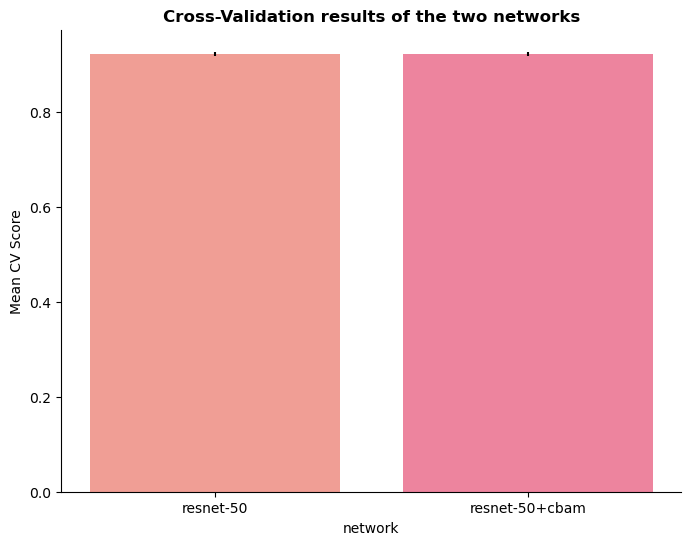

In [37]:
plt.figure(figsize=(8, 6))
ax = sns.barplot(data=exp_res, x="network", y="mean_cv_score", palette=[MY_COLORS[0], MY_COLORS[-1]])
ax.set_title("Cross-Validation results of the two networks", fontsize=12, weight="bold")
ax.set_ylabel("Mean CV Score")
x_coords = [p.get_x() + 0.5 * p.get_width() for p in ax.patches]
y_coords = [p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, yerr=exp_res["std_err_score"], fmt="none", c="k")
sns.despine()
plt.show()

# Test Model

In [28]:
def train_test_model(train_data:pd.DataFrame, test_data:pd.DataFrame,  model_class:pl.LightningModule, model_type:str, 
                     n_epochs:Optional[int]=500, 
                     resize:Optional[Tuple]=(256, 256), augmentations:Optional[Dict]=None, batch_sz:Optional[Dict]=None, 
                     apply_attn:Optional[bool]=True) -> Dict:
    """
    This function tests the model and evaluates it on the test set.
    
    :param train_data: the training dataset.
    :param test_data: the test dataset.
    :param model_class: the model.
    :param model_type: the type of the model. e.g. "resnet"
    :param n_epochs: number of epochs to train the model.
    :param resize: the value to which resize the model.
    :param augmentations: the augmentations to be applied to the data.
    :param apply_attn: whether to apply attention or not.
    
    :returns: the test scores of the model
    """
    
    scores = dict()
    train_aug = train_augmentations if augmentations is None or 'train' not in augmentations else augmentations['train']
    test_aug = val_test_augmentations if augmentations is None or 'test' not in augmentations else augmentations['test']
    
    train_batch_sz = 64 if batch_sz is None or 'train' not in batch_sz else batch_sz['train']
    test_batch_sz = 256 if batch_sz is None or 'test' not in batch_sz else batch_sz['test']
         
    
    train_dm = FlowerDataLoader(train_data['img_path'].tolist(), 
                                train_data['label_num'].tolist(), resize=resize, augmentations=train_aug, 
                                batch_sz=train_batch_sz, shuffle=True)
    
    test_dm = FlowerDataLoader(test_data['img_path'].tolist(), 
                              test_data['label_num'].tolist(), resize=resize, augmentations=test_aug,
                              batch_sz=test_batch_sz, shuffle=False)
    
    
    train_dm.setup(stage="train")
    test_dm.setup(stage="test")
    
    train_dl = train_dm.train_dataloader()
    test_dl = test_dm.test_dataloader()
    
    
    model = model_class(model_type, N_CLASSES+1, apply_attn=apply_attn)

    trainer = pl.Trainer(devices=1, 
                         accelerator="gpu", 
                         max_epochs=n_epochs, 
                         gradient_clip_val=2, 
                         precision=16)
    
    trainer.fit(model, train_dataloaders=train_dl)
    score = trainer.test(model, dataloaders=test_dl)
    scores['accuracy'] = score[0]['test_acc_score']
    scores['f1-score'] = score[0]['test_f1_score']
    scores['precision'] = score[0]['test_prec_score']
    scores['recall'] = score[0]['test_recall_score']
    
    return scores

In [27]:
model_test_scores = train_test_model(meta_df_train, meta_df_test, ResNetCBAM, "resnet50", n_epochs=24, resize=(256, 256))
model_test_scores

Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.5 M
--------------------------------------
23.5 M    Trainable params
0         Non-trainable params
23.5 M    Total params
47.016    Total estimated model params size (MB)


Epoch 23: 100%|██| 222/222 [00:38<00:00,  5.78it/s, loss=0.384, v_num=136, train_loss=0.393, train_f1_score=0.871]

`Trainer.fit` stopped: `max_epochs=24` reached.


Epoch 23: 100%|██| 222/222 [00:38<00:00,  5.75it/s, loss=0.384, v_num=136, train_loss=0.393, train_f1_score=0.871]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|█████████████████████████████████████████████████████████| 7/7 [00:01<00:00,  5.90it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_acc_score       │    0.9282083862770013     │
│       test_f1_score       │    0.9288811355953326     │
│         test_loss         │    0.27468279004096985    │
│      test_prec_score      │    0.9331495485687196     │
│     test_recall_score     │    0.9282083862770013     │
└───────────────────────────┴───────────────────────────┘

{'accuracy': 0.9282083862770013,
 'f1-score': 0.9288811355953326,
 'precision': 0.9331495485687196,
 'recall': 0.9282083862770013}

In [148]:
def retrain(data:pd.DataFrame, model_class:pl.LightningModule, model_type:str, resize:Optional[Tuple]=None, 
            augmentation:Optional[albumentations.Compose]=None, n_epochs:Optional[int]=500, batch_sz:Optional[int]=64, 
            apply_attn:Optional[bool]=True, onnx_path:Optional[str]=None):
    
    """
    This function is used to retrain the model on the complete dataset.
    
    :param data: the complete dataframe
    :param model_class: the model
    :param model_type: the type of the model. e.g. "resnet50"
    :param resize: the amount to resize the image to, e.g. (256, 256)
    :param augmentations: the augmentations that can be applied to the data.
    :param n_epochs: the number of epochs to train.
    :param batch_sz: the batch size for training.
    :param apply_attn: whether to apply the attention module.
    :param onnx_path: the path to where save the model onnx file
    
    :returns: None.
    """
    
    onnx_path = "./model.onnx" if onnx_path is None else onnx_path
    
    train_dm = FlowerDataLoader(data["img_path"].tolist(), data["label_num"].tolist(), 
                                resize=resize, augmentations=augmentation, batch_sz=batch_sz, shuffle=True)
    
    train_dm.setup(stage="train")
    train_dl = train_dm.train_dataloader()
    
    model = model_class(model_type, N_CLASSES+1, apply_attn=apply_attn)
    input_sample = torch.randn(1, 3, 224, 224, requires_grad=True)
    # output_sample = model(input_sample)
    
    trainer = pl.Trainer(devices=1, 
                         accelerator="gpu", 
                         max_epochs=n_epochs, 
                         gradient_clip_val=2, 
                         precision=16)
    
    trainer.fit(model, train_dataloaders=train_dl)
    print(clr.S+"Saving trained model as onnx to: "+clr.E+str(onnx_path))
    
    model.to_onnx(onnx_path, 
                  input_sample, 
                  export_params=True, 
                  do_constant_folding=True,
                  input_names=['input'], 
                  output_names=['output'], 
                  dynamic_axes={'input':{0:'batch_size'}, 'output':{0:'batch_size'}})
    
    print(clr.S+"DONE!"+clr.E)
    

In [78]:
if not os.path.exists("./onnx_models"):
    os.mkdir("onnx_models")

retrain(meta_df, ResNetCBAM, "resnet50", resize=(256, 256), 
        augmentation=train_augmentations, 
        n_epochs=24, 
        onnx_path="./onnx_models/resnet50_cbam.onnx")

Using 16bit native Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type   | Params
--------------------------------------
0 | base_model | ResNet | 23.7 M
--------------------------------------
23.7 M    Trainable params
0         Non-trainable params
23.7 M    Total params
47.342    Total estimated model params size (MB)


Epoch 23: 100%|██| 246/246 [00:44<00:00,  5.49it/s, loss=0.401, v_num=158, train_loss=0.386, train_f1_score=0.875]

`Trainer.fit` stopped: `max_epochs=24` reached.


Epoch 23: 100%|██| 246/246 [00:45<00:00,  5.42it/s, loss=0.401, v_num=158, train_loss=0.386, train_f1_score=0.875]
Saving trained model as onnx to: ./onnx_models/resnet50_cbam.onnx
DONE!


# Inferencing with ONNX

In [79]:
onnx_sess = onnxruntime.InferenceSession("onnx_models/resnet50_cbam.onnx", providers=['CPUExecutionProvider'])

In [144]:
def softmax(arr:np.ndarray):
    """
    This function applies the softmax on the data.
    
    :param arr: the array to which the softmax function needs to be applied.
    
    :returns: the softmax value.
    """
    return np.exp(arr) / np.sum(np.exp(arr))

def inference(sess:onnxruntime.InferenceSession, img_fp:str):
    """
    This function is used to infer from the model.
    
    :param sess: the onnxruntime of the model.
    :param img_fp: the image for which the inference needs to be generated.
    
    :returns: Top-5 predictions and their scores for the images.
    """
    INV_LABELS = {v:k for k, v in LABELS.items()}
    
    input_name = sess.get_inputs()[0].name
    
    img = Image.open(img_fp)
    img = img.convert('RGB')
    
    plt.axis('off')
    plt.imshow(img)
    
    img = img.resize((256, 256), resample=Image.Resampling.BILINEAR)
    augmentation = albumentations.Compose([
        albumentations.CenterCrop(224, 224, always_apply=True),
        albumentations.Normalize(always_apply=True)
    ])
    img = np.array(img)
    aug = augmentation(image=img)
    img = aug['image']
    img = np.transpose(img, (2, 0, 1)) # Converting to CHW
    img = np.expand_dims(img, axis=0) # Converting from (C, H, W) -> (batch_sz, C, H, W)
    
    onnx_input = {input_name: img}
    logits = sess.run(None, onnx_input)[0].flatten()
    
    # To get the top-5 maximum values in logits
    indices = np.argpartition(logits, -5)[-5:] 
    indices = indices[np.argsort(logits[indices])[::-1]]
    
    preds = [INV_LABELS[idx] for idx in indices[np.argsort(logits[indices])[::-1]]]
    
    return preds, softmax(logits[indices])

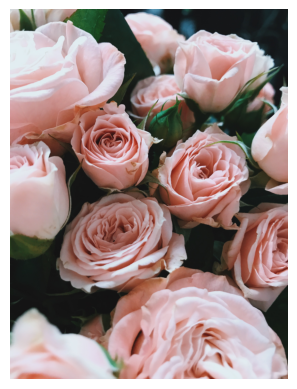

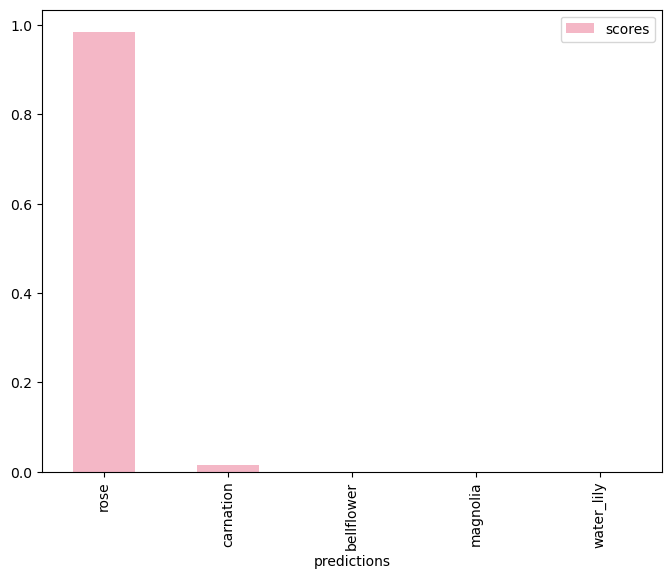

In [137]:
predictions, prediction_scores = inference(onnx_sess, "./test_img.jpg")
ax = pd.DataFrame({'predictions':predictions, 'scores':prediction_scores.tolist()})\
.set_index('predictions')\
.plot(kind="bar", figsize=(8, 6), color=MY_COLORS[-3])

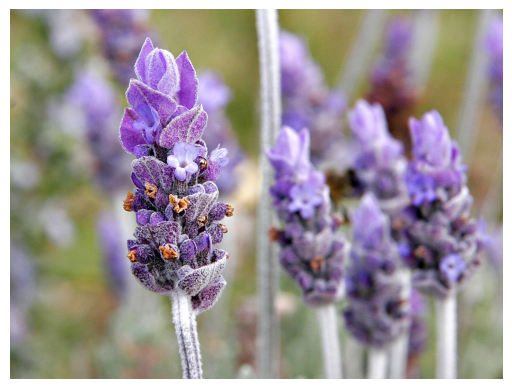

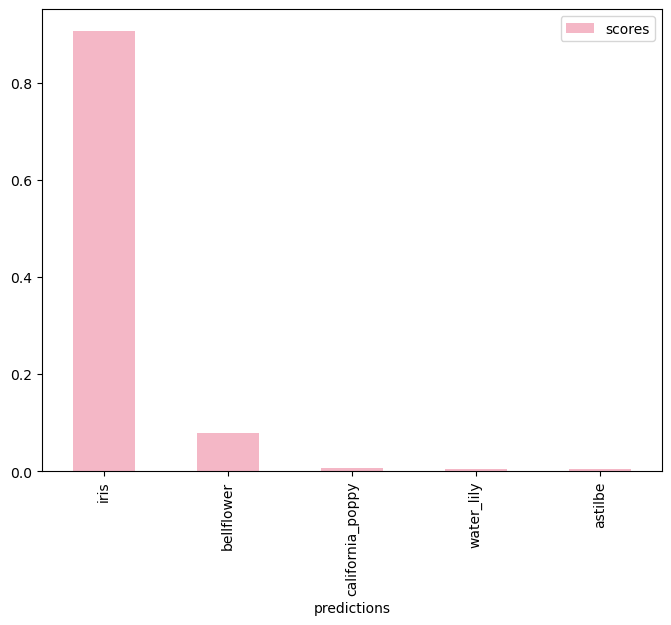

In [150]:
predictions, prediction_scores = inference(onnx_sess, "./test_img_3.jpg")
ax = pd.DataFrame({'predictions':predictions, 'scores':prediction_scores.tolist()})\
.set_index('predictions')\
.plot(kind="bar", figsize=(8, 6), color=MY_COLORS[-3])

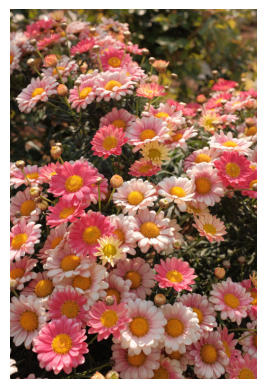

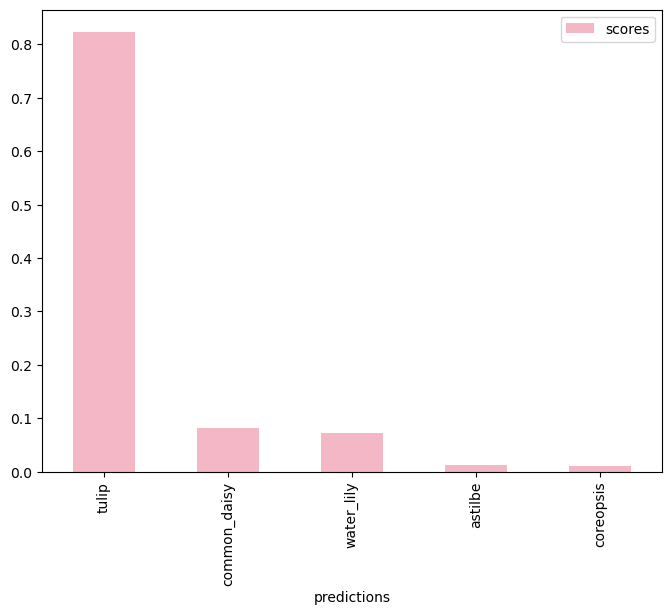

In [146]:
predictions, prediction_scores = inference(onnx_sess, "./test_img_4.jpg")
ax = pd.DataFrame({'predictions':predictions, 'scores':prediction_scores.tolist()})\
.set_index('predictions')\
.plot(kind="bar", figsize=(8, 6), color=MY_COLORS[-3])

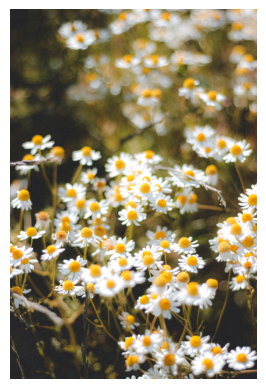

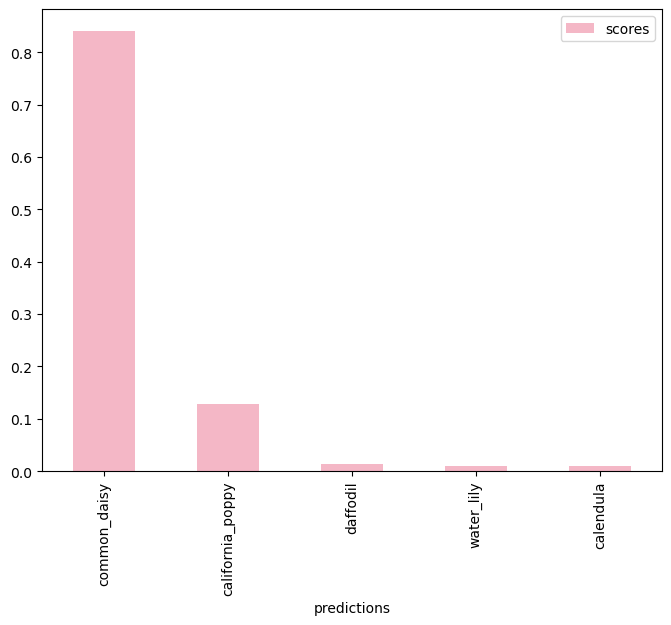

In [149]:
predictions, prediction_scores = inference(onnx_sess, "./test_img_5.jpg")
ax = pd.DataFrame({'predictions':predictions, 'scores':prediction_scores.tolist()})\
.set_index('predictions')\
.plot(kind="bar", figsize=(8, 6), color=MY_COLORS[-3])